In [1]:
!pip install shap

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 538.2/538.2 kB 4.2 MB/s eta 0:00:00


In [15]:
import pandas as pd
from google.colab import drive
from keras.models import Sequential
from keras.layers import Conv1D, Dense, Flatten, Reshape, Dropout, BatchNormalization, MaxPooling1D
from sklearn.model_selection import LeaveOneOut
from sklearn.metrics import mean_squared_error, r2_score
import numpy as np
from sklearn.preprocessing import MinMaxScaler
import matplotlib.pyplot as plt
import shap
from keras.optimizers import Adam
from keras.callbacks import EarlyStopping, ModelCheckpoint

In [3]:
drive.mount('/content/drive')

df = pd.read_excel('/content/drive/MyDrive/TCC/RMS INDEPENDENTES.xlsx', sheet_name='JEITO 7 com variações eng de fe')

Mounted at /content/drive


# Processamento dos Dados

In [4]:
#df_tratado = df.iloc[:, 0:8]
df_tratado = df.iloc[:, 1:12]
df_rms = df.iloc[:, 0]

In [5]:
df_tratado.drop('Diferença RMS anterior', axis=1, inplace=True)
df_tratado.drop('Diferença RMS proximo', axis=1, inplace=True)
df_tratado.drop('Diferença IRI anterior', axis=1, inplace=True)
df_tratado.drop('Diferença IRI proximo', axis=1, inplace=True)

In [6]:
print(df_tratado)
print(df_rms)

            IRI   V       k       c       ms    mus     kus
0      1.722854  30   14000  1876.0  186.750   41.5  200000
1      1.530687  30   14000  1876.0  186.750   41.5  200000
2      1.559335  30   14000  1876.0  186.750   41.5  200000
3      1.575025  30   14000  1876.0  186.750   41.5  200000
4      1.690348  30   14000  1876.0  186.750   41.5  200000
...         ...  ..     ...     ...      ...    ...     ...
48649  1.000000  30  107900  4616.3  592.475  130.0  299000
48650  1.000000  30  169000  6745.7  464.825  104.0  299000
48651  1.000000  30  169650  4616.3  331.500   78.0  299000
48652  1.000000  30   52000  6745.7  500.750   91.0  299000
48653  1.000000  30   40300  2993.3  357.500  130.0  260000

[48654 rows x 7 columns]
0        0.374902
1        0.312542
2        0.299262
3        0.326102
4        0.425370
           ...   
48649    1.000000
48650    1.000000
48651    1.000000
48652    1.000000
48653    1.000000
Name: RMS, Length: 48654, dtype: float64


In [7]:
scaler = MinMaxScaler()
df_norm = scaler.fit_transform(df_tratado)

In [8]:
nome_coluna = df_rms.name

# Aplicando a transformação no array numpy
array_rms = df_rms.values.reshape(-1, 1)
array_rms_scaled = scaler.fit_transform(array_rms)

# Criando um novo DataFrame pandas mantendo o nome da coluna original
df_rms = pd.DataFrame(array_rms_scaled, columns=[nome_coluna])

In [9]:
ultimas_linhas = df_norm[-54:]

df_ultimas = pd.DataFrame(ultimas_linhas)

df_ultimas.to_excel('ultimas_54_linhas.xlsx', index=False)

df_norm = df_norm[:-54]

df_rms = df_rms.iloc[:-54]

In [ ]:
print(df_norm)
print(df_rms)

[[0.17507015 0.         0.02221047 ... 0.12133189 0.12332838 0.37735849]
 [0.14772091 0.         0.02221047 ... 0.12133189 0.12332838 0.37735849]
 [0.1517981  0.         0.02221047 ... 0.12133189 0.12332838 0.37735849]
 ...
 [0.21042462 1.         0.11210999 ... 0.31245263 0.70282318 0.37735849]
 [0.4029404  1.         0.11210999 ... 0.31245263 0.70282318 0.37735849]
 [0.16712854 1.         0.11210999 ... 0.31245263 0.70282318 0.37735849]]
            RMS
0      0.045682
1      0.036110
2      0.034071
3      0.038191
4      0.053429
...         ...
48595  0.217583
48596  0.216008
48597  0.313292
48598  0.257720
48599  0.221763

[48600 rows x 1 columns]


In [10]:
#df_norm = pd.DataFrame(df_norm, columns=df.columns[1:12])

df_norm = pd.DataFrame(df_norm, columns=df.columns[5:12])

df_norm['VEICULO'] = df.reset_index(drop=True)['VEICULO']

#nome_coluna = df_rms.name

df_norm.insert(0, nome_coluna, df_rms)

In [11]:
# Seu código original para selecionar as colunas de interesse e ajustar o df_selecionado
colunas_interesse = ['Diferença RMS anterior', 'Diferença RMS proximo', 'Diferença IRI anterior', 'Diferença IRI proximo']
df_selecionado = df[colunas_interesse]
df_selecionado = df_selecionado.iloc[:-54]

# Divisão de df_norm em duas partes: antes e depois da coluna RMS (assumindo que RMS está no índice 0)
indice_rms = 0  # Índice da coluna RMS
df_norm_antes = df_norm.iloc[:, :indice_rms+1]  # Seleciona tudo até a coluna RMS inclusa
df_norm_depois = df_norm.iloc[:, indice_rms+1:]  # Seleciona tudo após a coluna RMS

# Concatenação de df_norm_antes com df_selecionado
df_concatenado = pd.concat([df_norm_antes, df_selecionado], axis=1)

# Concatenação final para obter o df_norm atualizado
df_norm = pd.concat([df_concatenado, df_norm_depois], axis=1)

In [ ]:
print(df_norm)

            RMS  Diferença RMS anterior  Diferença RMS proximo  \
0      0.045682                0.000000               0.062361   
1      0.036110               -0.062361               0.013280   
2      0.034071               -0.013280              -0.026840   
3      0.038191                0.026840              -0.099267   
4      0.053429                0.099267               0.095108   
...         ...                     ...                    ...   
48595  0.217583                0.318070               0.010259   
48596  0.216008               -0.010259              -0.633769   
48597  0.313292                0.633769               0.362031   
48598  0.257720               -0.362031               0.234247   
48599  0.221763               -0.234247               0.522003   

       Diferença IRI anterior  Diferença IRI proximo       IRI    V        k  \
0                    0.000000               0.192167  0.175070  0.0  0.02221   
1                   -0.192167              -0.0

In [12]:
grupos = df_norm.groupby('VEICULO')

df_A_HB = grupos.get_group('A-HB').iloc[:, 0:12] if 'A-HB' in grupos.groups else pd.DataFrame(columns=df.columns[0:12])
df_B_HB = grupos.get_group('B-HB').iloc[:, 0:12] if 'B-HB' in grupos.groups else pd.DataFrame(columns=df.columns[0:12])
df_C_HB = grupos.get_group('C-HB').iloc[:, 0:12] if 'C-HB' in grupos.groups else pd.DataFrame(columns=df.columns[0:12])
df_D_SDN = grupos.get_group('D-SDN').iloc[:, 0:12] if 'D-SDN' in grupos.groups else pd.DataFrame(columns=df.columns[0:12])
df_F_SDN = grupos.get_group('F-SDN').iloc[:, 0:12] if 'F-SDN' in grupos.groups else pd.DataFrame(columns=df.columns[0:12])
df_D_SUV = grupos.get_group('D-SUV').iloc[:, 0:12] if 'D-SUV' in grupos.groups else pd.DataFrame(columns=df.columns[0:12])
df_B_SPORTS = grupos.get_group('B-SPORTS').iloc[:, 0:12] if 'B-SPORTS' in grupos.groups else pd.DataFrame(columns=df.columns[0:12])
df_STOCKCAR = grupos.get_group('STOCKCAR').iloc[:, 0:12] if 'STOCKCAR' in grupos.groups else pd.DataFrame(columns=df.columns[0:12])
df_EUROPEAN_VAN = grupos.get_group('EUROPEAN VAN').iloc[:, 0:12] if 'EUROPEAN VAN' in grupos.groups else pd.DataFrame(columns=df.columns[0:12])

In [ ]:
print(df_B_HB)

            RMS  Diferença RMS anterior  Diferença RMS proximo  \
540    0.042827               -0.042813               0.055259   
541    0.034344               -0.055259               0.002534   
542    0.033955               -0.002534              -0.007343   
543    0.035082                0.007343              -0.086530   
544    0.048365                0.086530               0.077805   
...         ...                     ...                    ...   
44815  0.247789                0.389401               0.004996   
44816  0.247022               -0.004996              -0.617228   
44817  0.341767                0.617228               0.347225   
44818  0.288468               -0.347225               0.368032   
44819  0.231975               -0.368032               0.976896   

       Diferença IRI anterior  Diferença IRI proximo       IRI    V         k  \
540                  0.055801               0.192167  0.175070  0.0  0.096245   
541                 -0.192167              -0

In [13]:
X = df_norm.iloc[:, 1:12]
#y = df_norm.iloc[:, 0]
#y = df.iloc[:-54, 0]
y = df_rms

In [ ]:
print(df_norm)

            RMS  Diferença RMS anterior  Diferença RMS proximo  \
0      0.045682                0.000000               0.062361   
1      0.036110               -0.062361               0.013280   
2      0.034071               -0.013280              -0.026840   
3      0.038191                0.026840              -0.099267   
4      0.053429                0.099267               0.095108   
...         ...                     ...                    ...   
48595  0.217583                0.318070               0.010259   
48596  0.216008               -0.010259              -0.633769   
48597  0.313292                0.633769               0.362031   
48598  0.257720               -0.362031               0.234247   
48599  0.221763               -0.234247               0.522003   

       Diferença IRI anterior  Diferença IRI proximo       IRI    V        k  \
0                    0.000000               0.192167  0.175070  0.0  0.02221   
1                   -0.192167              -0.0

In [14]:
print(X)
print(y)

       Diferença RMS anterior  Diferença RMS proximo  Diferença IRI anterior  \
0                    0.000000               0.062361                0.000000   
1                   -0.062361               0.013280               -0.192167   
2                   -0.013280              -0.026840                0.028648   
3                    0.026840              -0.099267                0.015690   
4                    0.099267               0.095108                0.115323   
...                       ...                    ...                     ...   
48595                0.318070               0.010259                0.646897   
48596               -0.010259              -0.633769               -0.062674   
48597                0.633769               0.362031               -0.742677   
48598               -0.362031               0.234247                1.352695   
48599               -0.234247               0.522003               -1.656911   

       Diferença IRI proximo       IRI 

#Modelo Conv1D com normalização

In [27]:
optimizer = Adam(lr=0.0001)

modelo = Sequential([
    Conv1D(filters=8, kernel_size=8, input_shape=(X.shape[1], 1), activation='relu', padding='same'),
    #Conv1D(filters=4, kernel_size=4, activation='relu', padding='same'),
    Flatten(),
    Dense(512, activation='relu'),
    Dense(256, activation='relu'),
    Dense(64, activation='relu'),
    Dense(units=1, activation='relu')
])

modelo.compile(optimizer=optimizer, loss='mean_squared_error')

modelo.fit(X, y, epochs=100, batch_size=32, verbose=1)

y_pred = modelo.predict(X)

mse = mean_squared_error(y, y_pred)
r2 = r2_score(y, y_pred)

print(f'Mean Squared Error (MSE): {mse:.3f}')
print(f'R^2 Score: {r2:.3f}')

Epoch 1/100
1519/1519 [==============================] - 14s 8ms/step - loss: 0.0010
Epoch 2/100
1519/1519 [==============================] - 12s 8ms/step - loss: 6.7124e-04
Epoch 3/100
1519/1519 [==============================] - 12s 8ms/step - loss: 6.0132e-04
Epoch 4/100
1519/1519 [==============================] - 12s 8ms/step - loss: 5.4257e-04
Epoch 5/100
1519/1519 [==============================] - 11s 7ms/step - loss: 4.9097e-04
Epoch 6/100
1519/1519 [==============================] - 11s 7ms/step - loss: 4.5095e-04
Epoch 7/100
1519/1519 [==============================] - 12s 8ms/step - loss: 4.0392e-04
Epoch 8/100
1519/1519 [==============================] - 12s 8ms/step - loss: 3.6654e-04
Epoch 9/100
1519/1519 [==============================] - 14s 9ms/step - loss: 3.5479e-04
Epoch 10/100
1519/1519 [==============================] - 12s 8ms/step - loss: 3.2672e-04
Epoch 11/100
1519/1519 [==============================] - 11s 7ms/step - loss: 3.1099e-04
Epoch 12/100
1519/1519 

In [ ]:
optimizer = Adam(lr=0.0001)

modelo = Sequential([
    Conv1D(filters=8, kernel_size=8, input_shape=(X.shape[1], 1), activation='relu', padding='same'),
    Flatten(),
    Dense(512, activation='relu'),
    Dense(256, activation='relu'),
    Dense(units=1, activation='relu')
])

callbacks = [
    EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True),
    ModelCheckpoint('melhor_modelo_l2.h5', monitor='val_loss', save_best_only=True, mode='min', verbose=1)
]

modelo.compile(optimizer=optimizer, loss='mean_squared_error')

modelo.fit(X, y, epochs=100, batch_size=32, verbose=1, validation_split=0.2, callbacks=callbacks)

y_pred = modelo.predict(X)

mse = mean_squared_error(y, y_pred)
r2 = r2_score(y, y_pred)

print(f'Mean Squared Error (MSE): {mse:.3f}')
print(f'R^2 Score: {r2:.3f}')

# Gráfico Geral

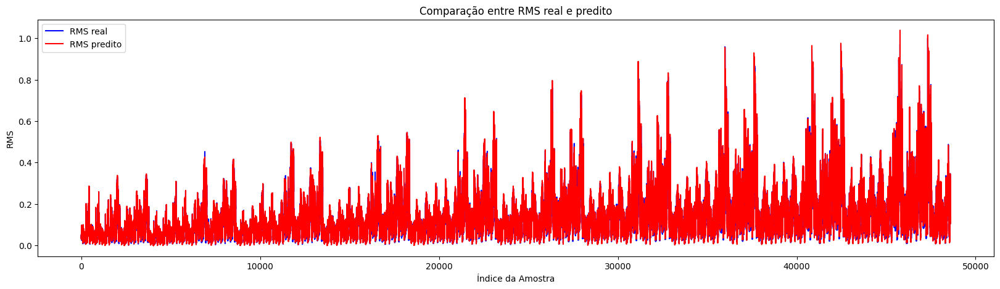

In [30]:
plt.figure(figsize=(20, 5))

plt.plot(range(len(y)), y, label='RMS real', color='blue')
plt.plot(range(len(y_pred)), y_pred, label='RMS predito', color='red')
plt.legend()
plt.xlabel('Índice da Amostra')
plt.ylabel('RMS')
plt.title('Comparação entre RMS real e predito')
plt.show()

#A-HB

In [31]:
print(df_A_HB)

            RMS  Diferença RMS anterior  Diferença RMS proximo  \
0      0.045682                0.000000               0.062361   
1      0.036110               -0.062361               0.013280   
2      0.034071               -0.013280              -0.026840   
3      0.038191                0.026840              -0.099267   
4      0.053429                0.099267               0.095108   
...         ...                     ...                    ...   
44275  0.221035                0.282240              -0.059381   
44276  0.230151                0.059381              -0.534641   
44277  0.312218                0.534641               0.272724   
44278  0.270355               -0.272724               0.450963   
44279  0.201132               -0.450963               0.690964   

       Diferença IRI anterior  Diferença IRI proximo       IRI    V        k  \
0                    0.000000               0.192167  0.175070  0.0  0.02221   
1                   -0.192167              -0.0

In [33]:
y_A_HB = df_A_HB.iloc[:, 0]

X_A_HB = df_A_HB.iloc[:, 1:12]

y_pred_A_HB = modelo.predict(X_A_HB)

169/169 [==============================] - 1s 8ms/step


In [34]:
print(X_A_HB)

       Diferença RMS anterior  Diferença RMS proximo  Diferença IRI anterior  \
0                    0.000000               0.062361                0.000000   
1                   -0.062361               0.013280               -0.192167   
2                   -0.013280              -0.026840                0.028648   
3                    0.026840              -0.099267                0.015690   
4                    0.099267               0.095108                0.115323   
...                       ...                    ...                     ...   
44275                0.282240              -0.059381                0.646897   
44276                0.059381              -0.534641               -0.062674   
44277                0.534641               0.272724               -0.742677   
44278               -0.272724               0.450963                1.352695   
44279               -0.450963               0.690964               -1.656911   

       Diferença IRI proximo       IRI 

## Variações K

### -10%

In [35]:
X_A_HB_k_menos_10 = X_A_HB.copy()

X_A_HB_k_menos_10['k'] = 0.014806

In [36]:
print(X_A_HB_k_menos_10)

       Diferença RMS anterior  Diferença RMS proximo  Diferença IRI anterior  \
0                    0.000000               0.062361                0.000000   
1                   -0.062361               0.013280               -0.192167   
2                   -0.013280              -0.026840                0.028648   
3                    0.026840              -0.099267                0.015690   
4                    0.099267               0.095108                0.115323   
...                       ...                    ...                     ...   
44275                0.282240              -0.059381                0.646897   
44276                0.059381              -0.534641               -0.062674   
44277                0.534641               0.272724               -0.742677   
44278               -0.272724               0.450963                1.352695   
44279               -0.450963               0.690964               -1.656911   

       Diferença IRI proximo       IRI 

In [39]:
y_pred_A_HB_k_menos_10 = modelo.predict(X_A_HB_k_menos_10)

169/169 [==============================] - 0s 3ms/step


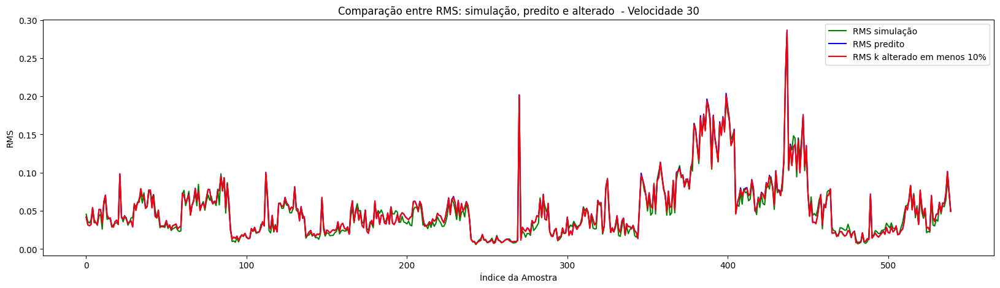

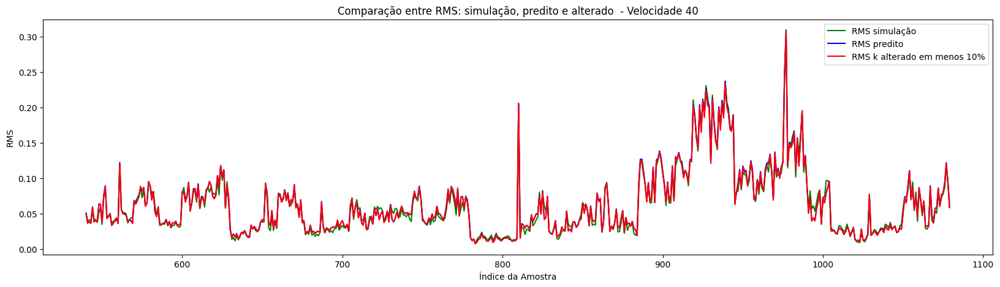

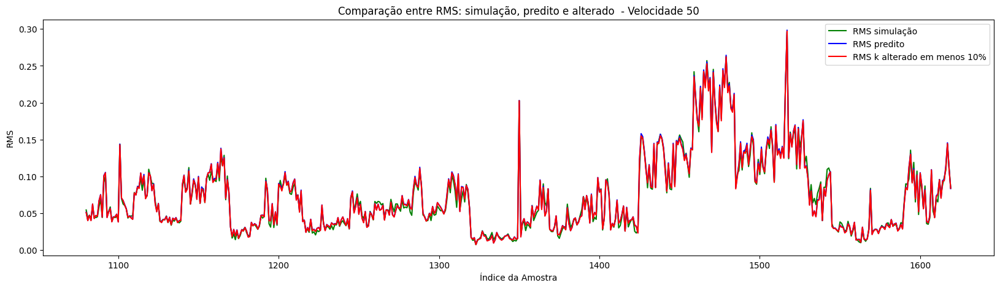

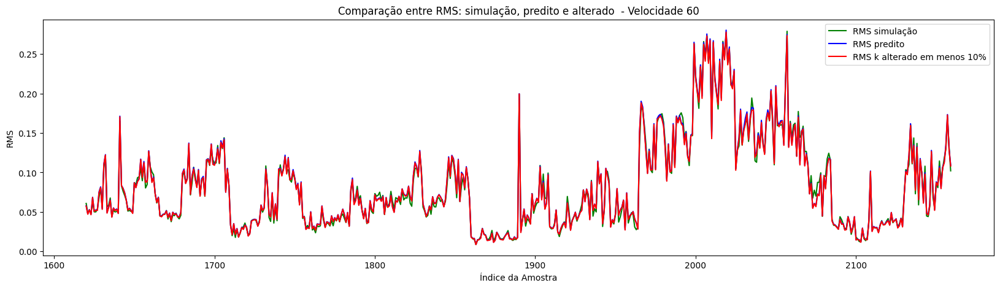

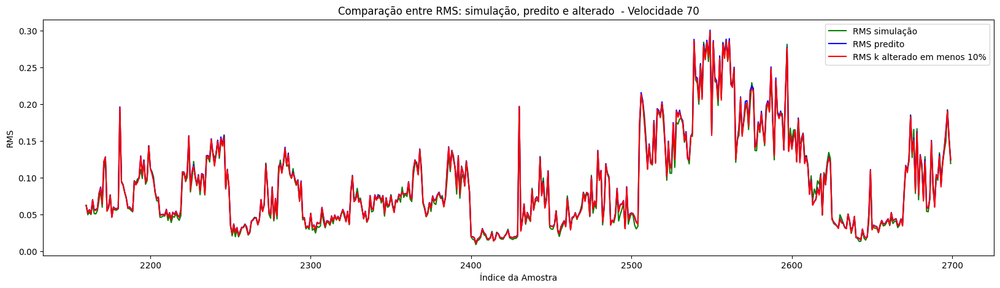

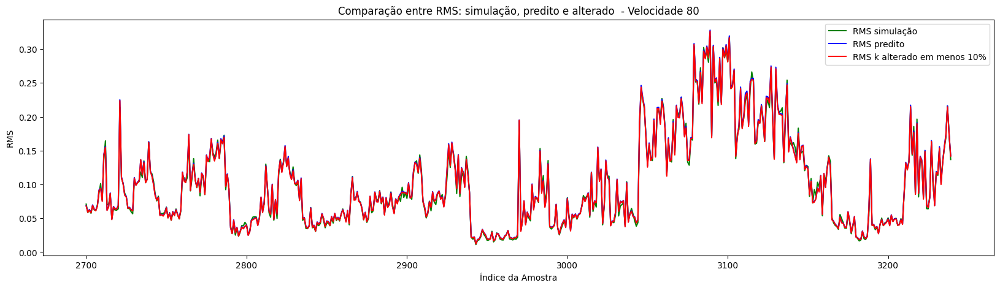

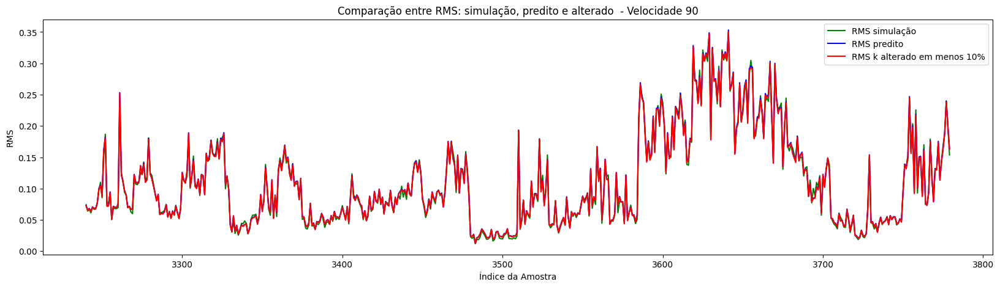

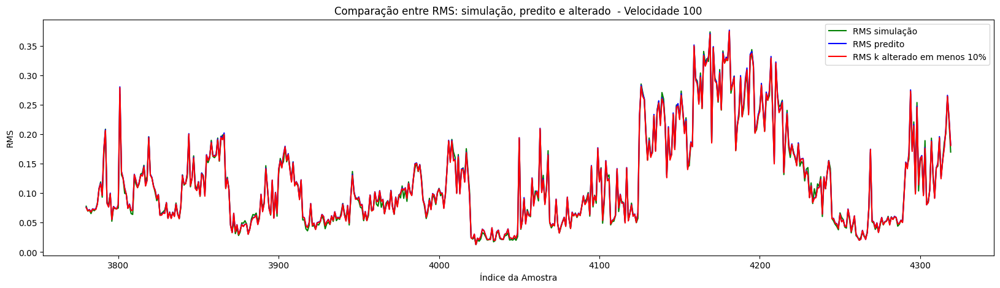

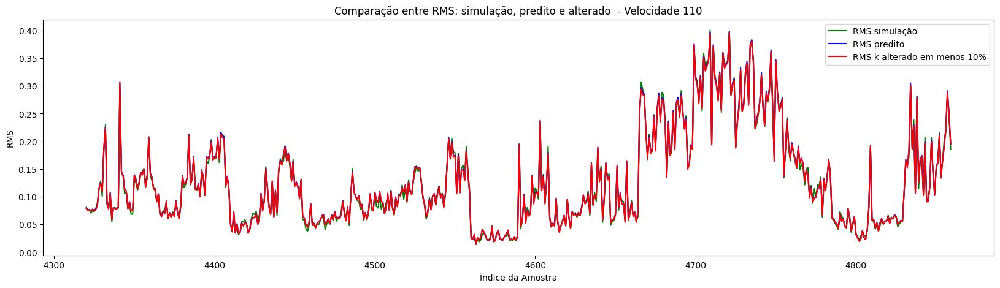

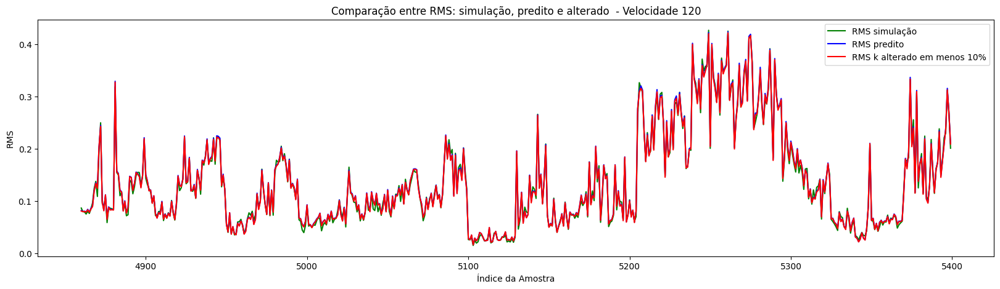

In [40]:
intervalo_total = 5400

num_subdivisoes = 10

tamanho_subdivisao = intervalo_total // num_subdivisoes

for i in range(num_subdivisoes):
    plt.figure(figsize=(20, 5))

    velocidade = 30 + i * 10

    inicio = i * tamanho_subdivisao
    fim = (i + 1) * tamanho_subdivisao

    plt.plot(range(inicio, fim), y_A_HB[inicio:fim], label='RMS simulação', color='green')
    plt.plot(range(inicio, fim), y_pred_A_HB[inicio:fim], label='RMS predito', color='blue')
    plt.plot(range(inicio, fim), y_pred_A_HB_k_menos_10[inicio:fim], label='RMS k alterado em menos 10%', color='red')
    plt.legend()
    plt.xlabel('Índice da Amostra')
    plt.ylabel('RMS')
    plt.title(f'Comparação entre RMS: simulação, predito e alterado  - Velocidade {velocidade}')
    plt.show()
    print('\n')


### -20%

In [ ]:
X_A_HB_k_menos_20 = X_A_HB.copy()

X_A_HB_k_menos_20['k'] = 0.007403

In [ ]:
print(X_A_HB_k_menos_20)

            IRI    V         k         c        ms       mus       kus
0      0.175070  0.0  0.007403  0.103632  0.121332  0.123328  0.377358
1      0.147721  0.0  0.007403  0.103632  0.121332  0.123328  0.377358
2      0.151798  0.0  0.007403  0.103632  0.121332  0.123328  0.377358
3      0.154031  0.0  0.007403  0.103632  0.121332  0.123328  0.377358
4      0.170444  0.0  0.007403  0.103632  0.121332  0.123328  0.377358
...         ...  ...       ...       ...       ...       ...       ...
44275  0.325042  1.0  0.007403  0.103632  0.121332  0.123328  0.377358
44276  0.316123  1.0  0.007403  0.103632  0.121332  0.123328  0.377358
44277  0.210425  1.0  0.007403  0.103632  0.121332  0.123328  0.377358
44278  0.402940  1.0  0.007403  0.103632  0.121332  0.123328  0.377358
44279  0.167129  1.0  0.007403  0.103632  0.121332  0.123328  0.377358

[5400 rows x 7 columns]


In [ ]:
y_pred_A_HB_k_menos_20 = modelo.predict(X_A_HB_k_menos_20)

169/169 [==============================] - 0s 1ms/step


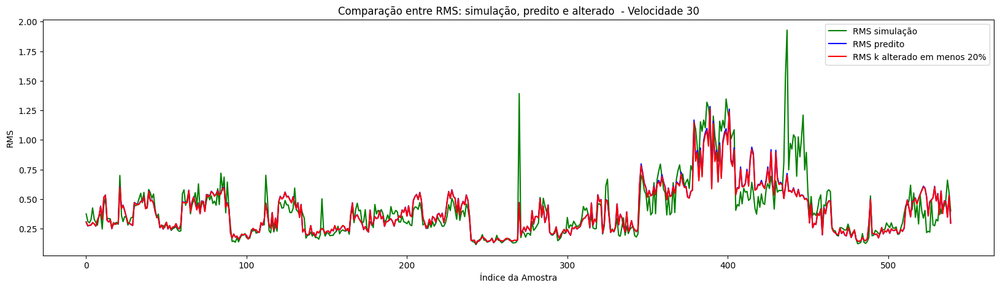

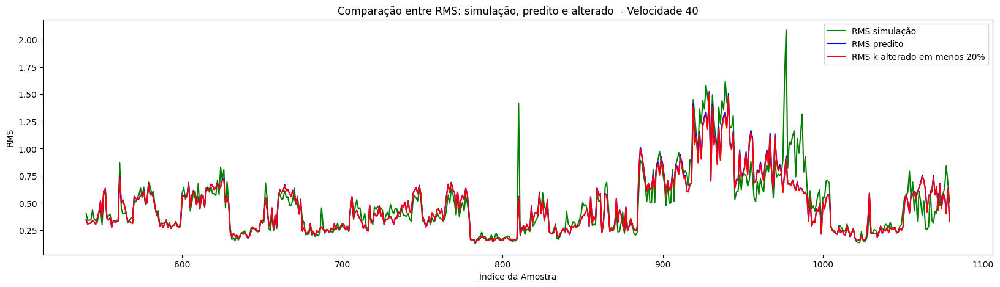

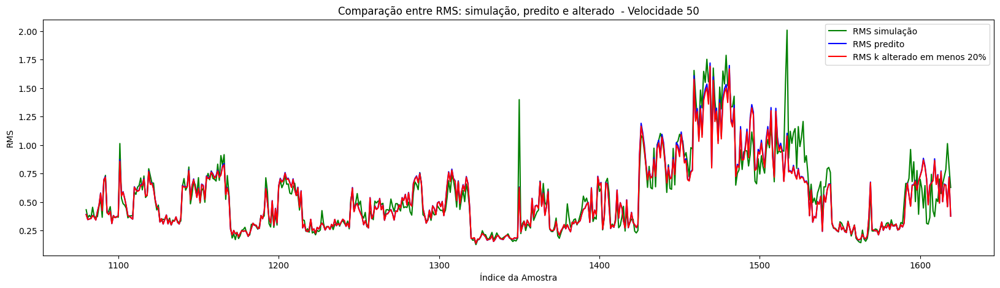

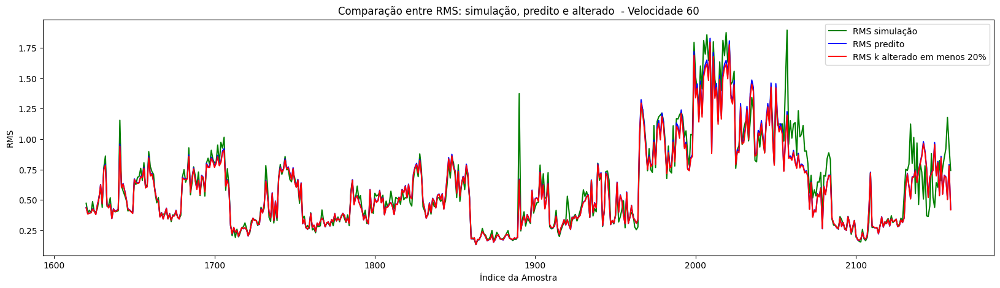

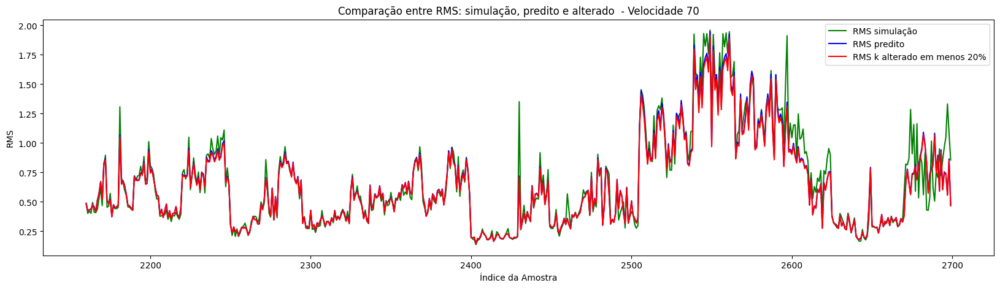

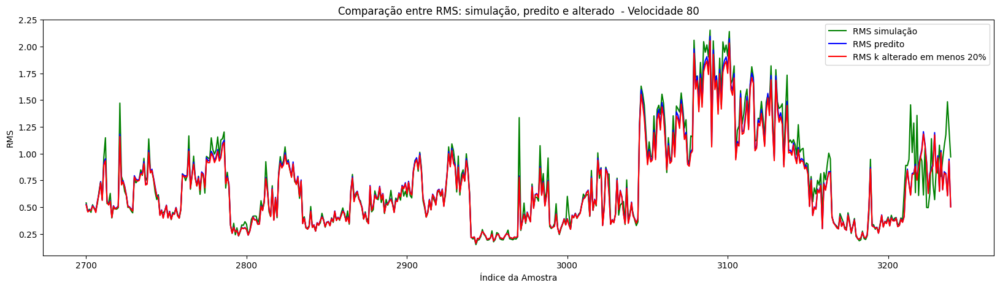

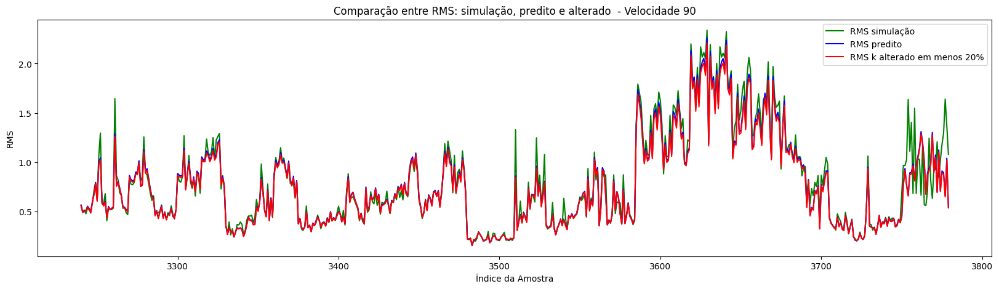

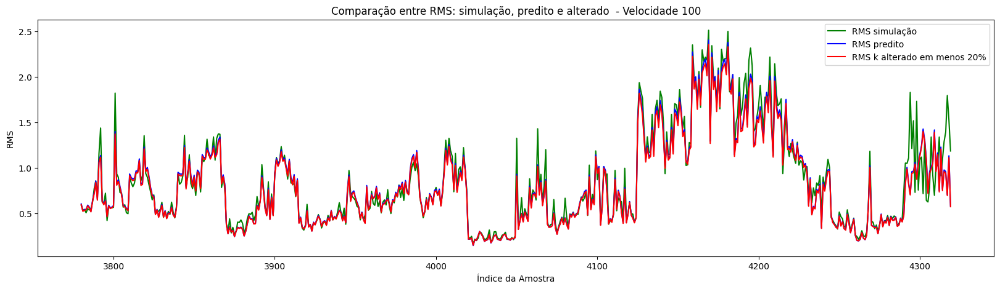

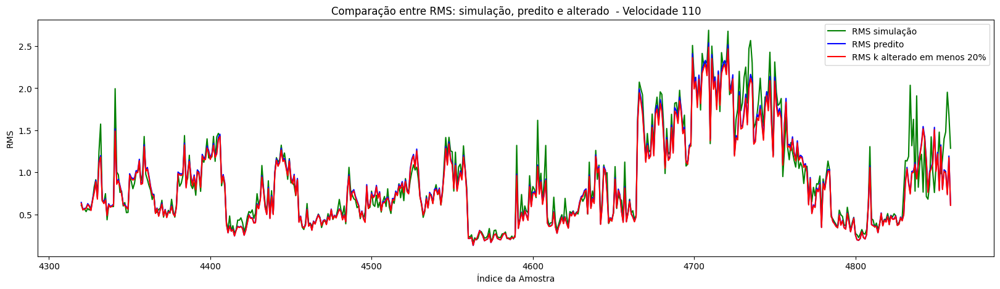

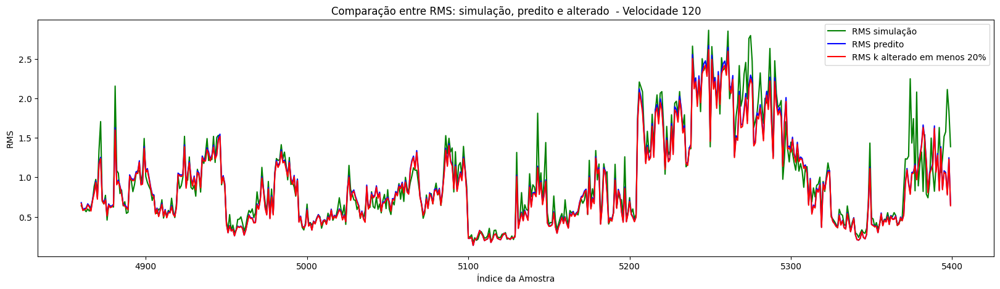

In [ ]:
intervalo_total = 5400

num_subdivisoes = 10

tamanho_subdivisao = intervalo_total // num_subdivisoes

for i in range(num_subdivisoes):
    plt.figure(figsize=(20, 5))

    velocidade = 30 + i * 10

    inicio = i * tamanho_subdivisao
    fim = (i + 1) * tamanho_subdivisao

    plt.plot(range(inicio, fim), y_A_HB[inicio:fim], label='RMS simulação', color='green')
    plt.plot(range(inicio, fim), y_pred_A_HB[inicio:fim], label='RMS predito', color='blue')
    plt.plot(range(inicio, fim), y_pred_A_HB_k_menos_20[inicio:fim], label='RMS k alterado em menos 20%', color='red')
    plt.legend()
    plt.xlabel('Índice da Amostra')
    plt.ylabel('RMS')
    plt.title(f'Comparação entre RMS: simulação, predito e alterado  - Velocidade {velocidade}')
    plt.show()
    print('\n')


### -30%

In [41]:
X_A_HB_k_menos_30 = X_A_HB.copy()

X_A_HB_k_menos_30['k'] = 0

In [42]:
print(X_A_HB_k_menos_30)

       Diferença RMS anterior  Diferença RMS proximo  Diferença IRI anterior  \
0                    0.000000               0.062361                0.000000   
1                   -0.062361               0.013280               -0.192167   
2                   -0.013280              -0.026840                0.028648   
3                    0.026840              -0.099267                0.015690   
4                    0.099267               0.095108                0.115323   
...                       ...                    ...                     ...   
44275                0.282240              -0.059381                0.646897   
44276                0.059381              -0.534641               -0.062674   
44277                0.534641               0.272724               -0.742677   
44278               -0.272724               0.450963                1.352695   
44279               -0.450963               0.690964               -1.656911   

       Diferença IRI proximo       IRI 

In [43]:
y_pred_A_HB_k_menos_30 = modelo.predict(X_A_HB_k_menos_30)

169/169 [==============================] - 0s 2ms/step


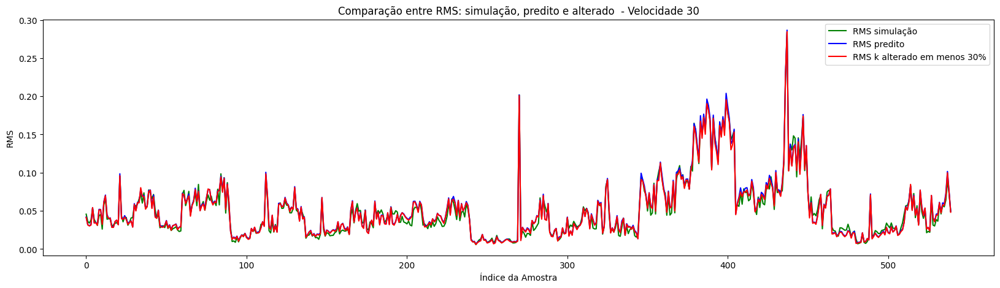

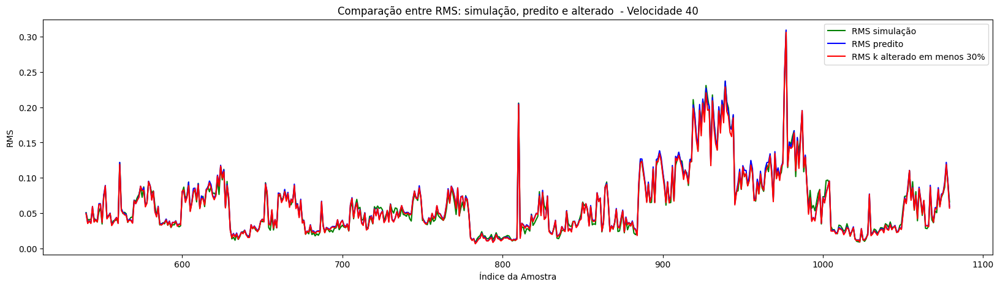

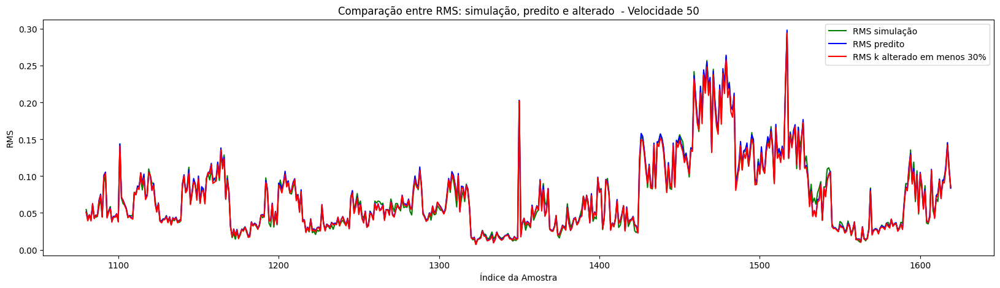

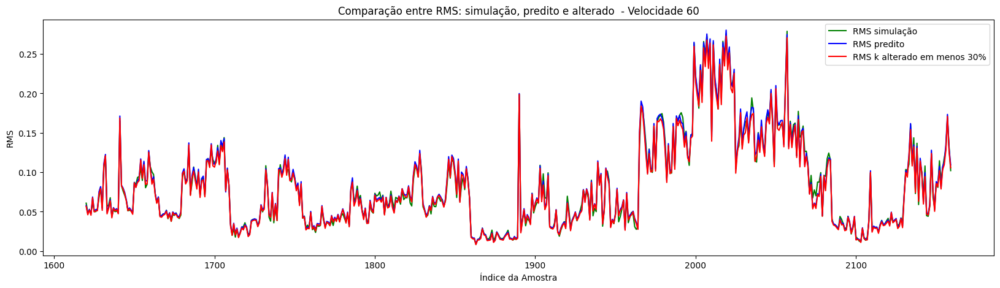

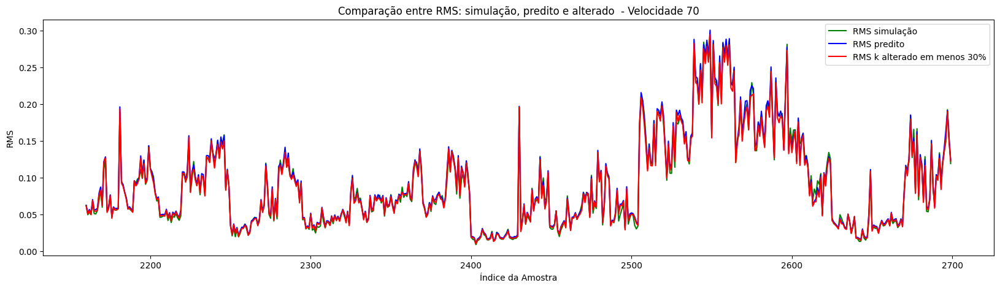

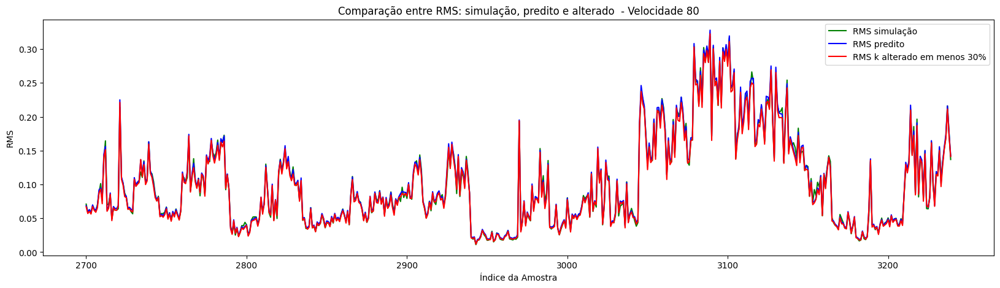

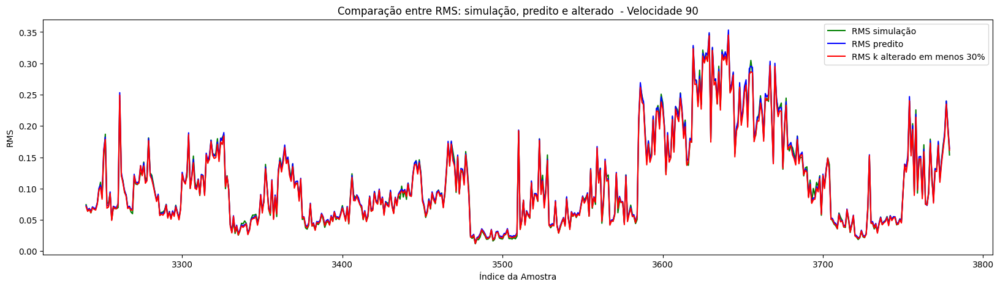

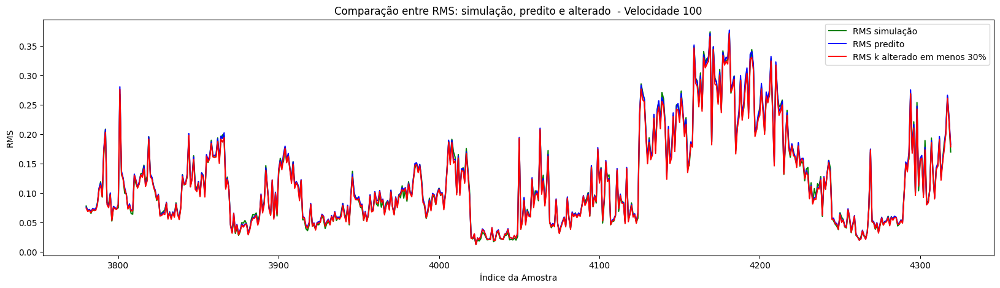

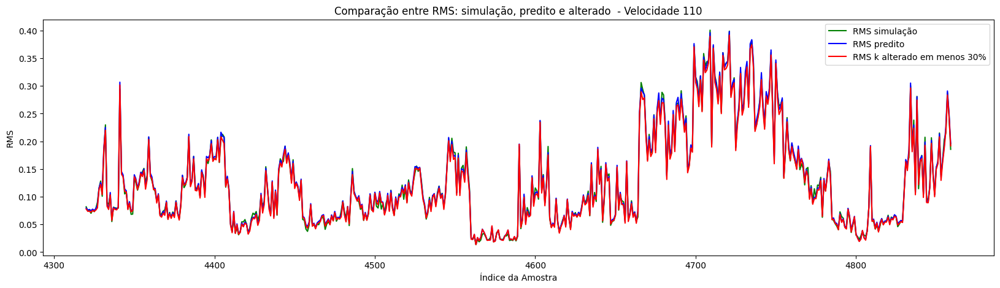

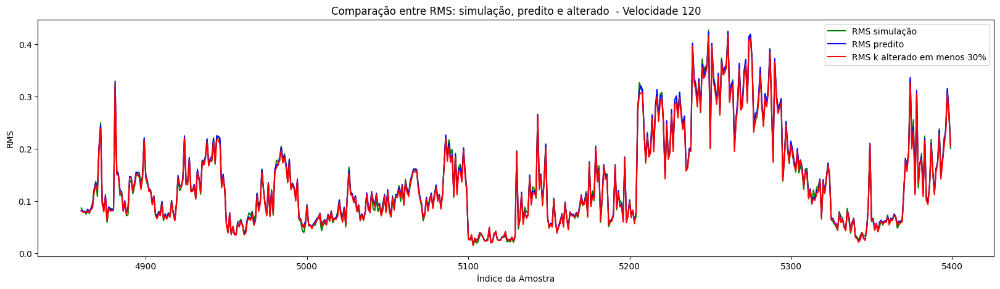

In [44]:
intervalo_total = 5400

num_subdivisoes = 10

tamanho_subdivisao = intervalo_total // num_subdivisoes

for i in range(num_subdivisoes):
    plt.figure(figsize=(20, 5))

    velocidade = 30 + i * 10

    inicio = i * tamanho_subdivisao
    fim = (i + 1) * tamanho_subdivisao

    plt.plot(range(inicio, fim), y_A_HB[inicio:fim], label='RMS simulação', color='green')
    plt.plot(range(inicio, fim), y_pred_A_HB[inicio:fim], label='RMS predito', color='blue')
    plt.plot(range(inicio, fim), y_pred_A_HB_k_menos_30[inicio:fim], label='RMS k alterado em menos 30%', color='red')
    plt.legend()
    plt.xlabel('Índice da Amostra')
    plt.ylabel('RMS')
    plt.title(f'Comparação entre RMS: simulação, predito e alterado  - Velocidade {velocidade}')
    plt.show()
    print('\n')


### +10%

In [ ]:
X_A_HB_k_mais_10 = X_A_HB.copy()

X_A_HB_k_mais_10['k'] = 0.029613

In [ ]:
print(X_A_HB_k_mais_10)

            IRI    V         k         c        ms       mus       kus
0      0.175070  0.0  0.029613  0.103632  0.121332  0.123328  0.377358
1      0.147721  0.0  0.029613  0.103632  0.121332  0.123328  0.377358
2      0.151798  0.0  0.029613  0.103632  0.121332  0.123328  0.377358
3      0.154031  0.0  0.029613  0.103632  0.121332  0.123328  0.377358
4      0.170444  0.0  0.029613  0.103632  0.121332  0.123328  0.377358
...         ...  ...       ...       ...       ...       ...       ...
44275  0.325042  1.0  0.029613  0.103632  0.121332  0.123328  0.377358
44276  0.316123  1.0  0.029613  0.103632  0.121332  0.123328  0.377358
44277  0.210425  1.0  0.029613  0.103632  0.121332  0.123328  0.377358
44278  0.402940  1.0  0.029613  0.103632  0.121332  0.123328  0.377358
44279  0.167129  1.0  0.029613  0.103632  0.121332  0.123328  0.377358

[5400 rows x 7 columns]


In [ ]:
y_pred_A_HB_k_mais_10 = modelo.predict(X_A_HB_k_mais_10)

169/169 [==============================] - 0s 2ms/step


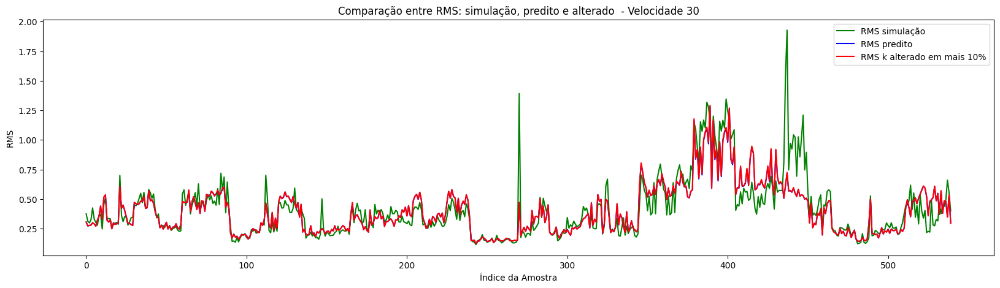

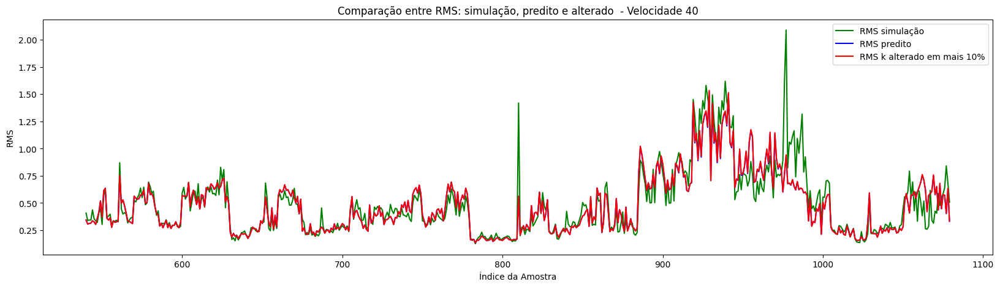

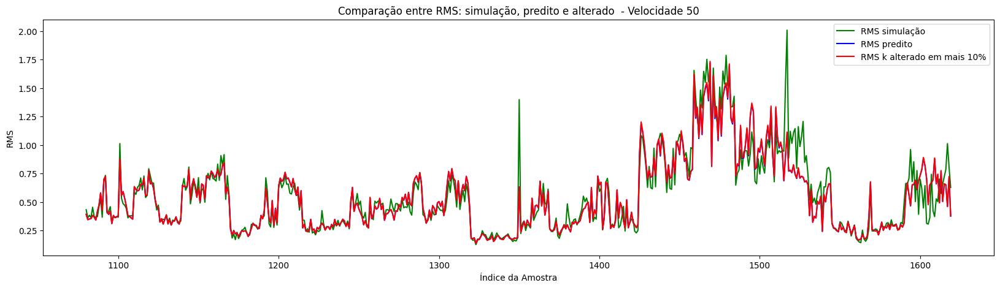

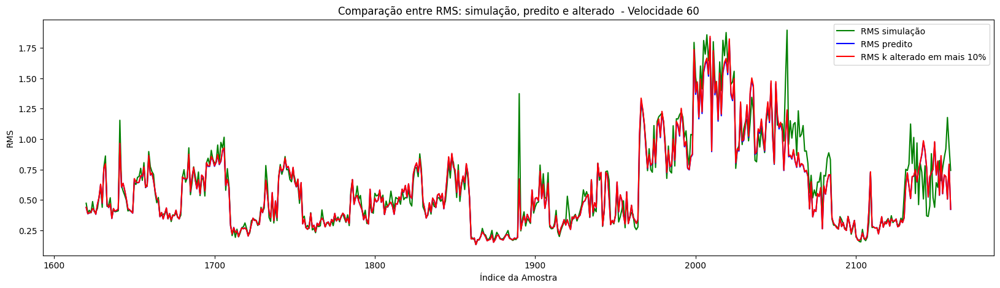

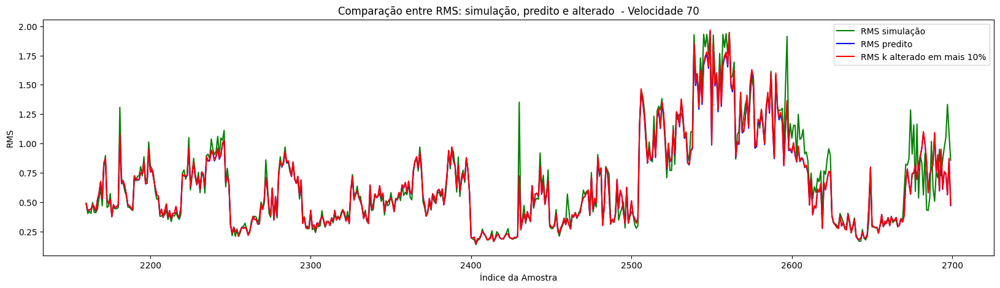

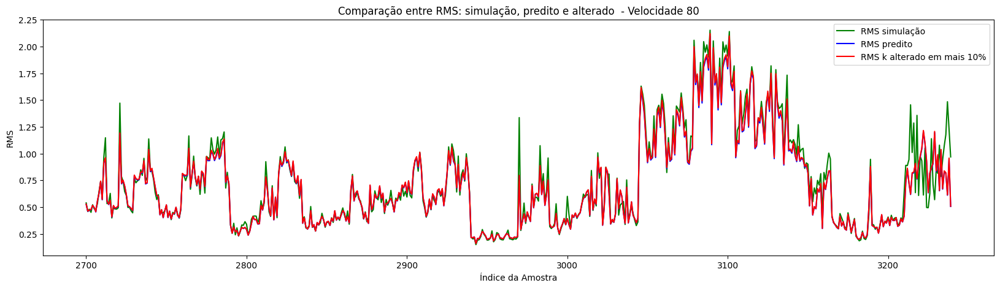

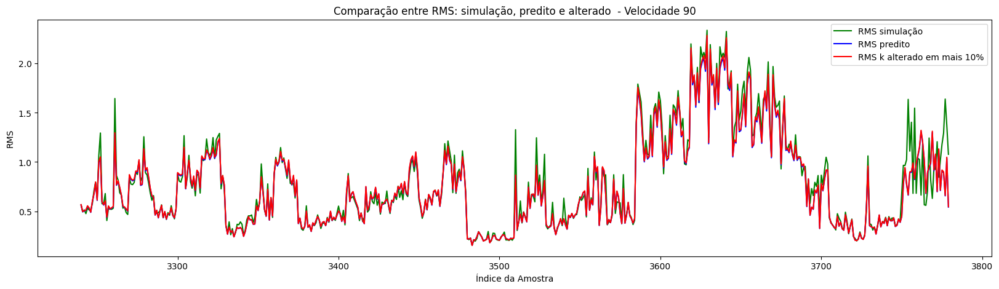

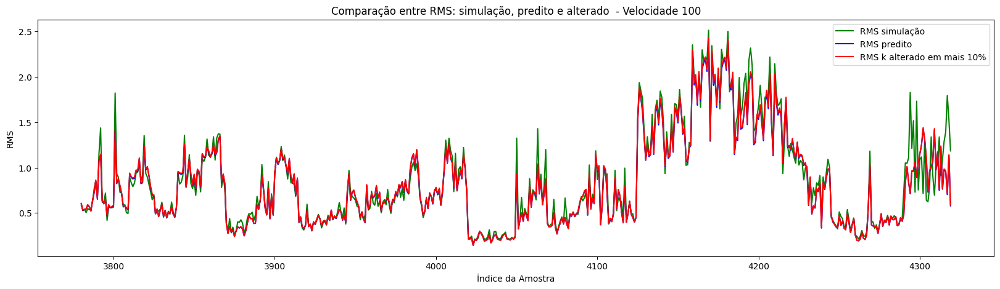

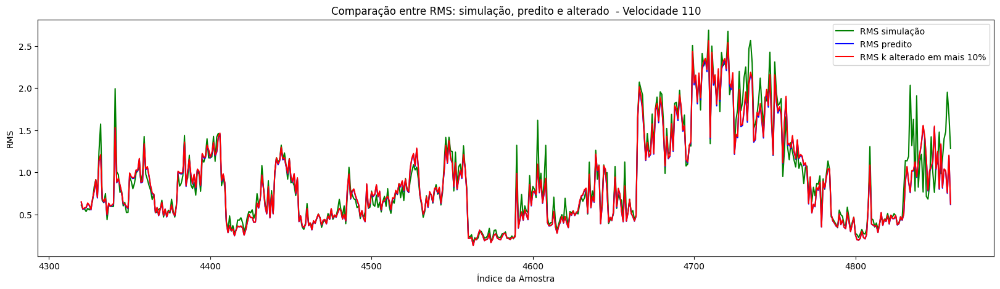

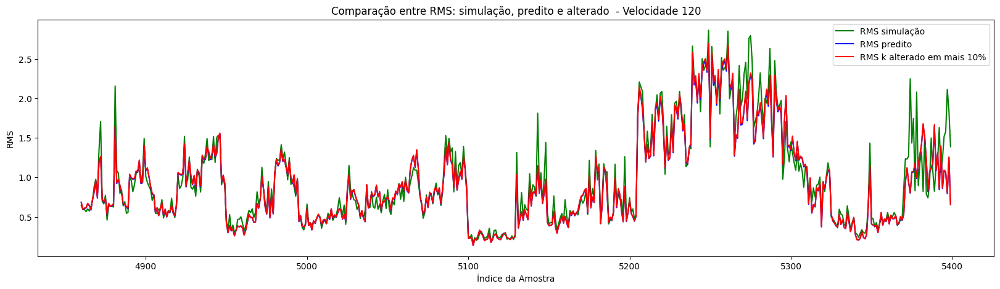

In [ ]:
intervalo_total = 5400

num_subdivisoes = 10

tamanho_subdivisao = intervalo_total // num_subdivisoes

for i in range(num_subdivisoes):
    plt.figure(figsize=(20, 5))

    velocidade = 30 + i * 10

    inicio = i * tamanho_subdivisao
    fim = (i + 1) * tamanho_subdivisao

    plt.plot(range(inicio, fim), y_A_HB[inicio:fim], label='RMS simulação', color='green')
    plt.plot(range(inicio, fim), y_pred_A_HB[inicio:fim], label='RMS predito', color='blue')
    plt.plot(range(inicio, fim), y_pred_A_HB_k_mais_10[inicio:fim], label='RMS k alterado em mais 10%', color='red')
    plt.legend()
    plt.xlabel('Índice da Amostra')
    plt.ylabel('RMS')
    plt.title(f'Comparação entre RMS: simulação, predito e alterado  - Velocidade {velocidade}')
    plt.show()
    print('\n')

### +20%

In [ ]:
X_A_HB_k_mais_20 = X_A_HB.copy()

X_A_HB_k_mais_20['k'] = 0.037017

In [ ]:
print(X_A_HB_k_mais_20)

            IRI    V         k         c        ms       mus       kus
0      0.175070  0.0  0.037017  0.103632  0.121332  0.123328  0.377358
1      0.147721  0.0  0.037017  0.103632  0.121332  0.123328  0.377358
2      0.151798  0.0  0.037017  0.103632  0.121332  0.123328  0.377358
3      0.154031  0.0  0.037017  0.103632  0.121332  0.123328  0.377358
4      0.170444  0.0  0.037017  0.103632  0.121332  0.123328  0.377358
...         ...  ...       ...       ...       ...       ...       ...
44275  0.325042  1.0  0.037017  0.103632  0.121332  0.123328  0.377358
44276  0.316123  1.0  0.037017  0.103632  0.121332  0.123328  0.377358
44277  0.210425  1.0  0.037017  0.103632  0.121332  0.123328  0.377358
44278  0.402940  1.0  0.037017  0.103632  0.121332  0.123328  0.377358
44279  0.167129  1.0  0.037017  0.103632  0.121332  0.123328  0.377358

[5400 rows x 7 columns]


In [ ]:
y_pred_A_HB_k_mais_20 = modelo.predict(X_A_HB_k_mais_20)

169/169 [==============================] - 0s 3ms/step


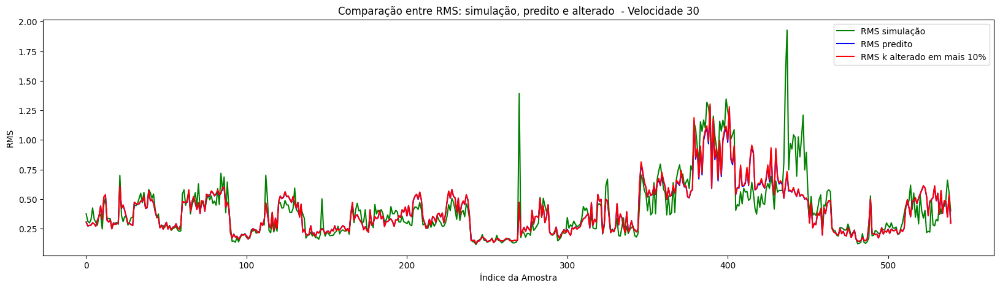

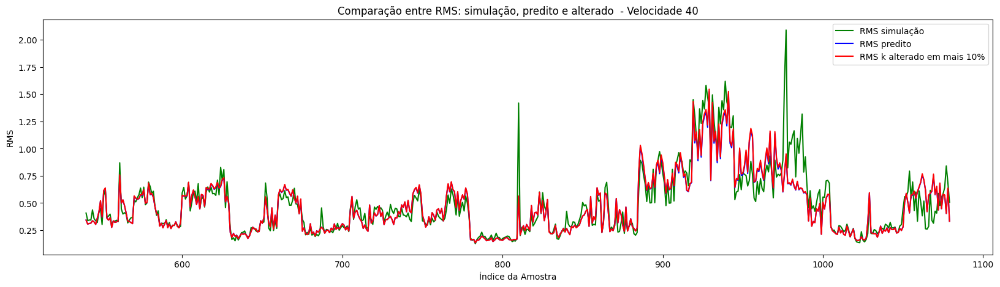

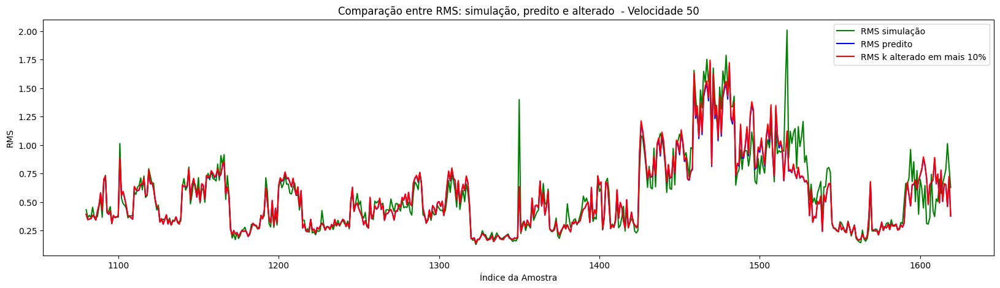

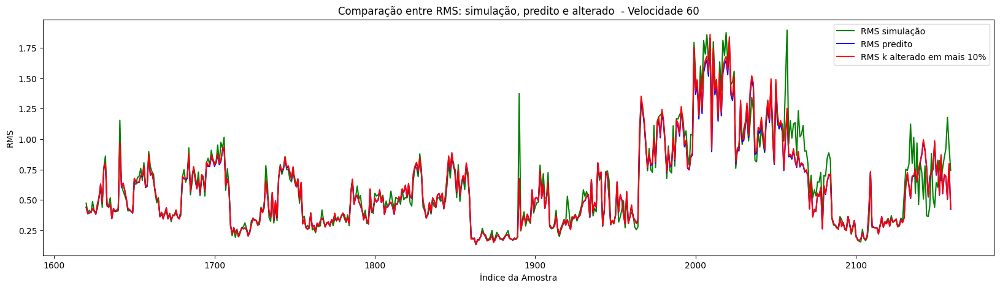

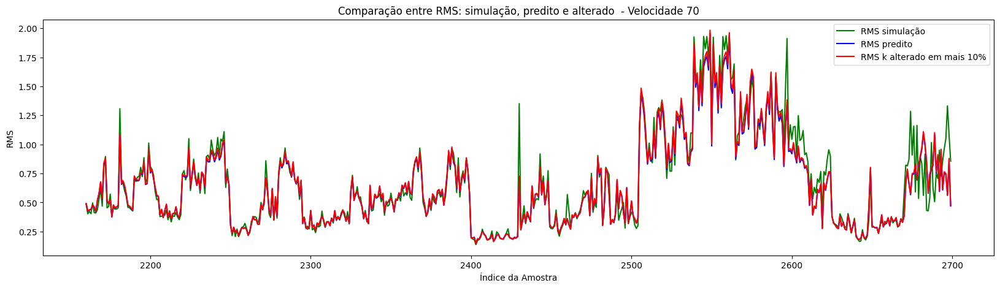

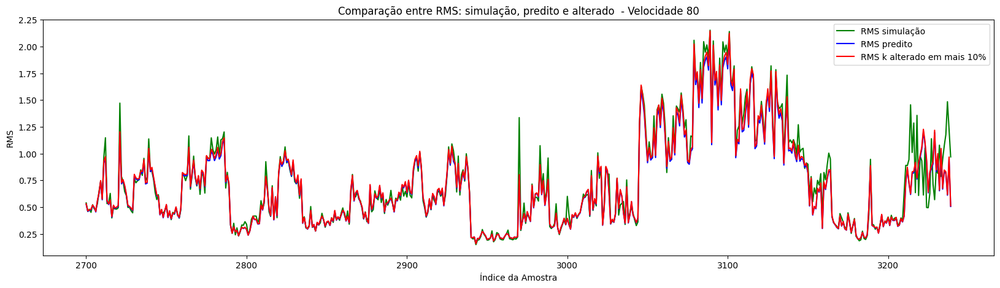

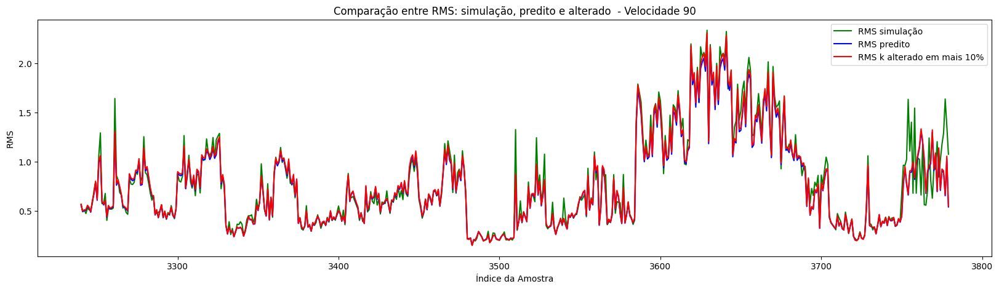

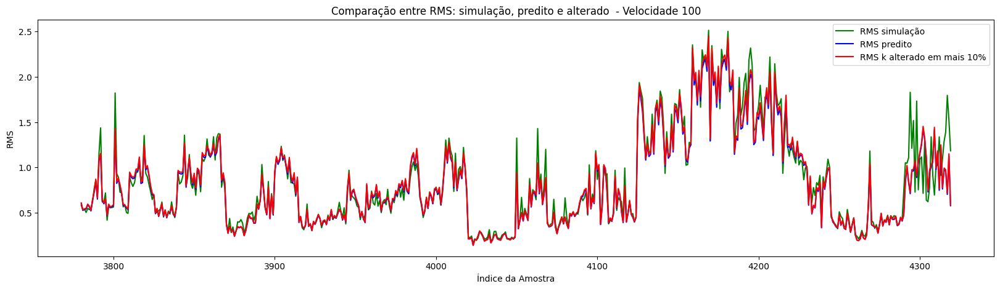

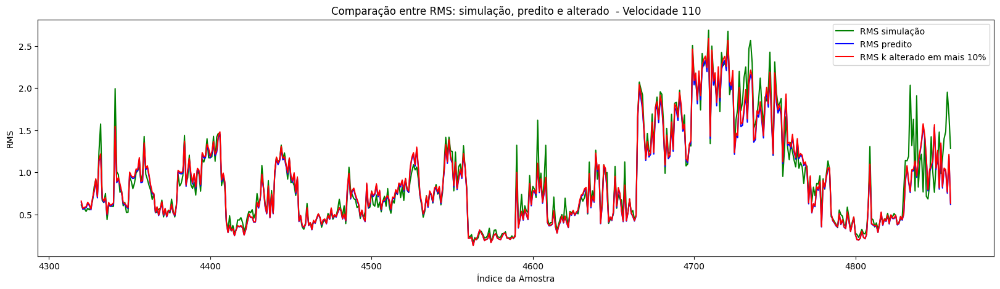

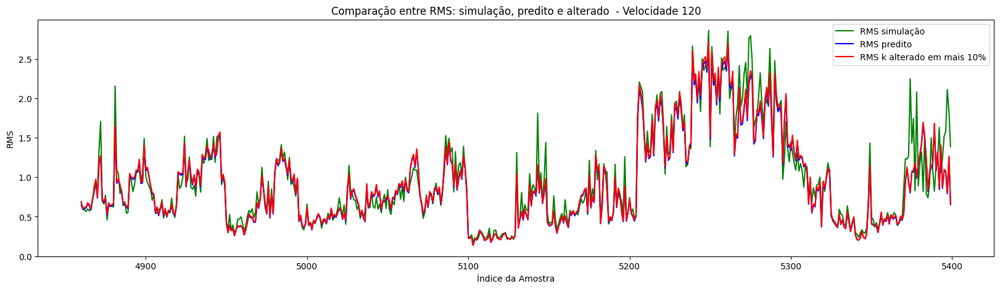

In [ ]:
intervalo_total = 5400

num_subdivisoes = 10

tamanho_subdivisao = intervalo_total // num_subdivisoes

for i in range(num_subdivisoes):
    plt.figure(figsize=(20, 5))

    velocidade = 30 + i * 10

    inicio = i * tamanho_subdivisao
    fim = (i + 1) * tamanho_subdivisao

    plt.plot(range(inicio, fim), y_A_HB[inicio:fim], label='RMS simulação', color='green')
    plt.plot(range(inicio, fim), y_pred_A_HB[inicio:fim], label='RMS predito', color='blue')
    plt.plot(range(inicio, fim), y_pred_A_HB_k_mais_20[inicio:fim], label='RMS k alterado em mais 20%', color='red')
    plt.legend()
    plt.xlabel('Índice da Amostra')
    plt.ylabel('RMS')
    plt.title(f'Comparação entre RMS: simulação, predito e alterado  - Velocidade {velocidade}')
    plt.show()
    print('\n')

### +30%

In [ ]:
X_A_HB_k_mais_30 = X_A_HB.copy()

X_A_HB_k_mais_30['k'] = 0.037017

In [ ]:
print(X_A_HB_k_mais_30)

            IRI    V         k         c        ms       mus       kus
0      0.175070  0.0  0.037017  0.103632  0.121332  0.123328  0.377358
1      0.147721  0.0  0.037017  0.103632  0.121332  0.123328  0.377358
2      0.151798  0.0  0.037017  0.103632  0.121332  0.123328  0.377358
3      0.154031  0.0  0.037017  0.103632  0.121332  0.123328  0.377358
4      0.170444  0.0  0.037017  0.103632  0.121332  0.123328  0.377358
...         ...  ...       ...       ...       ...       ...       ...
44275  0.325042  1.0  0.037017  0.103632  0.121332  0.123328  0.377358
44276  0.316123  1.0  0.037017  0.103632  0.121332  0.123328  0.377358
44277  0.210425  1.0  0.037017  0.103632  0.121332  0.123328  0.377358
44278  0.402940  1.0  0.037017  0.103632  0.121332  0.123328  0.377358
44279  0.167129  1.0  0.037017  0.103632  0.121332  0.123328  0.377358

[5400 rows x 7 columns]


In [ ]:
y_pred_A_HB_k_mais_30 = modelo.predict(X_A_HB_k_mais_30)

169/169 [==============================] - 0s 2ms/step


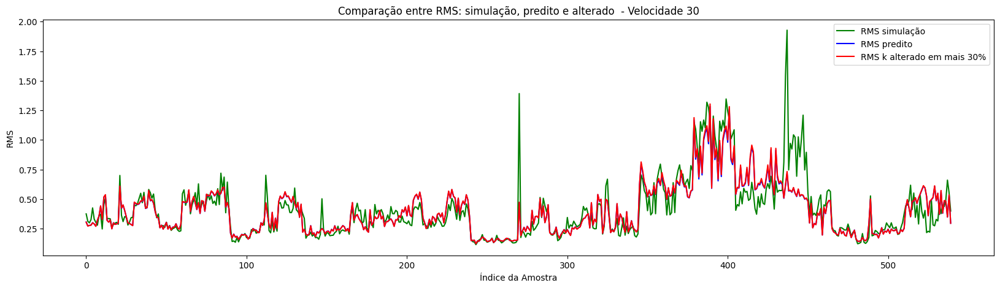

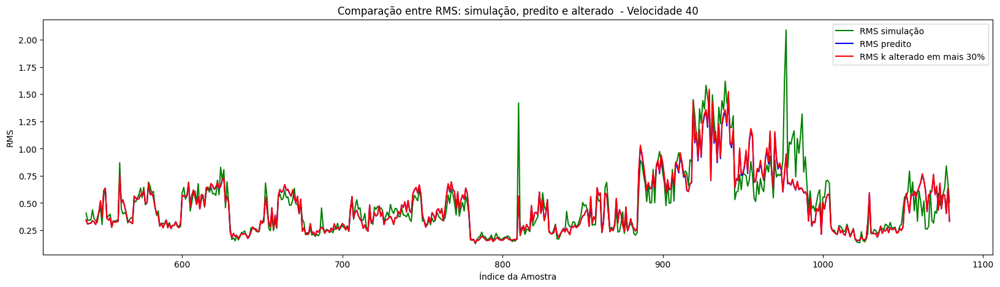

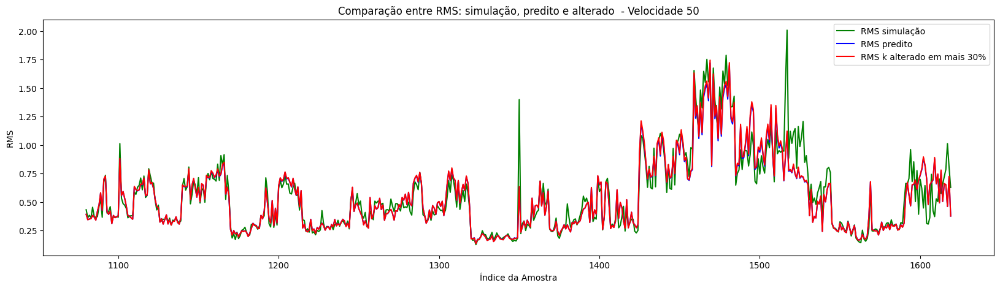

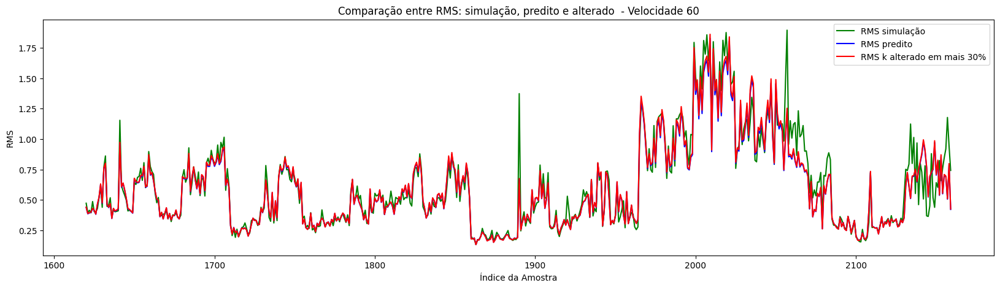

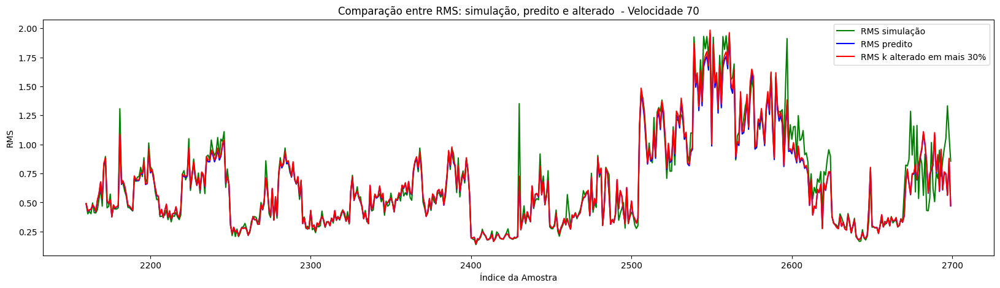

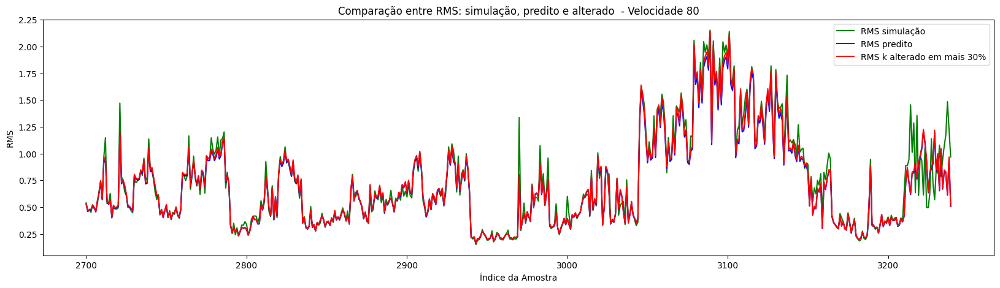

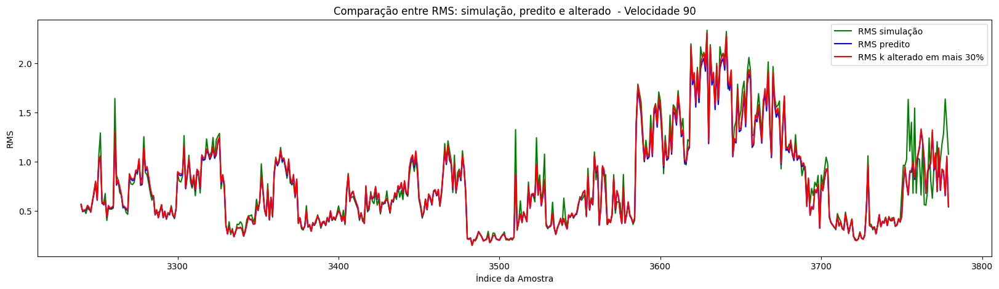

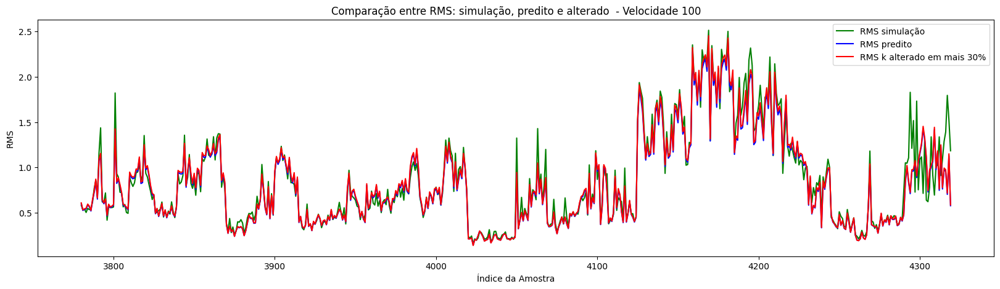

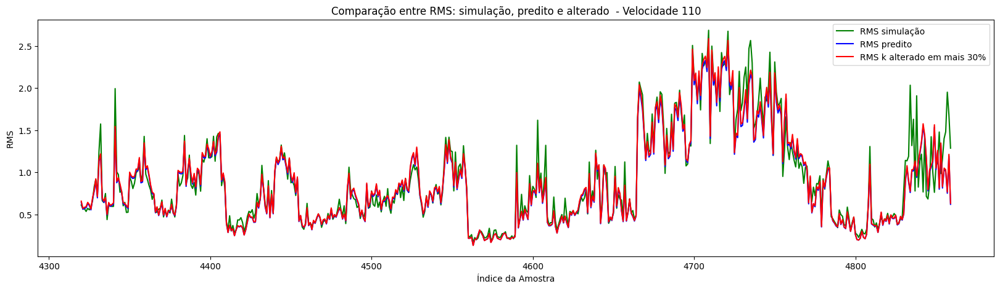

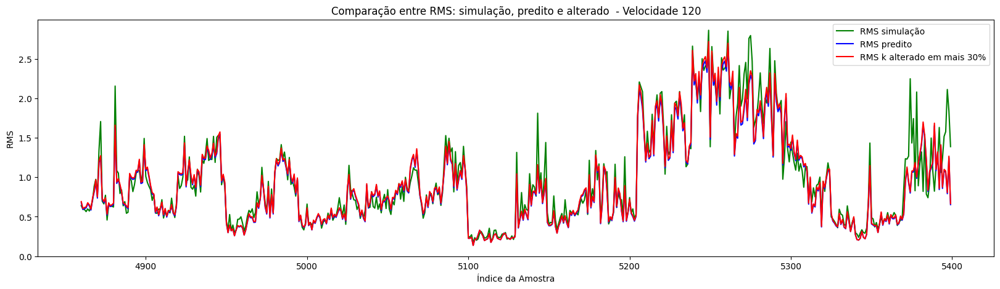

In [ ]:
intervalo_total = 5400

num_subdivisoes = 10

tamanho_subdivisao = intervalo_total // num_subdivisoes

for i in range(num_subdivisoes):
    plt.figure(figsize=(20, 5))

    velocidade = 30 + i * 10

    inicio = i * tamanho_subdivisao
    fim = (i + 1) * tamanho_subdivisao

    plt.plot(range(inicio, fim), y_A_HB[inicio:fim], label='RMS simulação', color='green')
    plt.plot(range(inicio, fim), y_pred_A_HB[inicio:fim], label='RMS predito', color='blue')
    plt.plot(range(inicio, fim), y_pred_A_HB_k_mais_30[inicio:fim], label='RMS k alterado em mais 30%', color='red')
    plt.legend()
    plt.xlabel('Índice da Amostra')
    plt.ylabel('RMS')
    plt.title(f'Comparação entre RMS: simulação, predito e alterado  - Velocidade {velocidade}')
    plt.show()
    print('\n')

## Variações c

### -10%

In [ ]:
X_A_HB_c_menos_10 = X_A_HB.copy()

X_A_HB_c_menos_10['c'] = 0.069026

In [ ]:
print(X_A_HB_c_menos_10)

            IRI    V        k         c        ms       mus       kus
0      0.175070  0.0  0.02221  0.069026  0.121332  0.123328  0.377358
1      0.147721  0.0  0.02221  0.069026  0.121332  0.123328  0.377358
2      0.151798  0.0  0.02221  0.069026  0.121332  0.123328  0.377358
3      0.154031  0.0  0.02221  0.069026  0.121332  0.123328  0.377358
4      0.170444  0.0  0.02221  0.069026  0.121332  0.123328  0.377358
...         ...  ...      ...       ...       ...       ...       ...
44275  0.325042  1.0  0.02221  0.069026  0.121332  0.123328  0.377358
44276  0.316123  1.0  0.02221  0.069026  0.121332  0.123328  0.377358
44277  0.210425  1.0  0.02221  0.069026  0.121332  0.123328  0.377358
44278  0.402940  1.0  0.02221  0.069026  0.121332  0.123328  0.377358
44279  0.167129  1.0  0.02221  0.069026  0.121332  0.123328  0.377358

[5400 rows x 7 columns]


In [ ]:
y_pred_A_HB_c_menos_10 = modelo.predict(X_A_HB_c_menos_10)

169/169 [==============================] - 0s 2ms/step


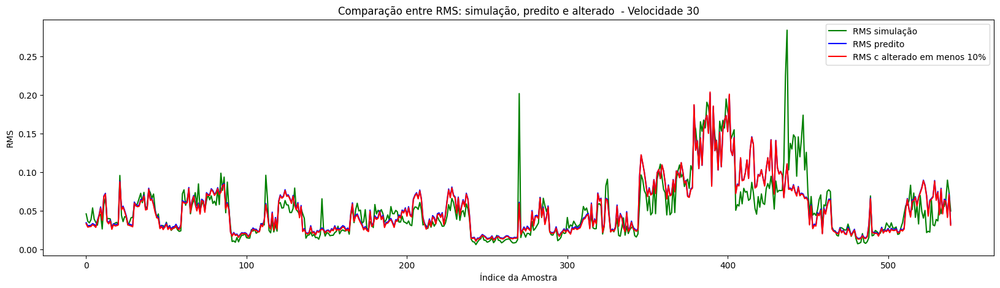

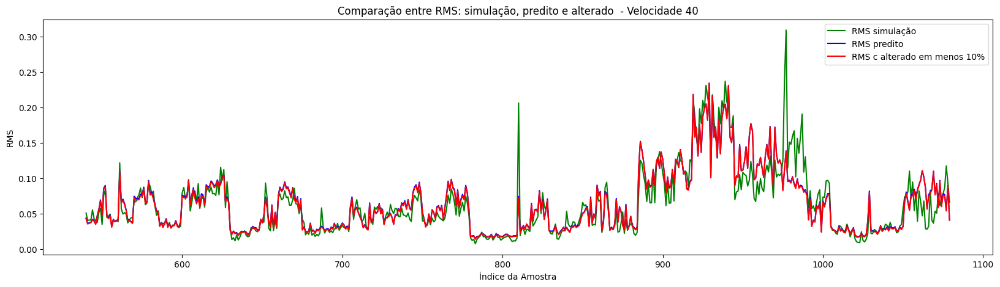

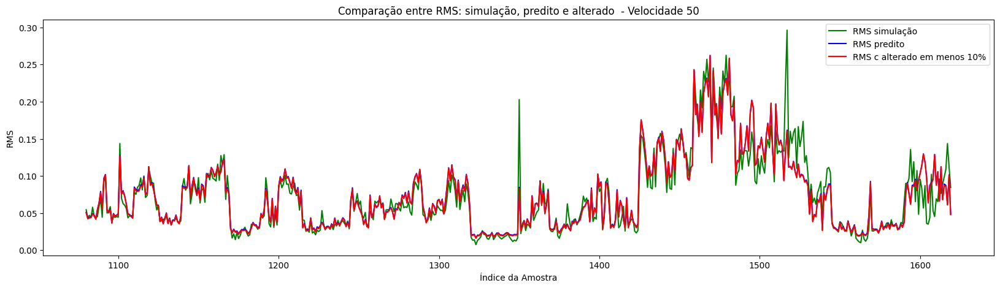

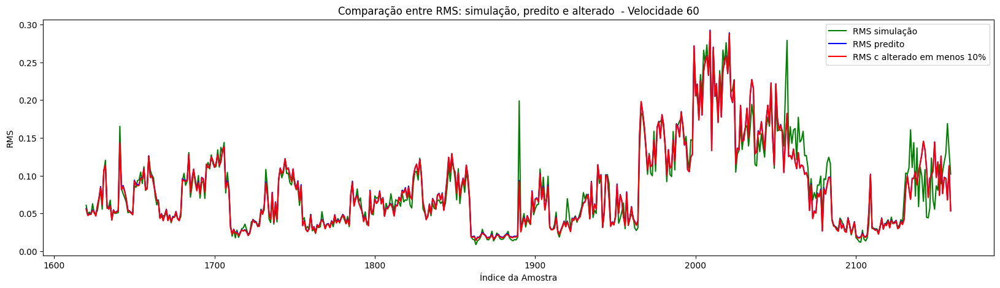

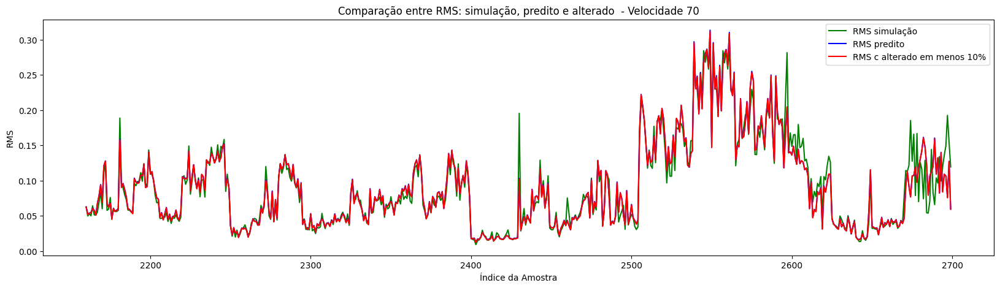

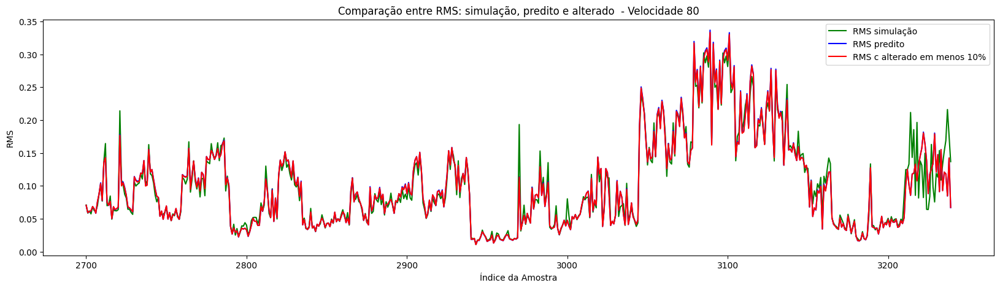

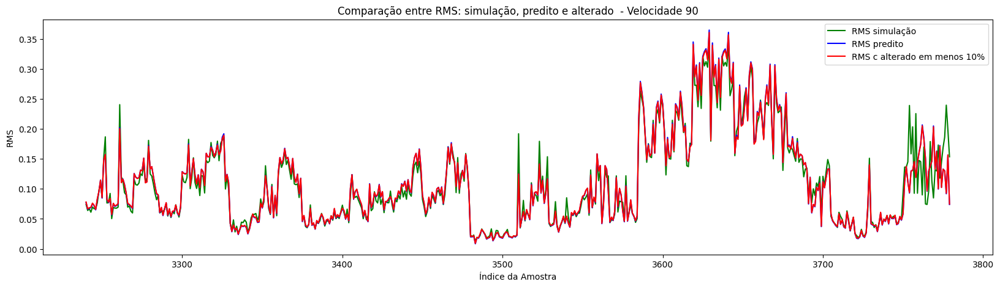

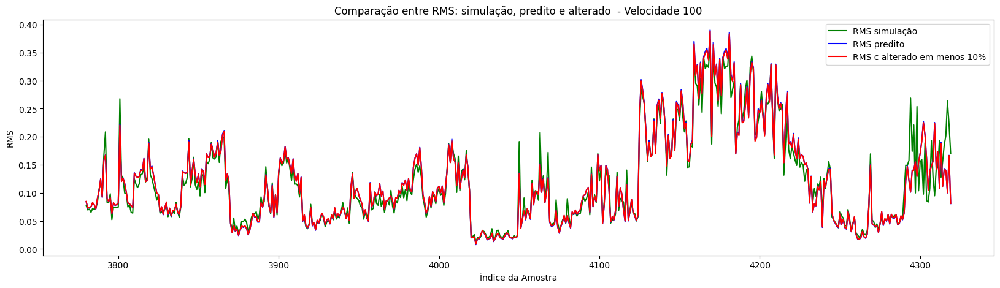

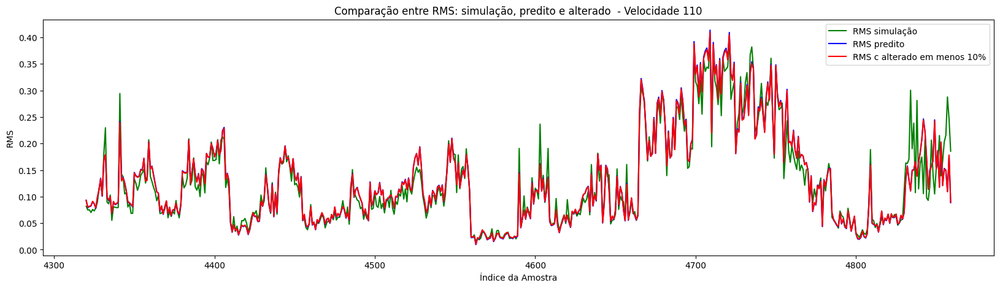

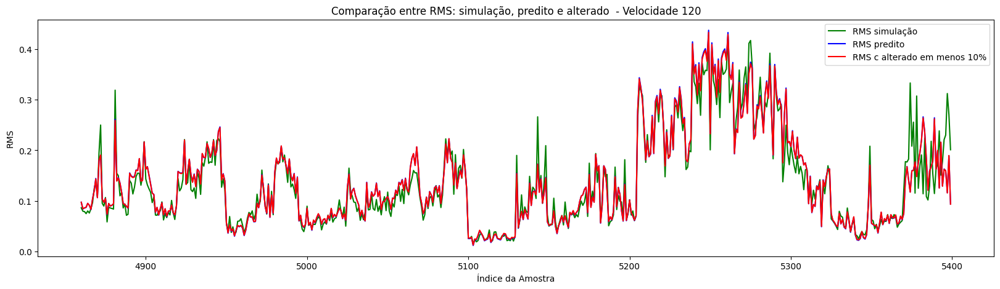

In [ ]:
intervalo_total = 5400

num_subdivisoes = 10

tamanho_subdivisao = intervalo_total // num_subdivisoes

for i in range(num_subdivisoes):
    plt.figure(figsize=(20, 5))

    velocidade = 30 + i * 10

    inicio = i * tamanho_subdivisao
    fim = (i + 1) * tamanho_subdivisao

    plt.plot(range(inicio, fim), y_A_HB[inicio:fim], label='RMS simulação', color='green')
    plt.plot(range(inicio, fim), y_pred_A_HB[inicio:fim], label='RMS predito', color='blue')
    plt.plot(range(inicio, fim), y_pred_A_HB_c_menos_10[inicio:fim], label='RMS c alterado em menos 10%', color='red')
    plt.legend()
    plt.xlabel('Índice da Amostra')
    plt.ylabel('RMS')
    plt.title(f'Comparação entre RMS: simulação, predito e alterado  - Velocidade {velocidade}')
    plt.show()
    print('\n')

### -20%

In [ ]:
X_A_HB_c_menos_20 = X_A_HB.copy()

X_A_HB_c_menos_20['c'] = 0.034568

In [ ]:
print(X_A_HB_c_menos_20)

            IRI    V        k         c        ms       mus       kus
0      0.175070  0.0  0.02221  0.034568  0.121332  0.123328  0.377358
1      0.147721  0.0  0.02221  0.034568  0.121332  0.123328  0.377358
2      0.151798  0.0  0.02221  0.034568  0.121332  0.123328  0.377358
3      0.154031  0.0  0.02221  0.034568  0.121332  0.123328  0.377358
4      0.170444  0.0  0.02221  0.034568  0.121332  0.123328  0.377358
...         ...  ...      ...       ...       ...       ...       ...
44275  0.325042  1.0  0.02221  0.034568  0.121332  0.123328  0.377358
44276  0.316123  1.0  0.02221  0.034568  0.121332  0.123328  0.377358
44277  0.210425  1.0  0.02221  0.034568  0.121332  0.123328  0.377358
44278  0.402940  1.0  0.02221  0.034568  0.121332  0.123328  0.377358
44279  0.167129  1.0  0.02221  0.034568  0.121332  0.123328  0.377358

[5400 rows x 7 columns]


In [ ]:
y_pred_A_HB_c_menos_20 = modelo.predict(X_A_HB_c_menos_20)

169/169 [==============================] - 0s 2ms/step


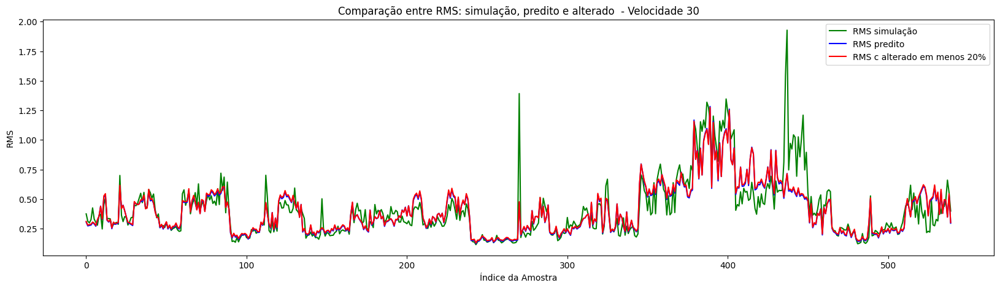

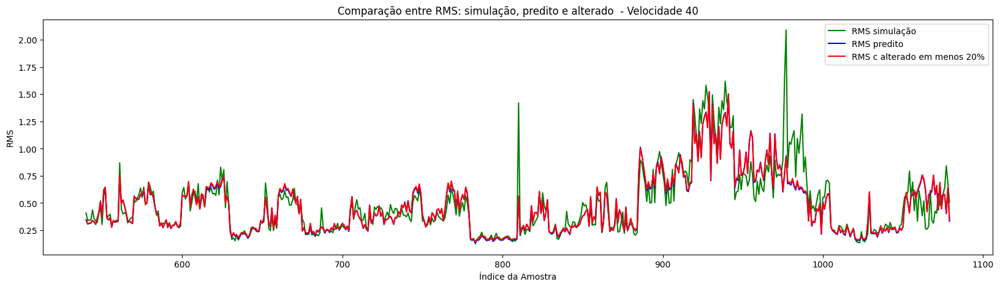

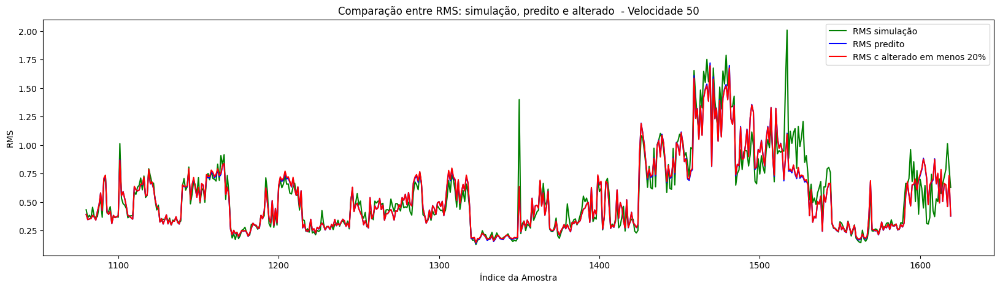

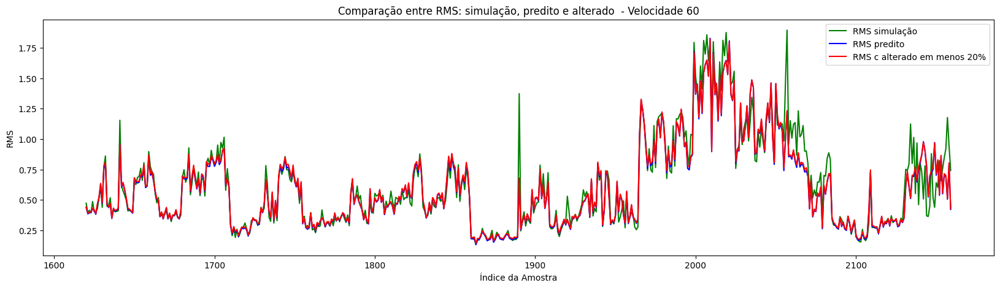

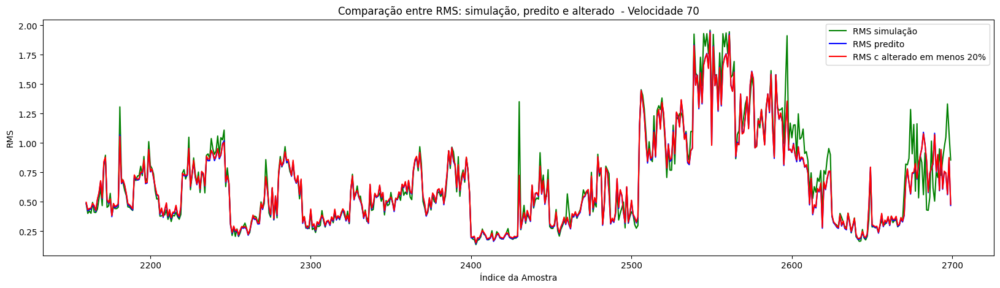

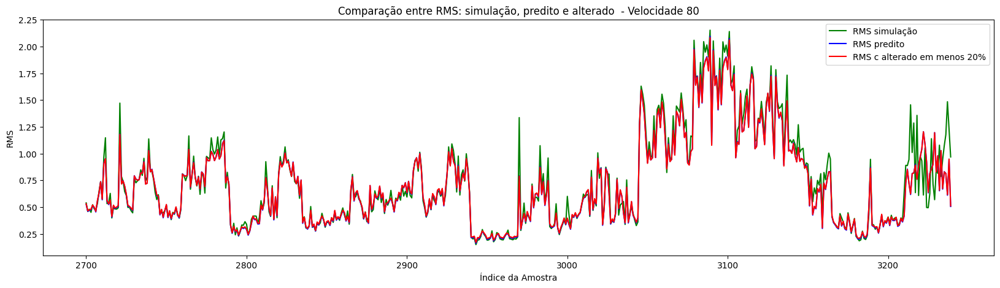

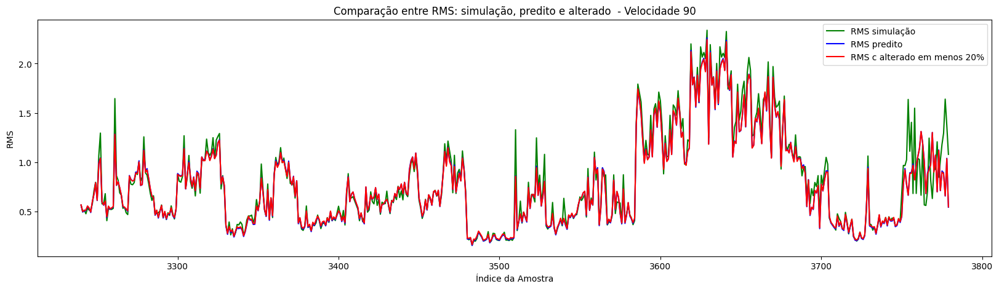

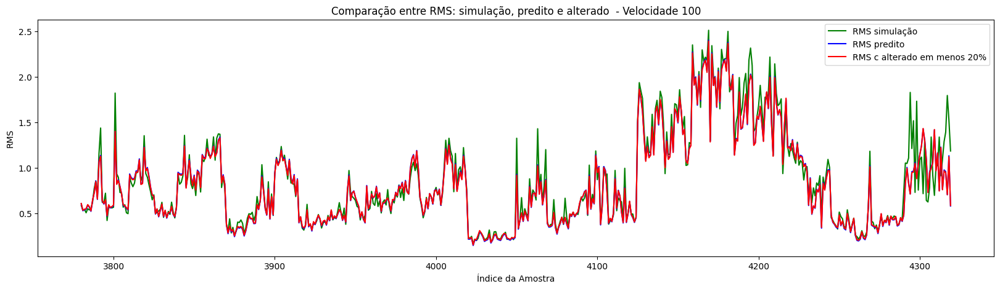

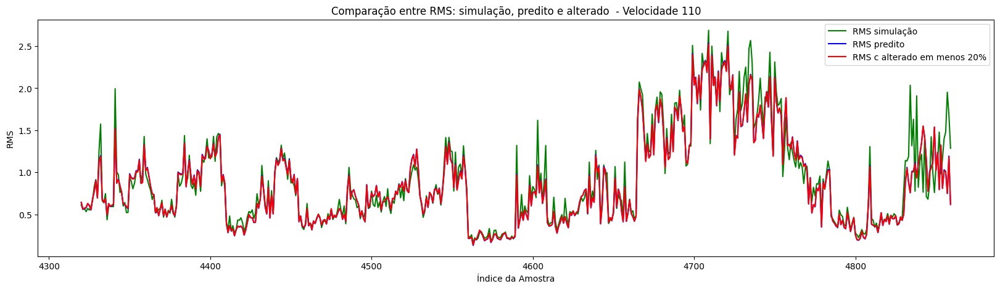

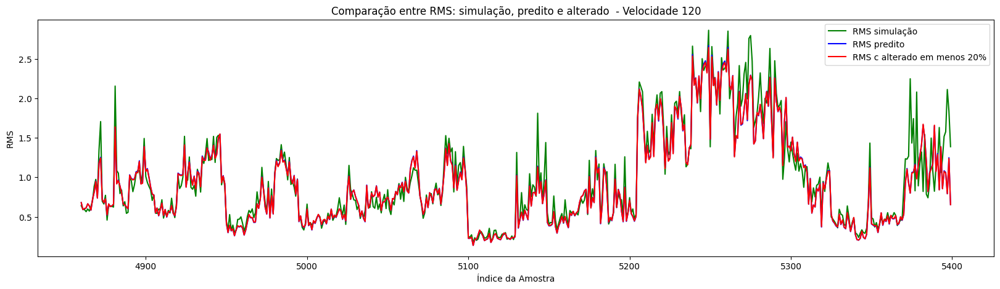

In [ ]:
intervalo_total = 5400

num_subdivisoes = 10

tamanho_subdivisao = intervalo_total // num_subdivisoes

for i in range(num_subdivisoes):
    plt.figure(figsize=(20, 5))

    velocidade = 30 + i * 10

    inicio = i * tamanho_subdivisao
    fim = (i + 1) * tamanho_subdivisao

    plt.plot(range(inicio, fim), y_A_HB[inicio:fim], label='RMS simulação', color='green')
    plt.plot(range(inicio, fim), y_pred_A_HB[inicio:fim], label='RMS predito', color='blue')
    plt.plot(range(inicio, fim), y_pred_A_HB_c_menos_20[inicio:fim], label='RMS c alterado em menos 20%', color='red')
    plt.legend()
    plt.xlabel('Índice da Amostra')
    plt.ylabel('RMS')
    plt.title(f'Comparação entre RMS: simulação, predito e alterado  - Velocidade {velocidade}')
    plt.show()
    print('\n')

### -30%

In [45]:
X_A_HB_c_menos_30 = X_A_HB.copy()

X_A_HB_c_menos_30['c'] = 0

In [46]:
print(X_A_HB_c_menos_30)

       Diferença RMS anterior  Diferença RMS proximo  Diferença IRI anterior  \
0                    0.000000               0.062361                0.000000   
1                   -0.062361               0.013280               -0.192167   
2                   -0.013280              -0.026840                0.028648   
3                    0.026840              -0.099267                0.015690   
4                    0.099267               0.095108                0.115323   
...                       ...                    ...                     ...   
44275                0.282240              -0.059381                0.646897   
44276                0.059381              -0.534641               -0.062674   
44277                0.534641               0.272724               -0.742677   
44278               -0.272724               0.450963                1.352695   
44279               -0.450963               0.690964               -1.656911   

       Diferença IRI proximo       IRI 

In [47]:
y_pred_A_HB_c_menos_30 = modelo.predict(X_A_HB_c_menos_30)

169/169 [==============================] - 0s 3ms/step


In [48]:
intervalo_total = 5400

num_subdivisoes = 10

tamanho_subdivisao = intervalo_total // num_subdivisoes

for i in range(num_subdivisoes):
    plt.figure(figsize=(20, 5))

    velocidade = 30 + i * 10

    inicio = i * tamanho_subdivisao
    fim = (i + 1) * tamanho_subdivisao

    plt.plot(range(inicio, fim), y_A_HB[inicio:fim], label='RMS simulação', color='green')
    plt.plot(range(inicio, fim), y_pred_A_HB[inicio:fim], label='RMS predito', color='blue')
    plt.plot(range(inicio, fim), y_pred_A_HB_c_menos_30[inicio:fim], label='RMS c alterado em menos 30%', color='red')
    plt.legend()
    plt.xlabel('Índice da Amostra')
    plt.ylabel('RMS')
    plt.title(f'Comparação entre RMS: simulação, predito e alterado  - Velocidade {velocidade}')
    plt.show()
    print('\n')

Output hidden; open in https://colab.research.google.com to view.

### +10%

In [50]:
X_A_HB_c_mais_10 = X_A_HB.copy()

X_A_HB_c_mais_10['c'] = 0.138163

In [51]:
print(X_A_HB_c_mais_10)

       Diferença RMS anterior  Diferença RMS proximo  Diferença IRI anterior  \
0                    0.000000               0.062361                0.000000   
1                   -0.062361               0.013280               -0.192167   
2                   -0.013280              -0.026840                0.028648   
3                    0.026840              -0.099267                0.015690   
4                    0.099267               0.095108                0.115323   
...                       ...                    ...                     ...   
44275                0.282240              -0.059381                0.646897   
44276                0.059381              -0.534641               -0.062674   
44277                0.534641               0.272724               -0.742677   
44278               -0.272724               0.450963                1.352695   
44279               -0.450963               0.690964               -1.656911   

       Diferença IRI proximo       IRI 

In [52]:
y_pred_A_HB_c_mais_10 = modelo.predict(X_A_HB_c_mais_10)

169/169 [==============================] - 0s 3ms/step


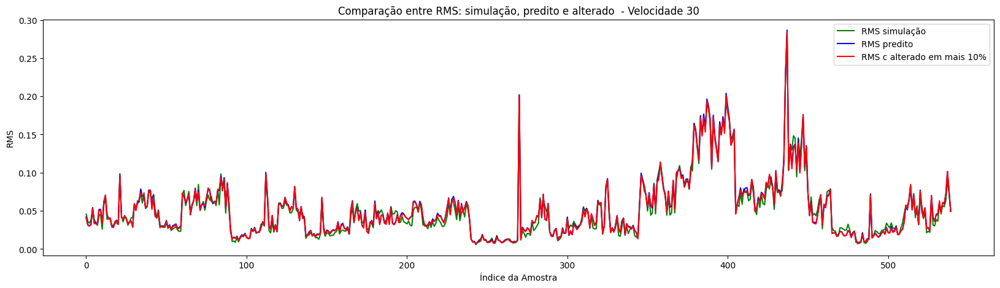

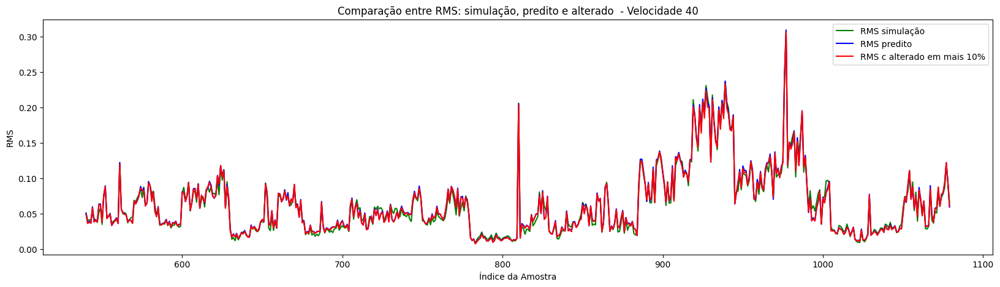

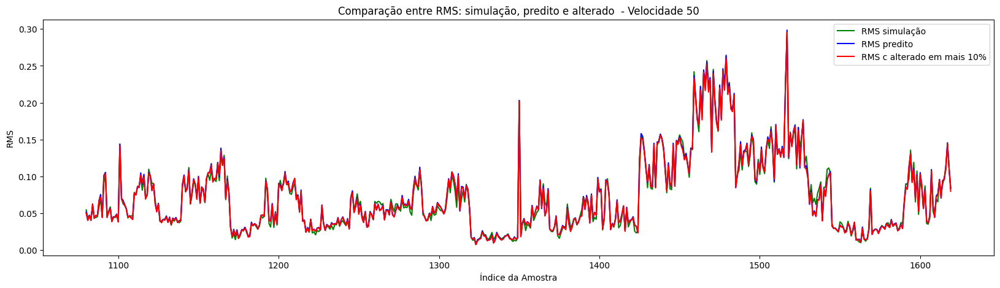

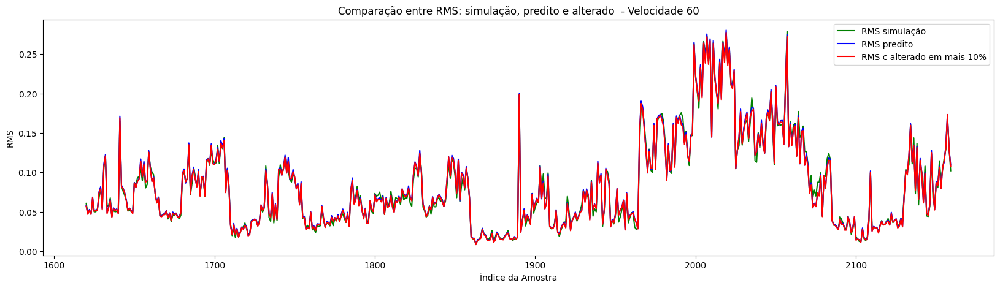

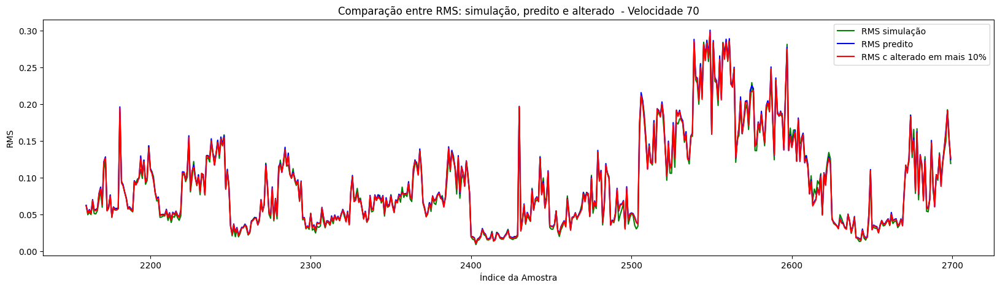

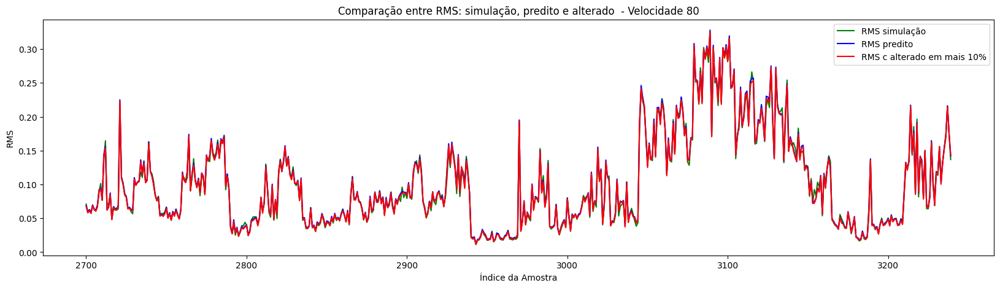

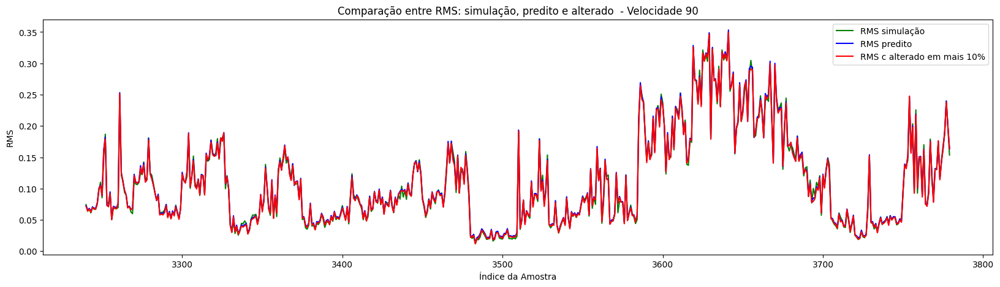

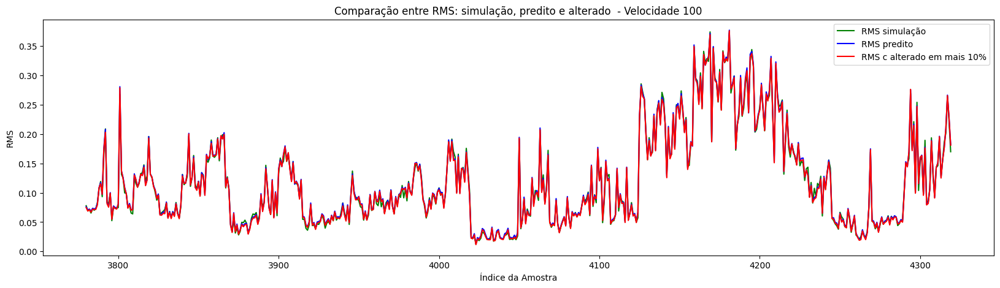

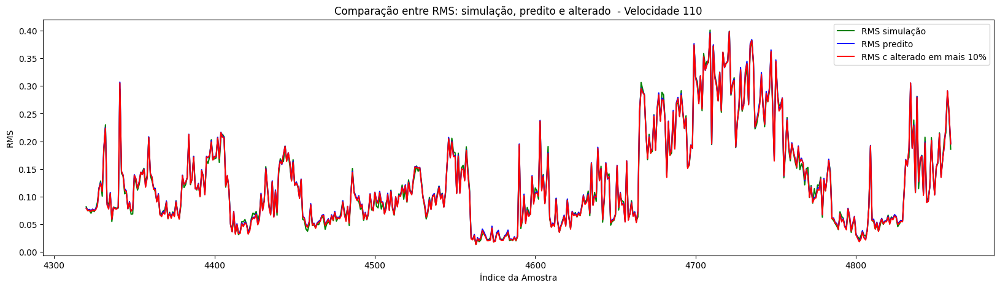

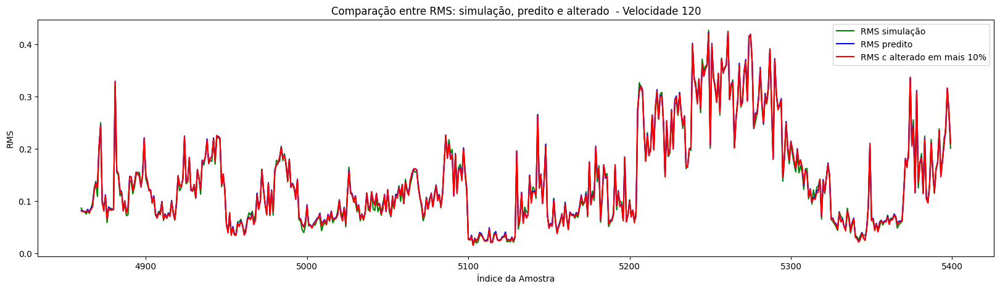

In [53]:
intervalo_total = 5400

num_subdivisoes = 10

tamanho_subdivisao = intervalo_total // num_subdivisoes

for i in range(num_subdivisoes):
    plt.figure(figsize=(20, 5))

    velocidade = 30 + i * 10

    inicio = i * tamanho_subdivisao
    fim = (i + 1) * tamanho_subdivisao

    plt.plot(range(inicio, fim), y_A_HB[inicio:fim], label='RMS simulação', color='green')
    plt.plot(range(inicio, fim), y_pred_A_HB[inicio:fim], label='RMS predito', color='blue')
    plt.plot(range(inicio, fim), y_pred_A_HB_c_mais_10[inicio:fim], label='RMS c alterado em mais 10%', color='red')
    plt.legend()
    plt.xlabel('Índice da Amostra')
    plt.ylabel('RMS')
    plt.title(f'Comparação entre RMS: simulação, predito e alterado  - Velocidade {velocidade}')
    plt.show()
    print('\n')

### +20%

In [54]:
X_A_HB_c_mais_20 = X_A_HB.copy()

X_A_HB_c_mais_20['c'] = 0.172694

In [55]:
y_pred_A_HB_c_mais_20 = modelo.predict(X_A_HB_c_mais_20)

169/169 [==============================] - 1s 4ms/step


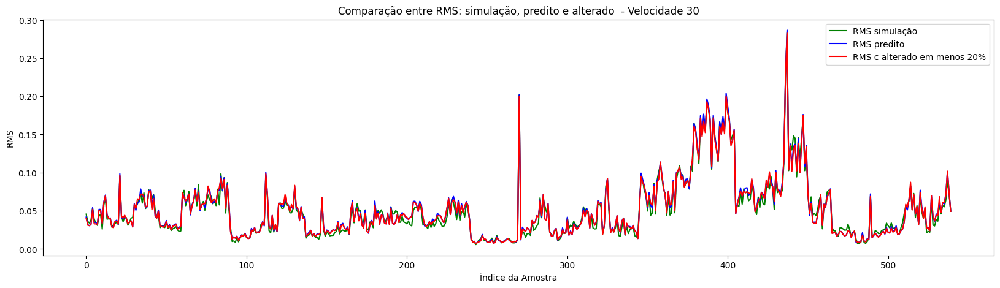

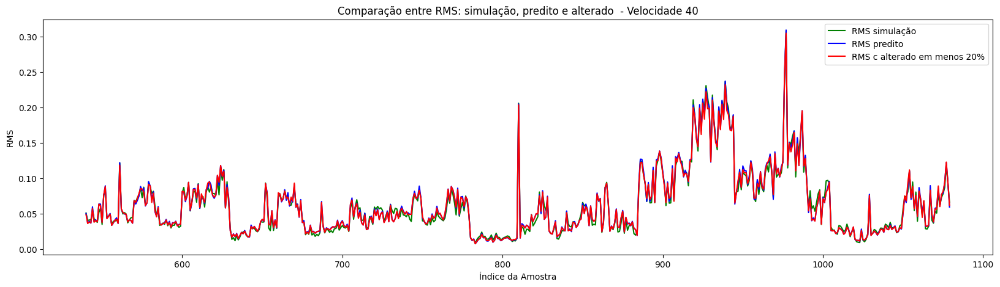

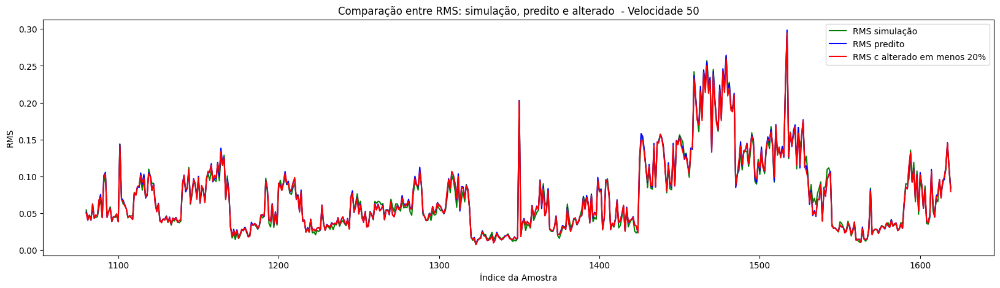

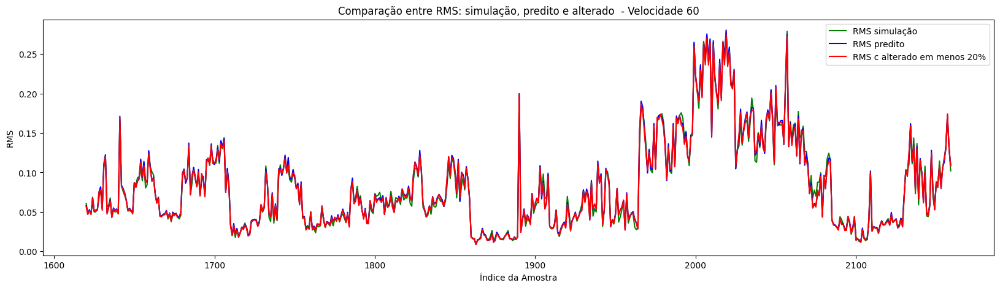

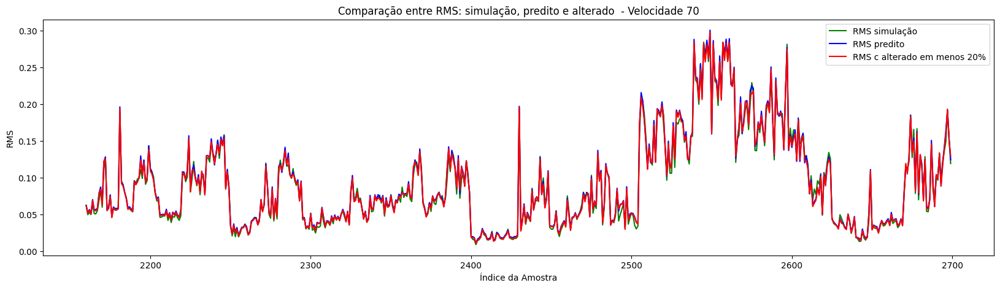

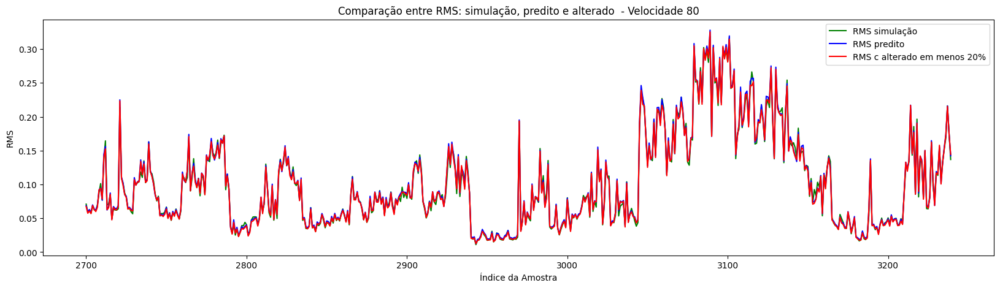

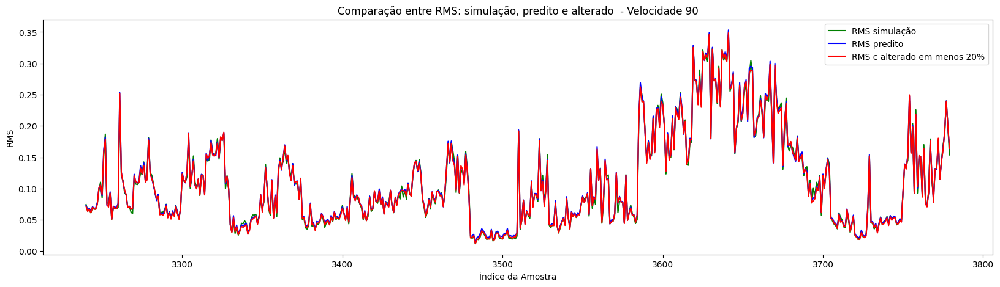

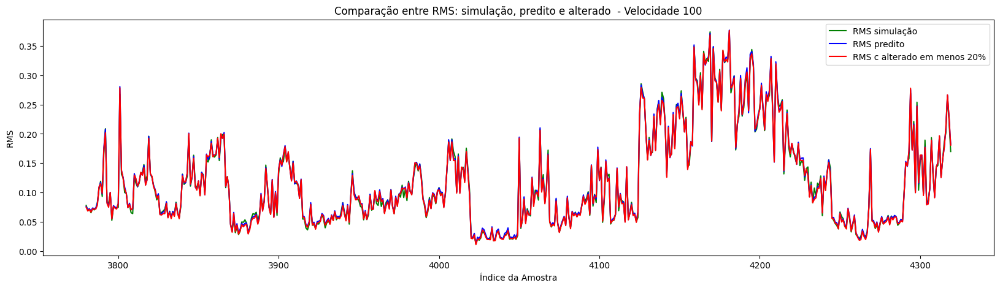

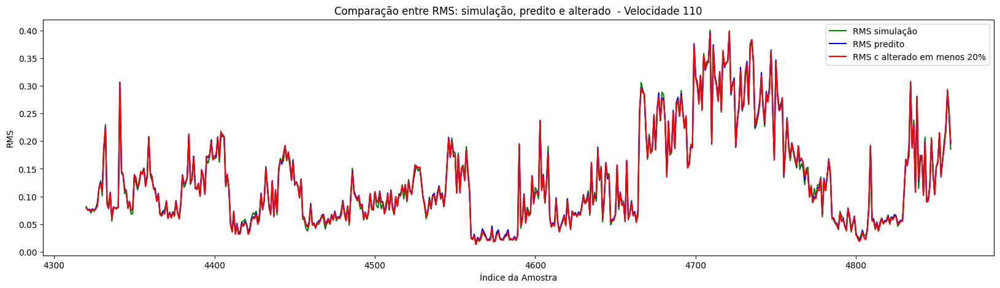

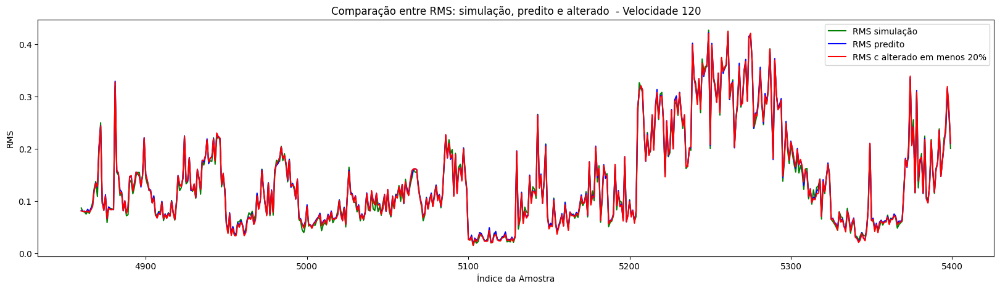

In [56]:
intervalo_total = 5400

num_subdivisoes = 10

tamanho_subdivisao = intervalo_total // num_subdivisoes

for i in range(num_subdivisoes):
    plt.figure(figsize=(20, 5))

    velocidade = 30 + i * 10

    inicio = i * tamanho_subdivisao
    fim = (i + 1) * tamanho_subdivisao

    plt.plot(range(inicio, fim), y_A_HB[inicio:fim], label='RMS simulação', color='green')
    plt.plot(range(inicio, fim), y_pred_A_HB[inicio:fim], label='RMS predito', color='blue')
    plt.plot(range(inicio, fim), y_pred_A_HB_c_mais_20[inicio:fim], label='RMS c alterado em menos 20%', color='red')
    plt.legend()
    plt.xlabel('Índice da Amostra')
    plt.ylabel('RMS')
    plt.title(f'Comparação entre RMS: simulação, predito e alterado  - Velocidade {velocidade}')
    plt.show()
    print('\n')

### +30%

In [57]:
X_A_HB_c_menos_20 = X_A_HB.copy()

X_A_HB_c_menos_20['c'] = 0.209067

In [58]:
y_pred_A_HB_c_menos_20 = modelo.predict(X_A_HB_c_menos_20)

169/169 [==============================] - 27s 163ms/step


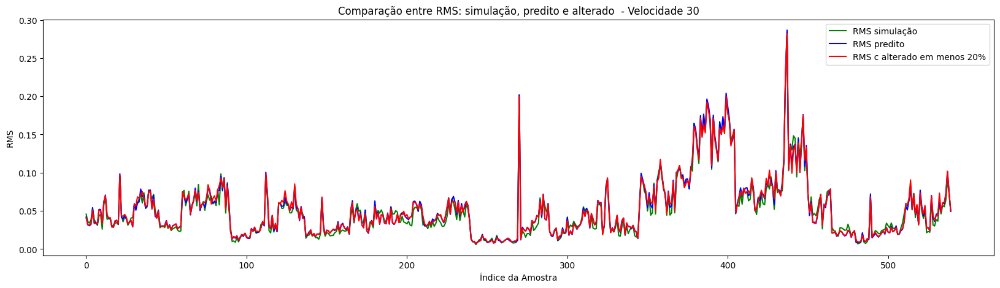

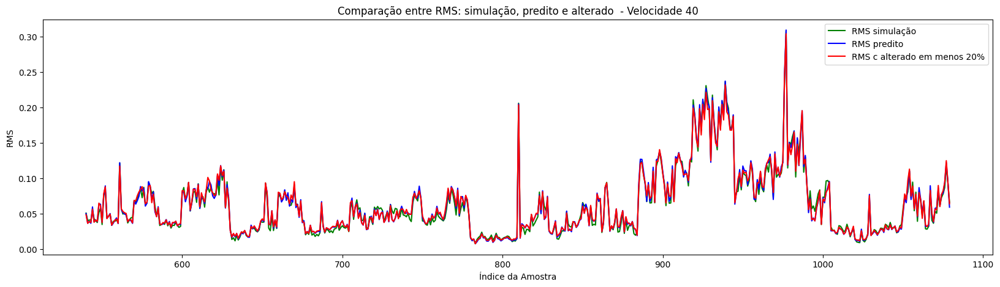

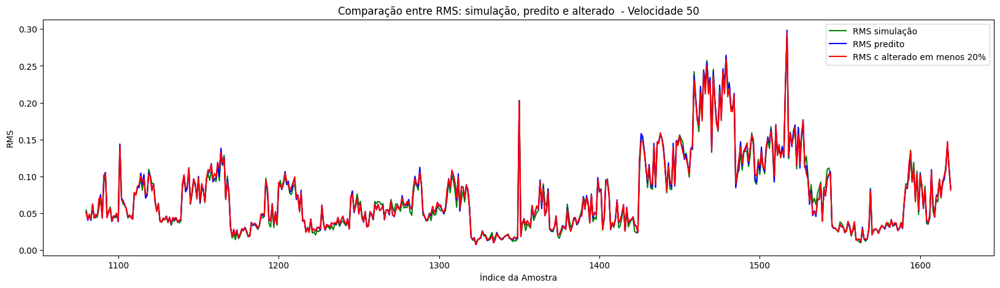

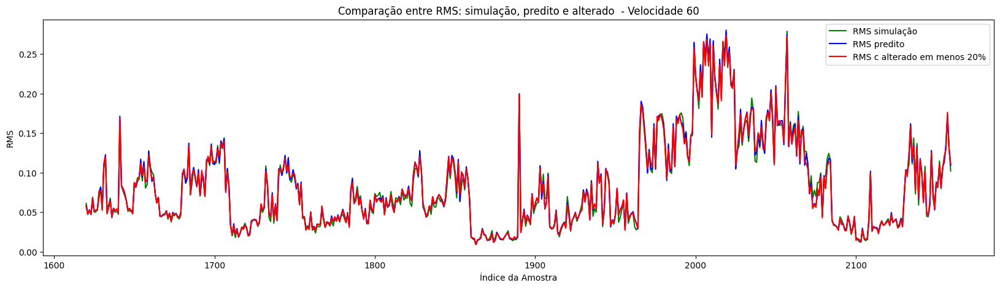

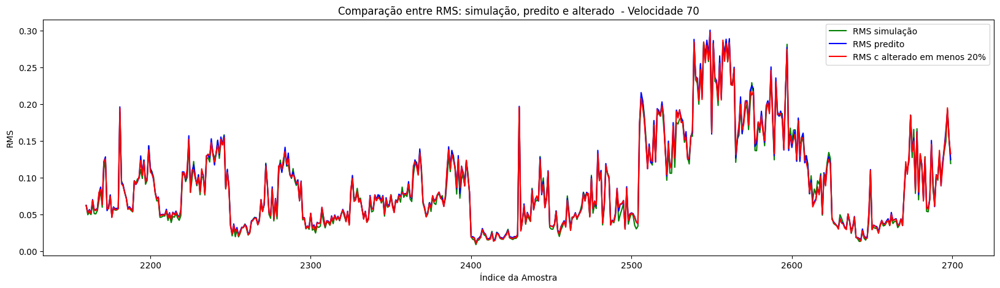

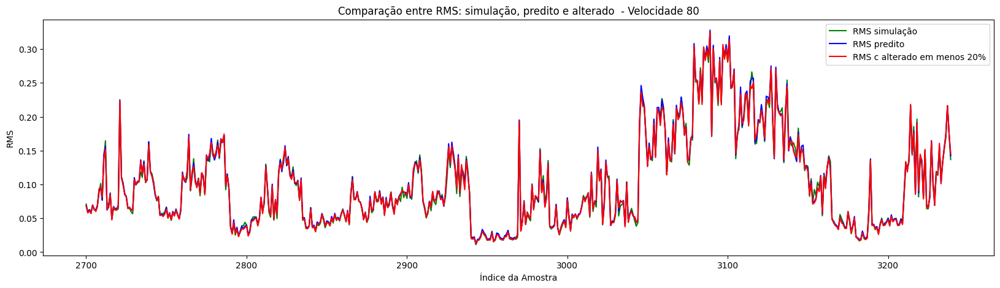

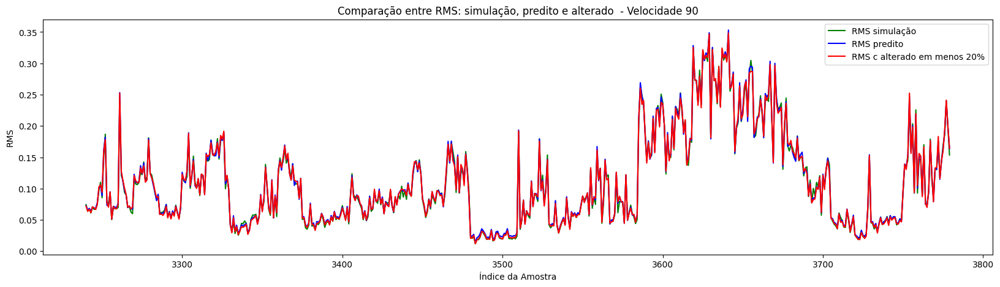

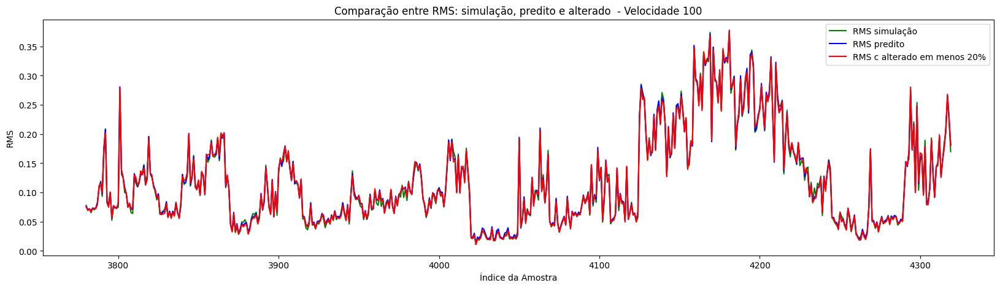

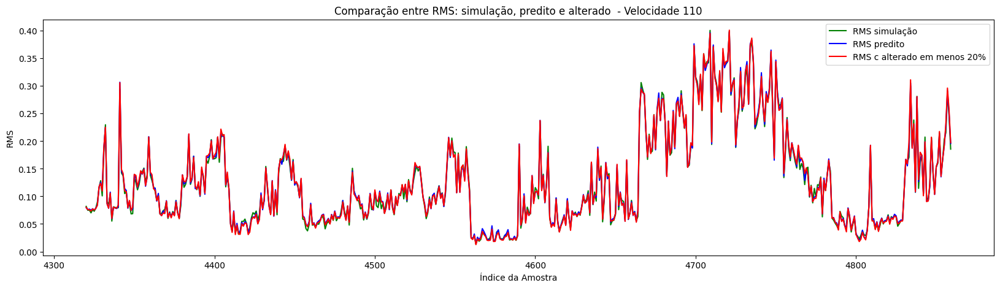

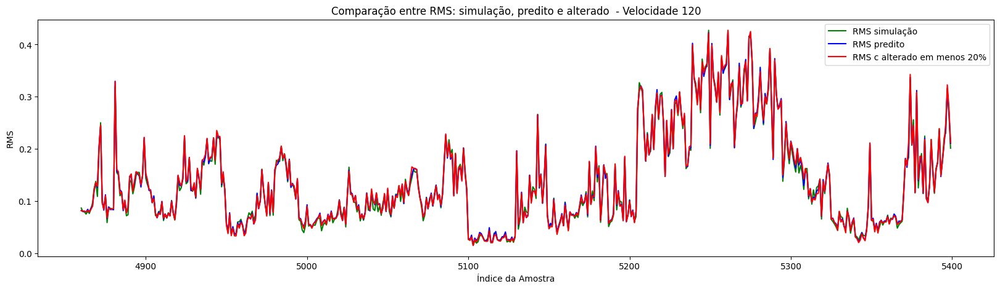

In [59]:
intervalo_total = 5400

num_subdivisoes = 10

tamanho_subdivisao = intervalo_total // num_subdivisoes

for i in range(num_subdivisoes):
    plt.figure(figsize=(20, 5))

    velocidade = 30 + i * 10

    inicio = i * tamanho_subdivisao
    fim = (i + 1) * tamanho_subdivisao

    plt.plot(range(inicio, fim), y_A_HB[inicio:fim], label='RMS simulação', color='green')
    plt.plot(range(inicio, fim), y_pred_A_HB[inicio:fim], label='RMS predito', color='blue')
    plt.plot(range(inicio, fim), y_pred_A_HB_c_menos_20[inicio:fim], label='RMS c alterado em menos 20%', color='red')
    plt.legend()
    plt.xlabel('Índice da Amostra')
    plt.ylabel('RMS')
    plt.title(f'Comparação entre RMS: simulação, predito e alterado  - Velocidade {velocidade}')
    plt.show()
    print('\n')

## Variações ms

### -10%

In [60]:
X_A_HB_ms_menos_10 = X_A_HB.copy()

X_A_HB_ms_menos_10['ms'] = 0.080898

In [61]:
y_pred_A_HB_ms_menos_10 = modelo.predict(X_A_HB_ms_menos_10)

169/169 [==============================] - 0s 3ms/step


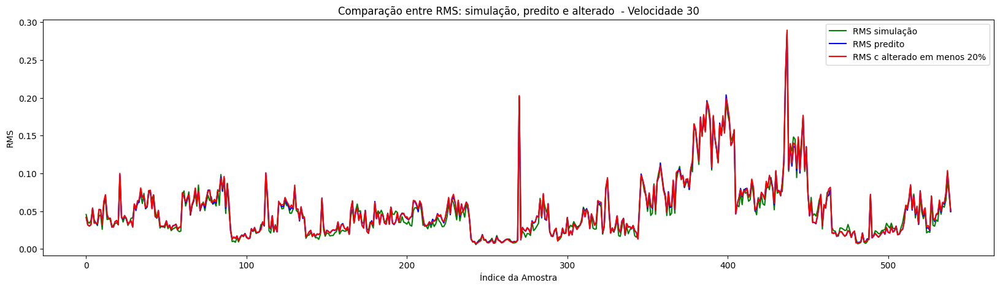

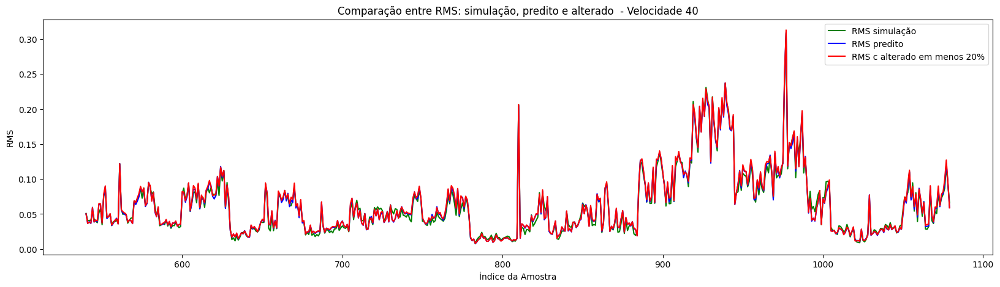

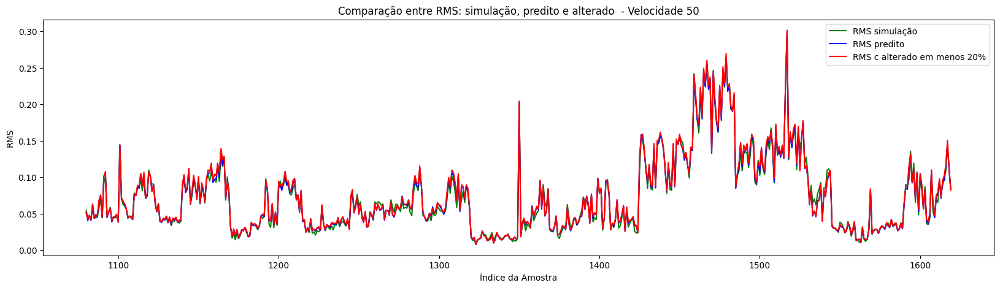

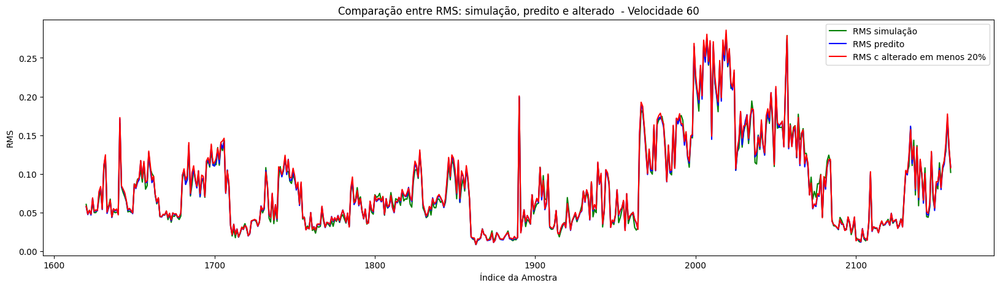

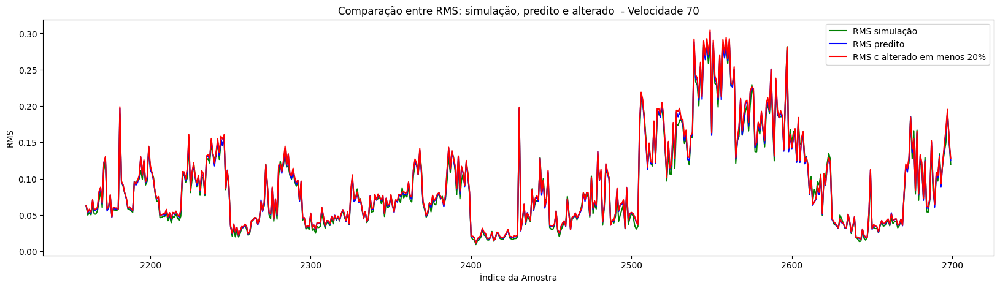

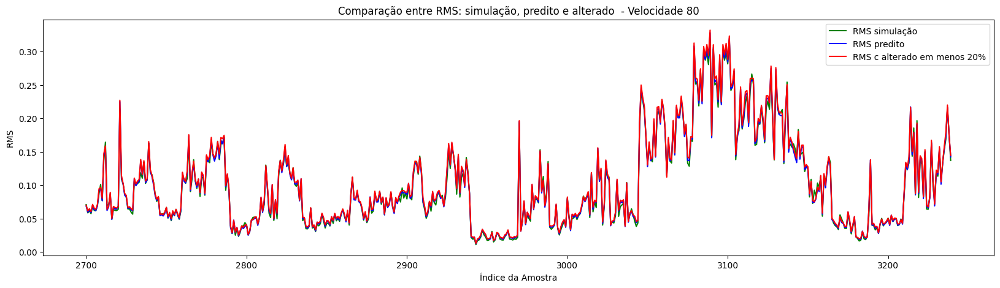

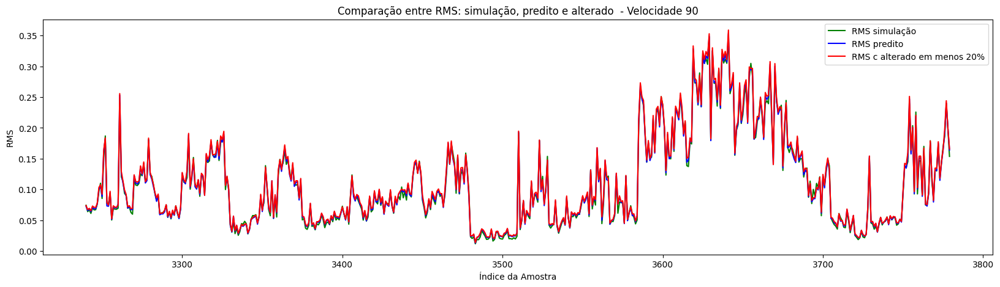

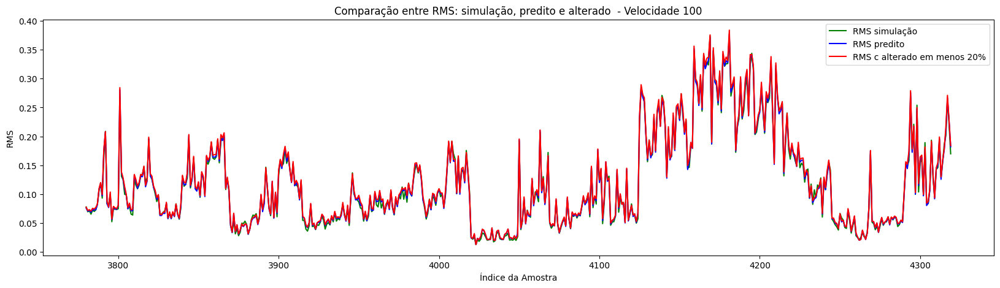

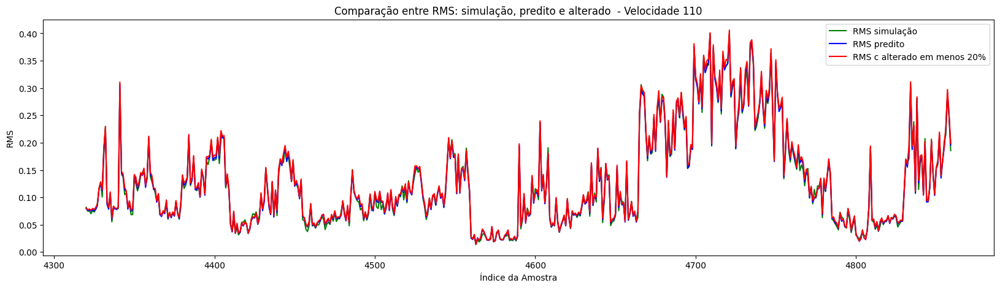

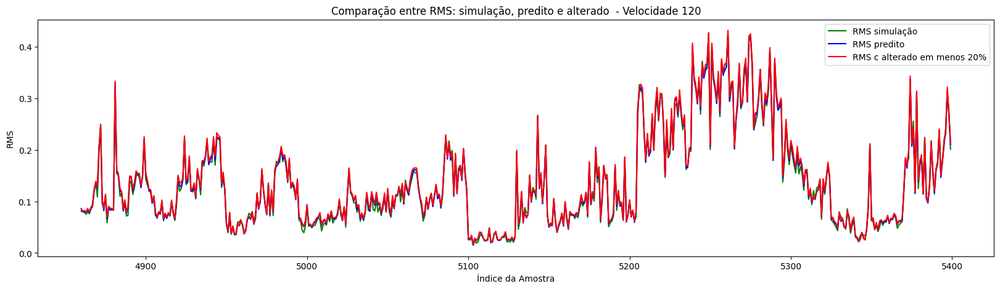

In [62]:
intervalo_total = 5400

num_subdivisoes = 10

tamanho_subdivisao = intervalo_total // num_subdivisoes

for i in range(num_subdivisoes):
    plt.figure(figsize=(20, 5))

    velocidade = 30 + i * 10

    inicio = i * tamanho_subdivisao
    fim = (i + 1) * tamanho_subdivisao

    plt.plot(range(inicio, fim), y_A_HB[inicio:fim], label='RMS simulação', color='green')
    plt.plot(range(inicio, fim), y_pred_A_HB[inicio:fim], label='RMS predito', color='blue')
    plt.plot(range(inicio, fim), y_pred_A_HB_ms_menos_10[inicio:fim], label='RMS c alterado em menos 20%', color='red')
    plt.legend()
    plt.xlabel('Índice da Amostra')
    plt.ylabel('RMS')
    plt.title(f'Comparação entre RMS: simulação, predito e alterado  - Velocidade {velocidade}')
    plt.show()
    print('\n')

### -20%

In [63]:
X_A_HB_ms_menos_20 = X_A_HB.copy()

X_A_HB_ms_menos_20['ms'] = 0.040443

In [64]:
y_pred_A_HB_ms_menos_20 = modelo.predict(X_A_HB_ms_menos_20)

169/169 [==============================] - 0s 2ms/step


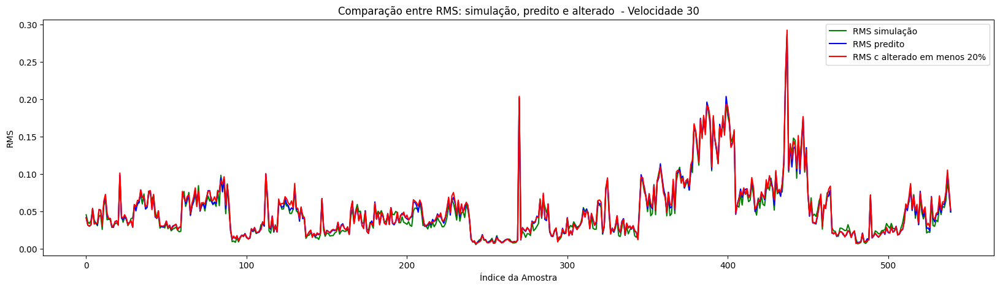

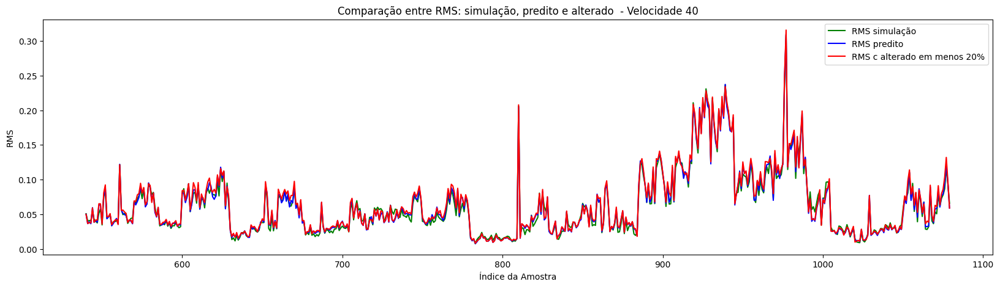

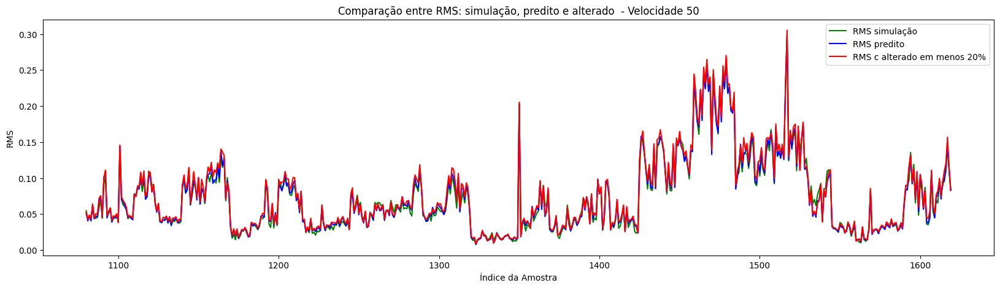

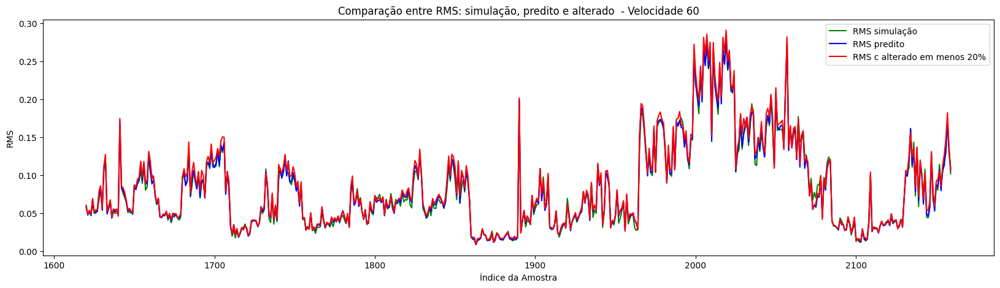

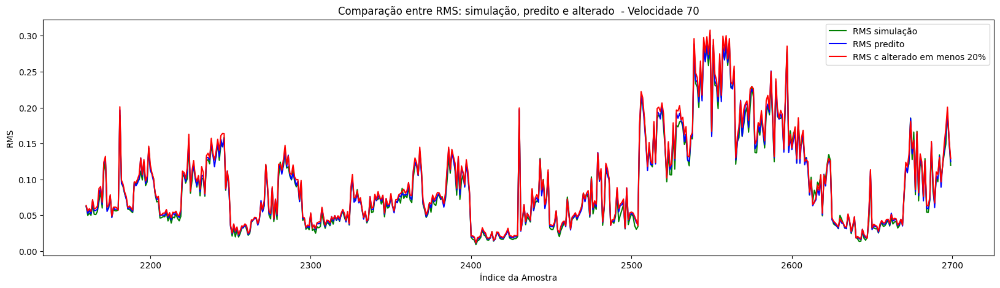

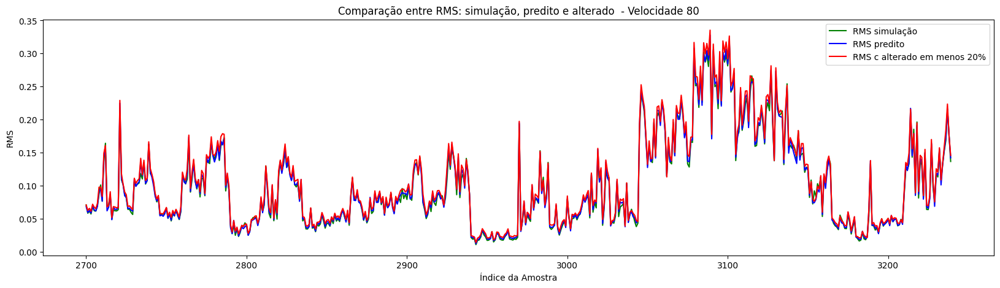

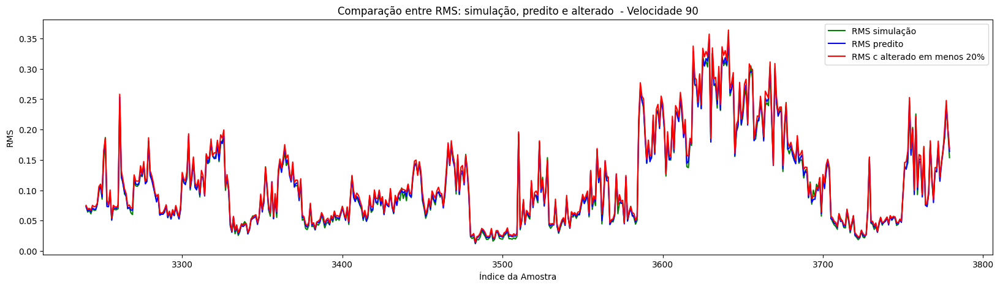

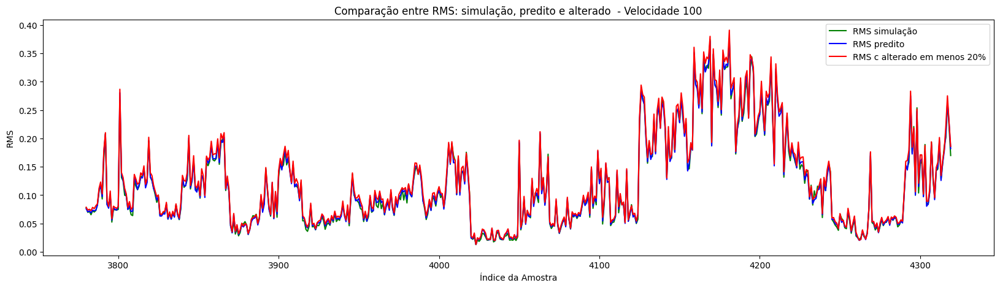

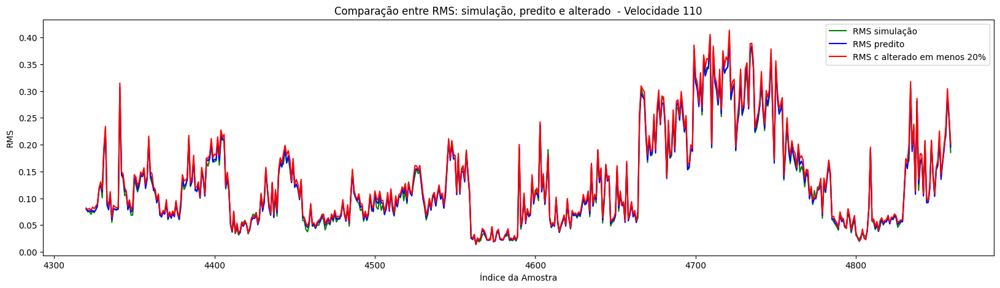

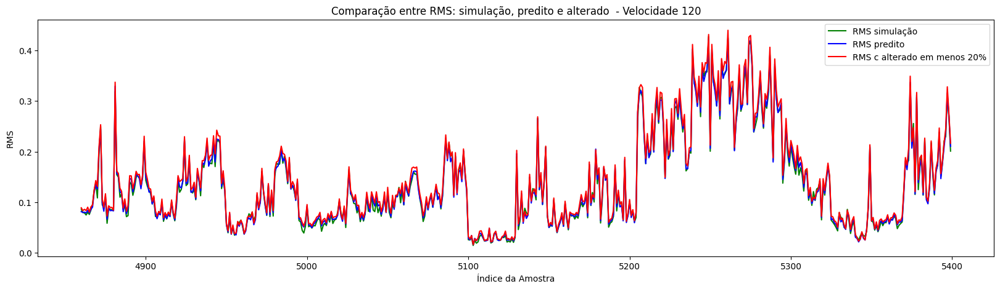

In [65]:
intervalo_total = 5400

num_subdivisoes = 10

tamanho_subdivisao = intervalo_total // num_subdivisoes

for i in range(num_subdivisoes):
    plt.figure(figsize=(20, 5))

    velocidade = 30 + i * 10

    inicio = i * tamanho_subdivisao
    fim = (i + 1) * tamanho_subdivisao

    plt.plot(range(inicio, fim), y_A_HB[inicio:fim], label='RMS simulação', color='green')
    plt.plot(range(inicio, fim), y_pred_A_HB[inicio:fim], label='RMS predito', color='blue')
    plt.plot(range(inicio, fim), y_pred_A_HB_ms_menos_20[inicio:fim], label='RMS c alterado em menos 20%', color='red')
    plt.legend()
    plt.xlabel('Índice da Amostra')
    plt.ylabel('RMS')
    plt.title(f'Comparação entre RMS: simulação, predito e alterado  - Velocidade {velocidade}')
    plt.show()
    print('\n')

### -30%

In [66]:
X_A_HB_ms_menos_30 = X_A_HB.copy()

X_A_HB_ms_menos_30['ms'] = 0

In [67]:
y_pred_A_HB_ms_menos_30 = modelo.predict(X_A_HB_ms_menos_30)

169/169 [==============================] - 1s 4ms/step


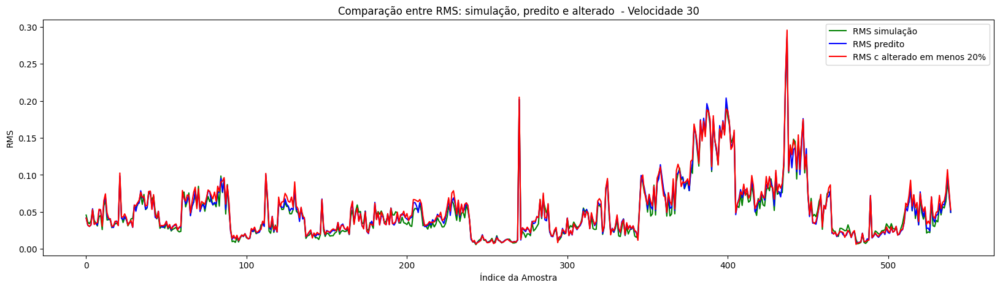

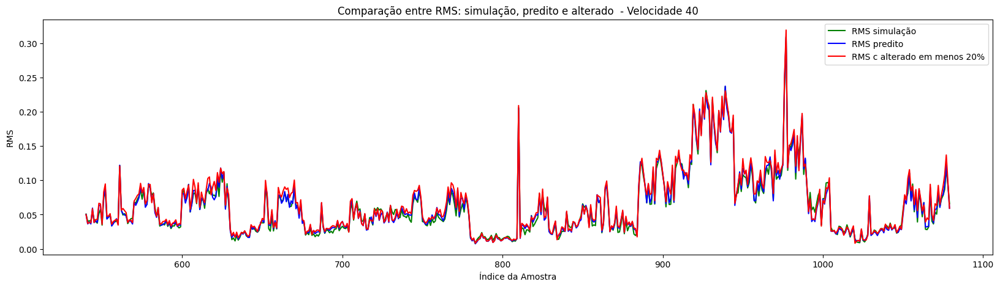

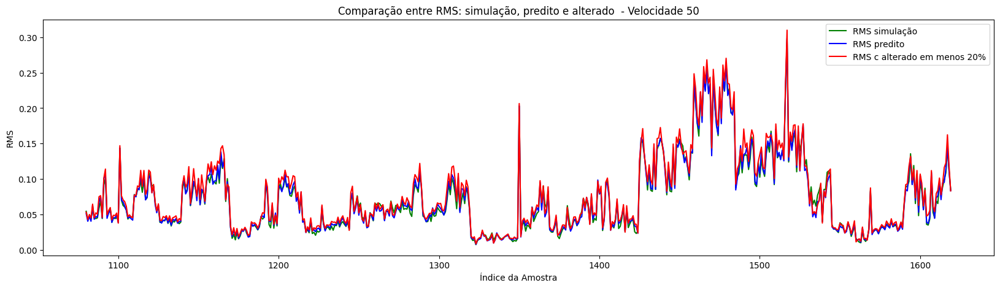

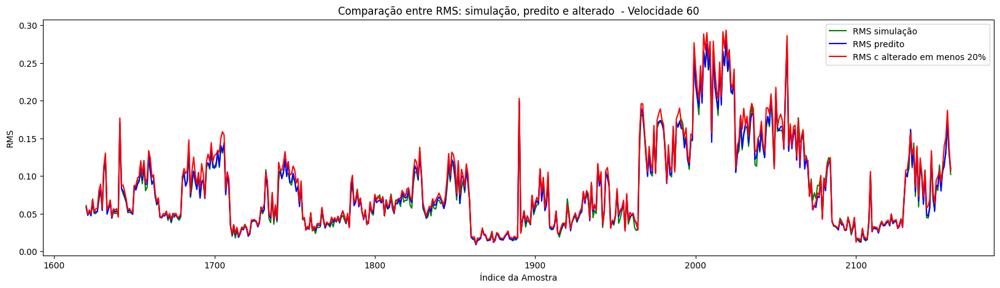

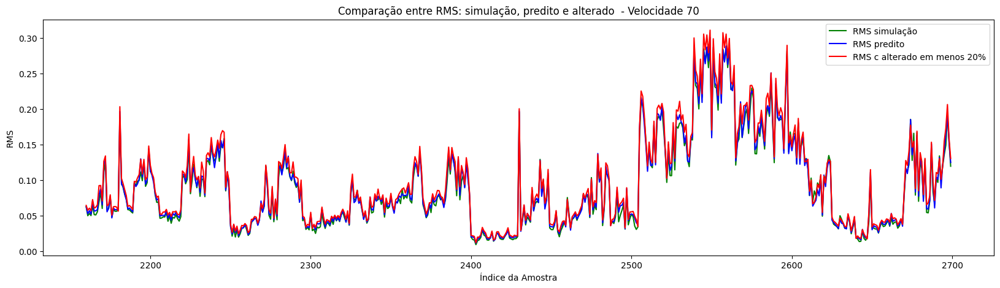

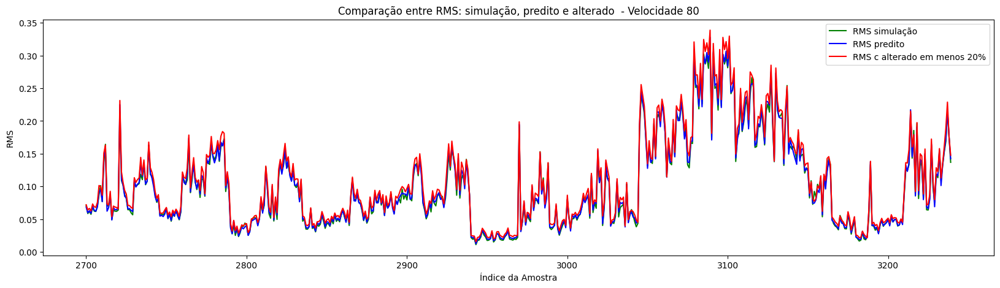

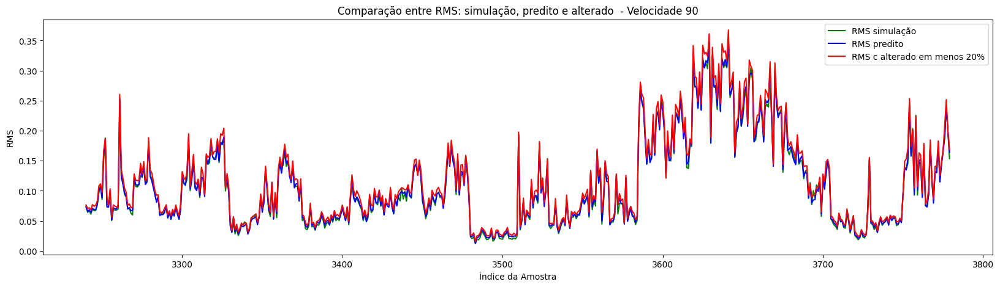

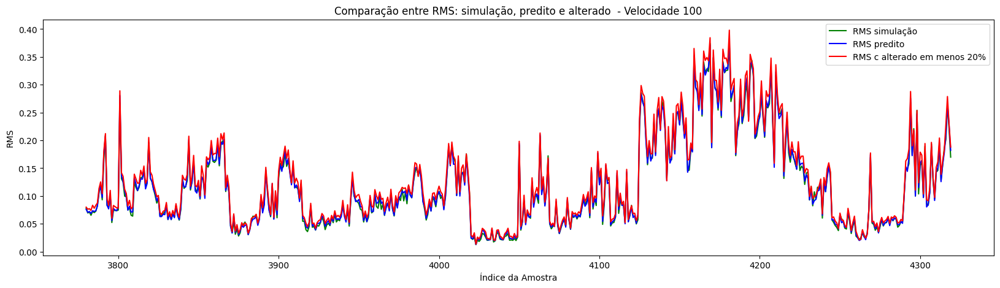

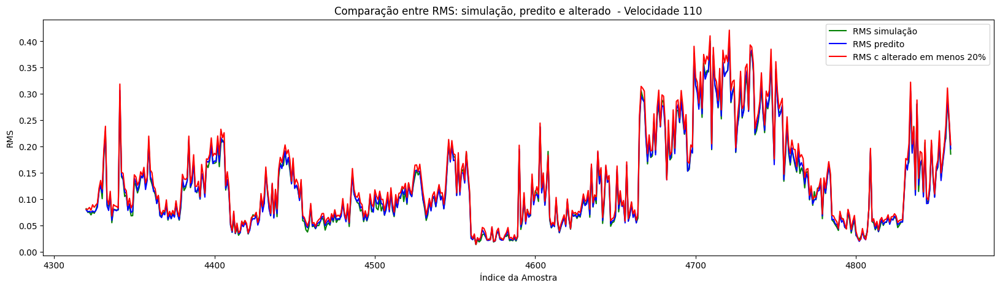

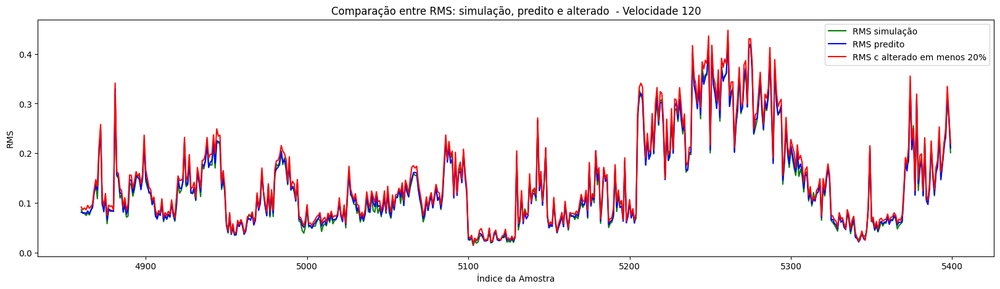

In [68]:
intervalo_total = 5400

num_subdivisoes = 10

tamanho_subdivisao = intervalo_total // num_subdivisoes

for i in range(num_subdivisoes):
    plt.figure(figsize=(20, 5))

    velocidade = 30 + i * 10

    inicio = i * tamanho_subdivisao
    fim = (i + 1) * tamanho_subdivisao

    plt.plot(range(inicio, fim), y_A_HB[inicio:fim], label='RMS simulação', color='green')
    plt.plot(range(inicio, fim), y_pred_A_HB[inicio:fim], label='RMS predito', color='blue')
    plt.plot(range(inicio, fim), y_pred_A_HB_ms_menos_30[inicio:fim], label='RMS c alterado em menos 20%', color='red')
    plt.legend()
    plt.xlabel('Índice da Amostra')
    plt.ylabel('RMS')
    plt.title(f'Comparação entre RMS: simulação, predito e alterado  - Velocidade {velocidade}')
    plt.show()
    print('\n')

### +10%

In [69]:
X_A_HB_ms_mais_10 = X_A_HB.copy()

X_A_HB_ms_mais_10['ms'] = 0.161775

In [70]:
y_pred_A_HB_ms_mais_10 = modelo.predict(X_A_HB_ms_mais_10)

169/169 [==============================] - 0s 2ms/step


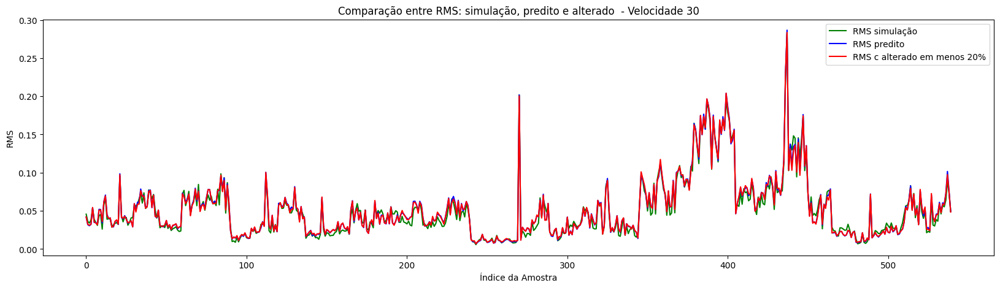

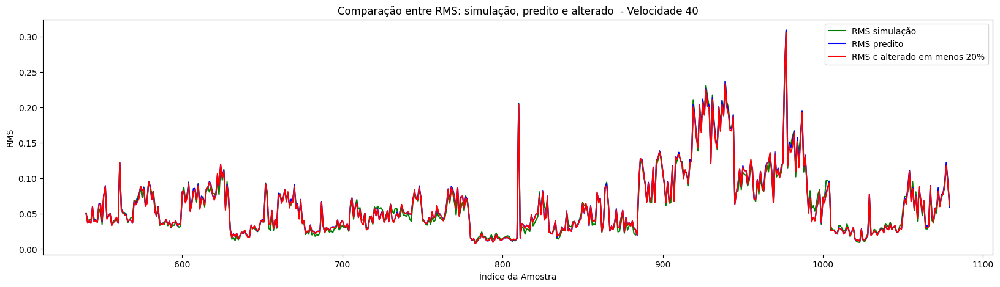

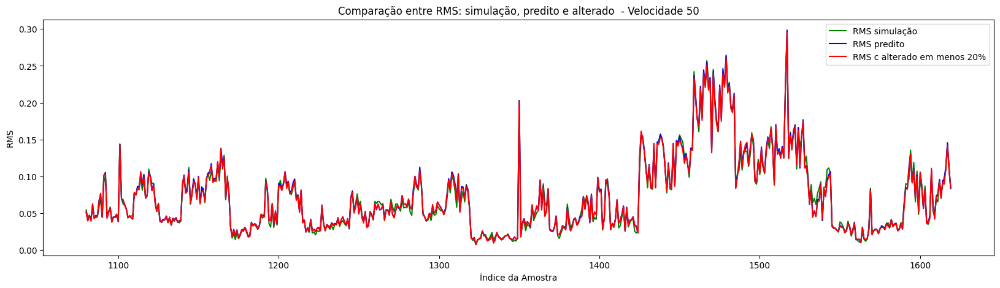

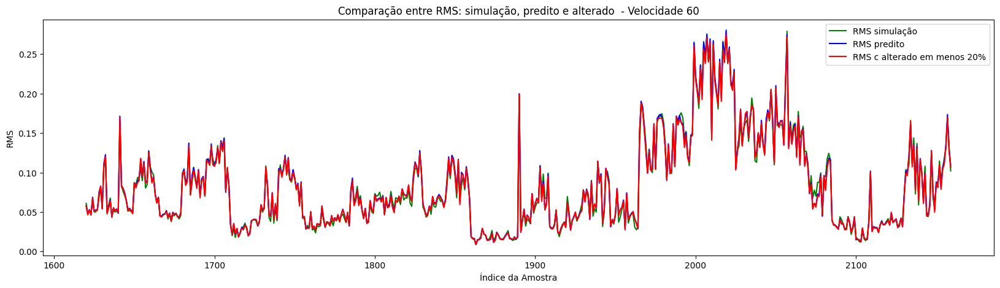

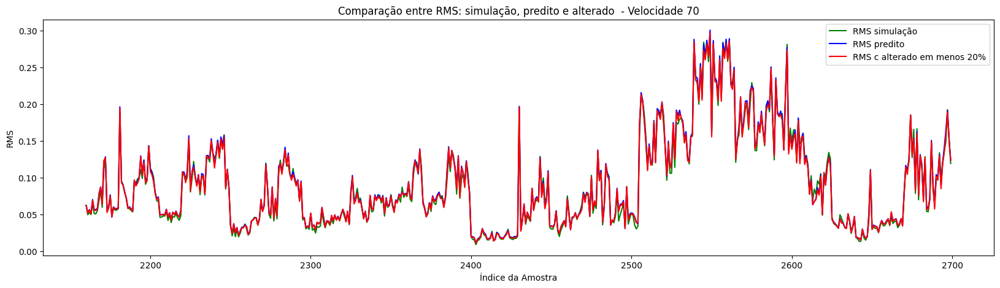

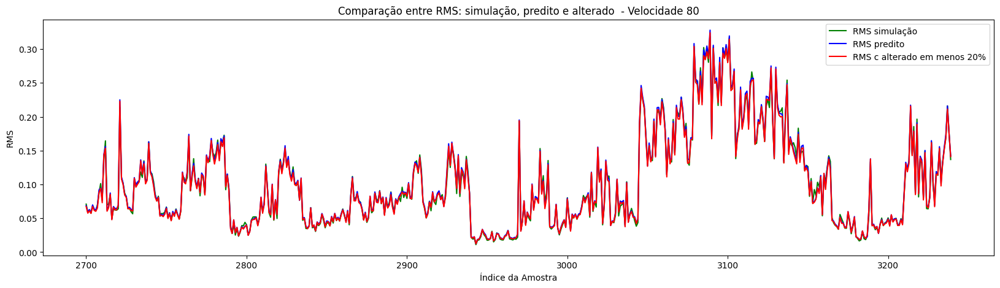

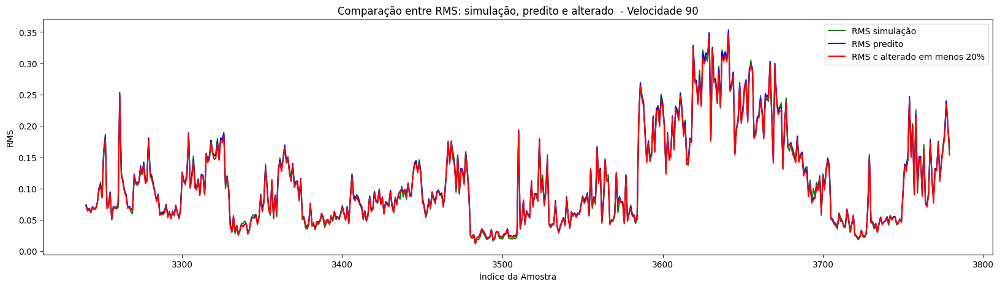

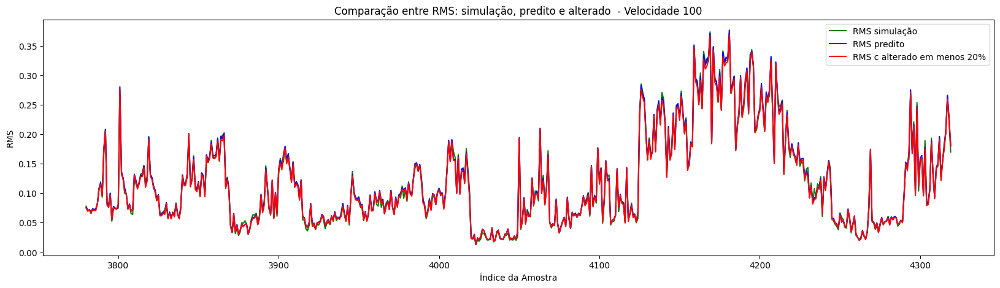

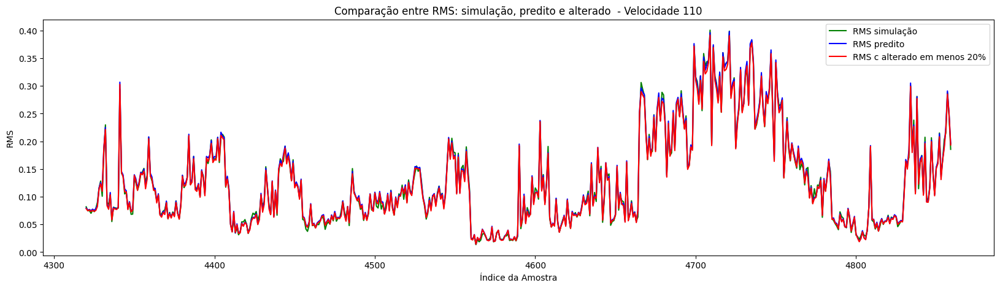

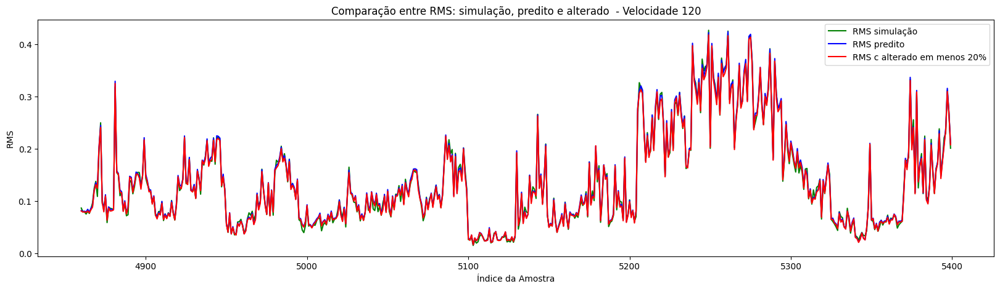

In [71]:
intervalo_total = 5400

num_subdivisoes = 10

tamanho_subdivisao = intervalo_total // num_subdivisoes

for i in range(num_subdivisoes):
    plt.figure(figsize=(20, 5))

    velocidade = 30 + i * 10

    inicio = i * tamanho_subdivisao
    fim = (i + 1) * tamanho_subdivisao

    plt.plot(range(inicio, fim), y_A_HB[inicio:fim], label='RMS simulação', color='green')
    plt.plot(range(inicio, fim), y_pred_A_HB[inicio:fim], label='RMS predito', color='blue')
    plt.plot(range(inicio, fim), y_pred_A_HB_ms_mais_10[inicio:fim], label='RMS c alterado em menos 20%', color='red')
    plt.legend()
    plt.xlabel('Índice da Amostra')
    plt.ylabel('RMS')
    plt.title(f'Comparação entre RMS: simulação, predito e alterado  - Velocidade {velocidade}')
    plt.show()
    print('\n')

### +20%

In [73]:
X_A_HB_ms_mais_20 = X_A_HB.copy()

X_A_HB_ms_mais_20['ms'] = 0.202219

In [74]:
y_pred_A_HB_ms_mais_20 = modelo.predict(X_A_HB_ms_mais_20)

169/169 [==============================] - 0s 2ms/step


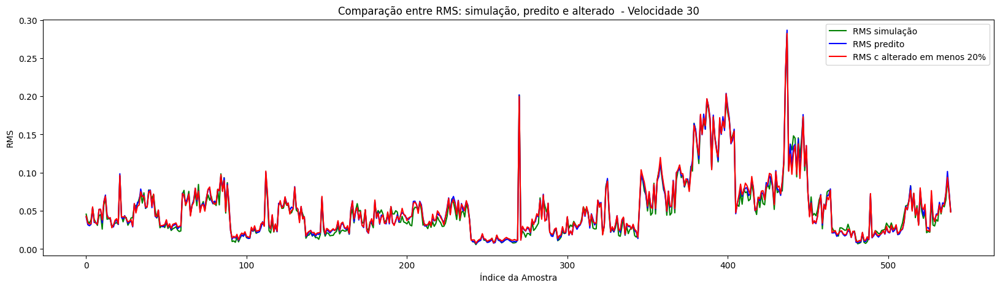

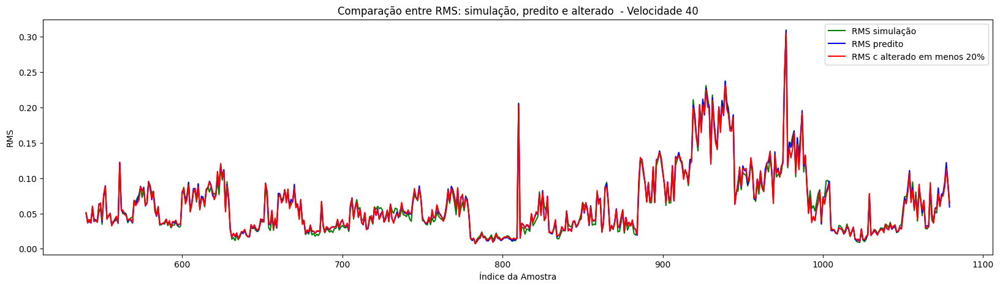

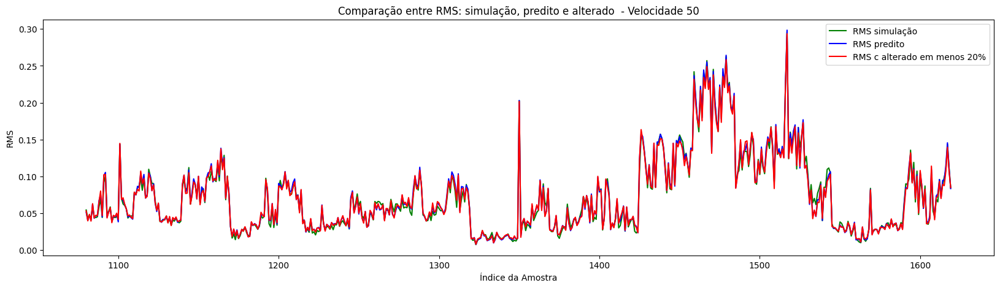

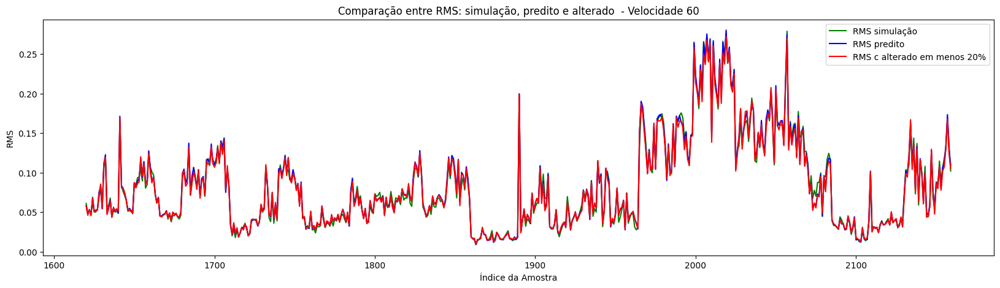

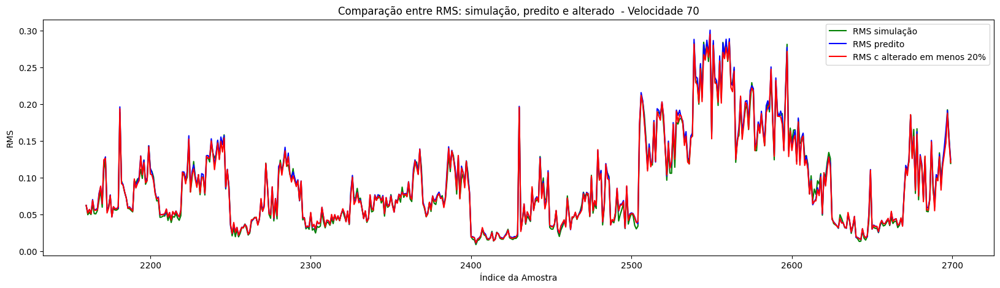

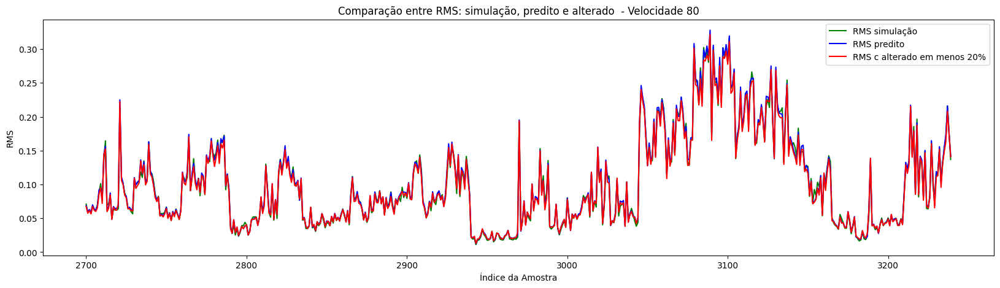

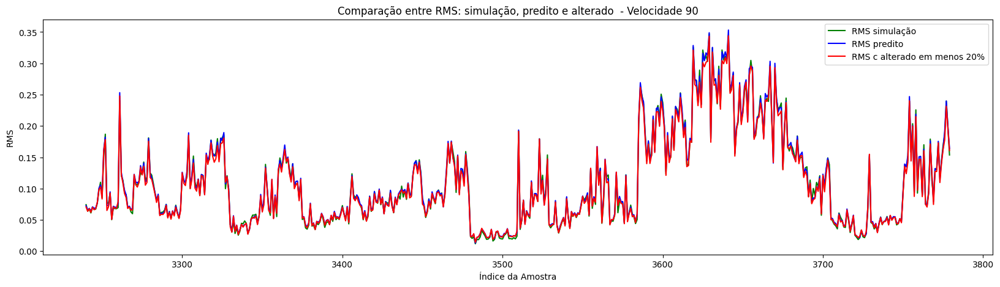

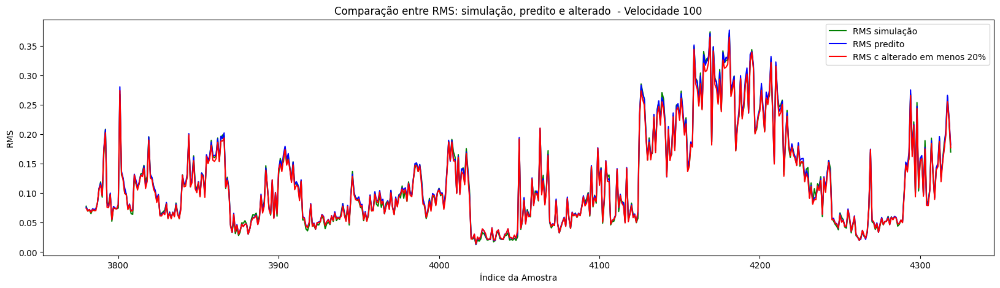

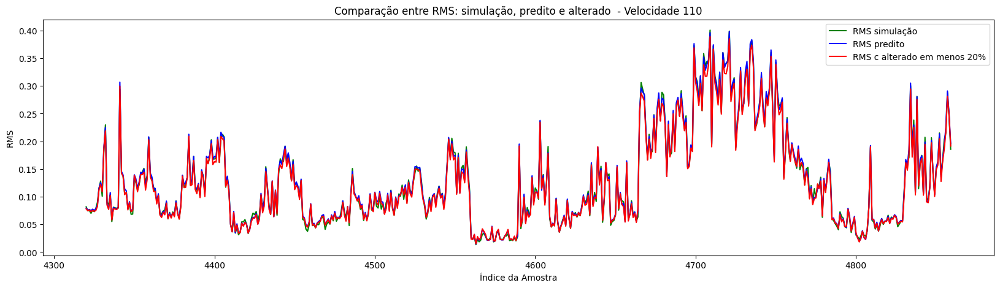

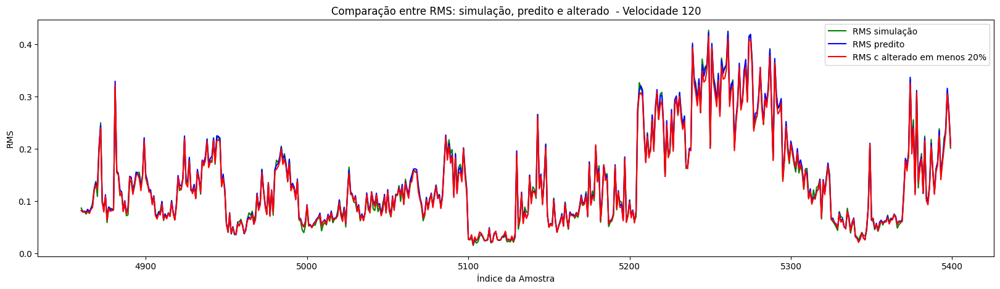

In [75]:
intervalo_total = 5400

num_subdivisoes = 10

tamanho_subdivisao = intervalo_total // num_subdivisoes

for i in range(num_subdivisoes):
    plt.figure(figsize=(20, 5))

    velocidade = 30 + i * 10

    inicio = i * tamanho_subdivisao
    fim = (i + 1) * tamanho_subdivisao

    plt.plot(range(inicio, fim), y_A_HB[inicio:fim], label='RMS simulação', color='green')
    plt.plot(range(inicio, fim), y_pred_A_HB[inicio:fim], label='RMS predito', color='blue')
    plt.plot(range(inicio, fim), y_pred_A_HB_ms_mais_20[inicio:fim], label='RMS c alterado em menos 20%', color='red')
    plt.legend()
    plt.xlabel('Índice da Amostra')
    plt.ylabel('RMS')
    plt.title(f'Comparação entre RMS: simulação, predito e alterado  - Velocidade {velocidade}')
    plt.show()
    print('\n')

### +30%

In [78]:
X_A_HB_ms_mais_30 = X_A_HB.copy()

X_A_HB_ms_mais_30['ms'] = 0.243963

In [79]:
y_pred_A_HB_ms_mais_30 = modelo.predict(X_A_HB_ms_mais_30)

169/169 [==============================] - 1s 6ms/step


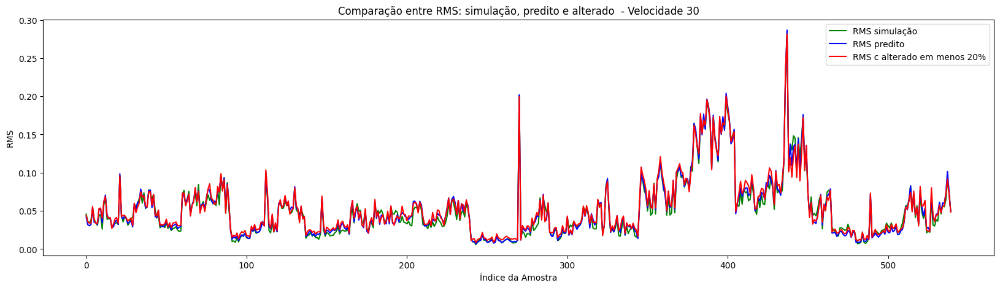

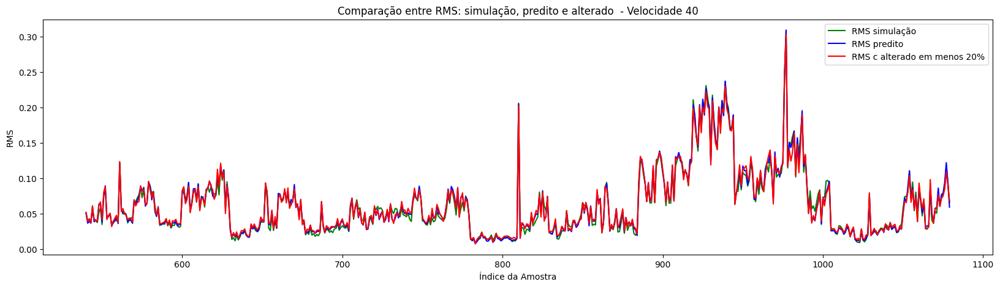

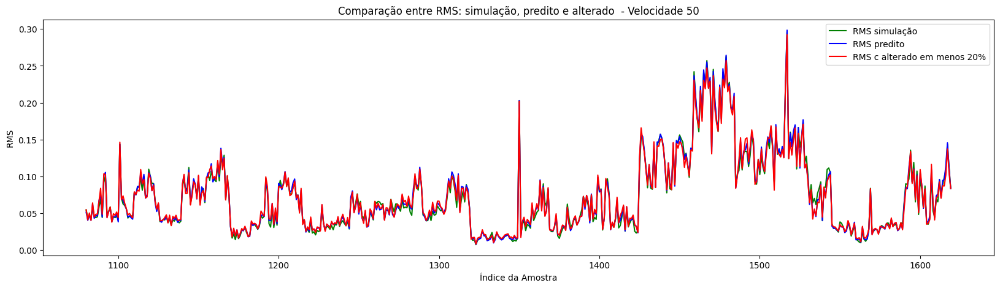

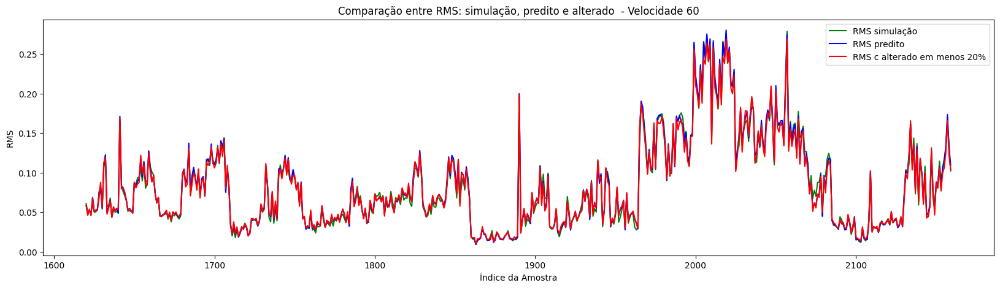

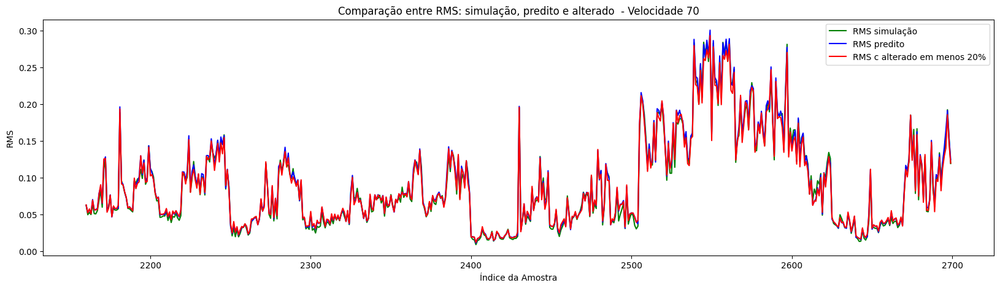

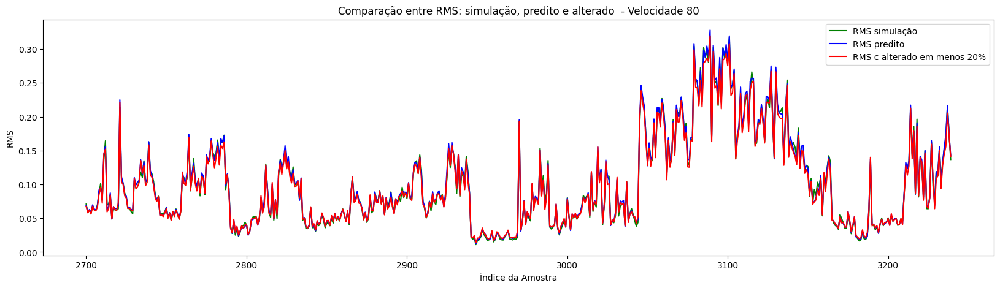

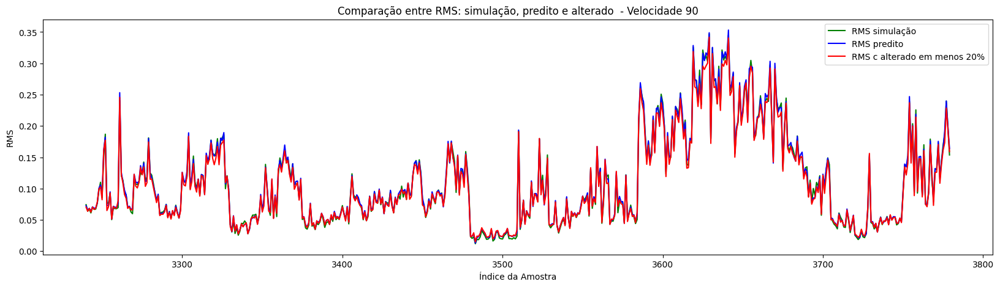

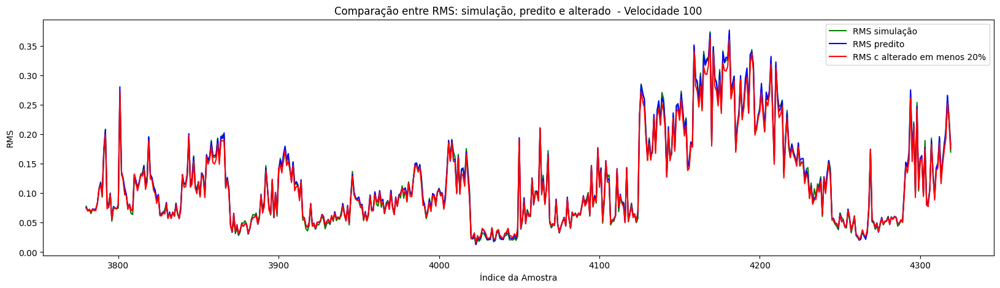

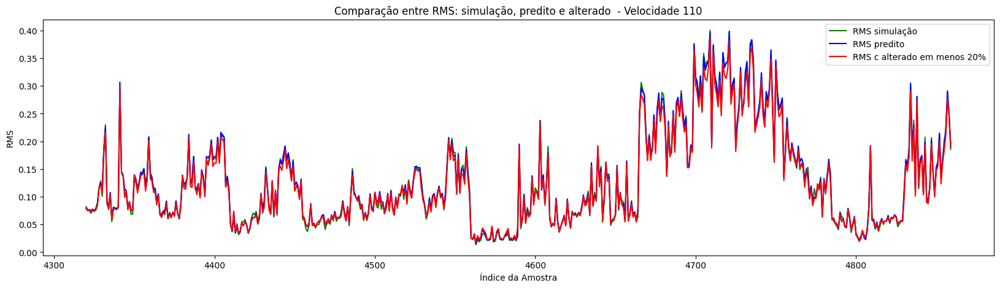

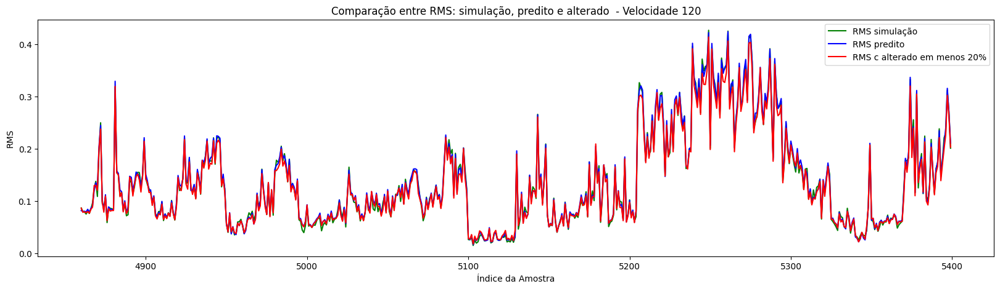

In [80]:
intervalo_total = 5400

num_subdivisoes = 10

tamanho_subdivisao = intervalo_total // num_subdivisoes

for i in range(num_subdivisoes):
    plt.figure(figsize=(20, 5))

    velocidade = 30 + i * 10

    inicio = i * tamanho_subdivisao
    fim = (i + 1) * tamanho_subdivisao

    plt.plot(range(inicio, fim), y_A_HB[inicio:fim], label='RMS simulação', color='green')
    plt.plot(range(inicio, fim), y_pred_A_HB[inicio:fim], label='RMS predito', color='blue')
    plt.plot(range(inicio, fim), y_pred_A_HB_ms_mais_30[inicio:fim], label='RMS c alterado em menos 20%', color='red')
    plt.legend()
    plt.xlabel('Índice da Amostra')
    plt.ylabel('RMS')
    plt.title(f'Comparação entre RMS: simulação, predito e alterado  - Velocidade {velocidade}')
    plt.show()
    print('\n')

# Grafico todos os veiculos

### A-HB

In [28]:
y_A_HB = df_A_HB.iloc[:, 0]

X_A_HB = df_A_HB.iloc[:, 1:12]

y_pred_A_HB = modelo.predict(X_A_HB)

169/169 [==============================] - 1s 3ms/step


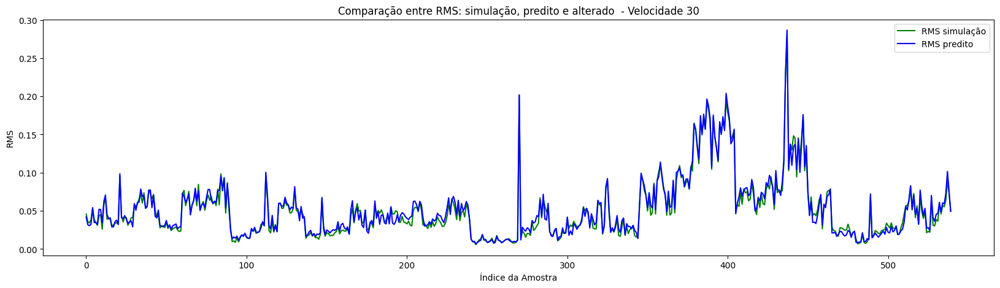

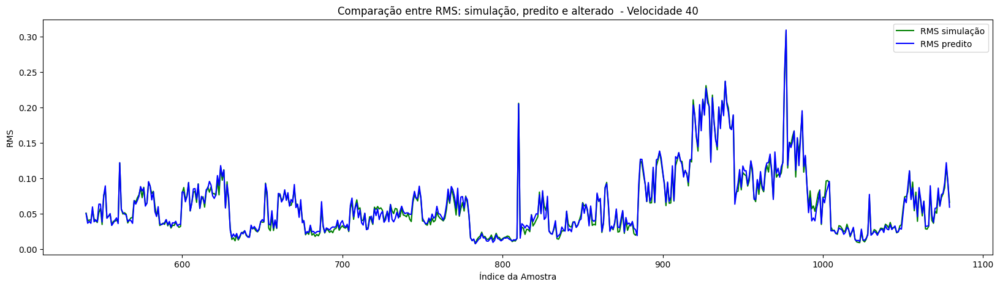

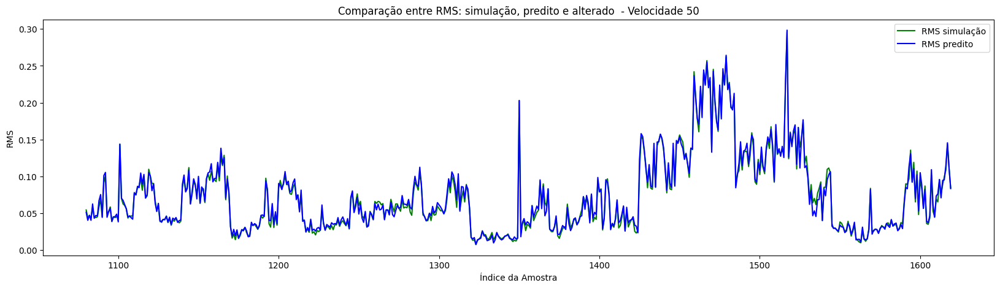

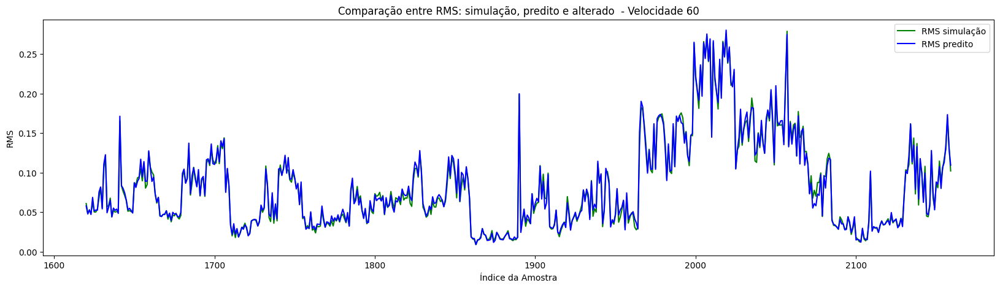

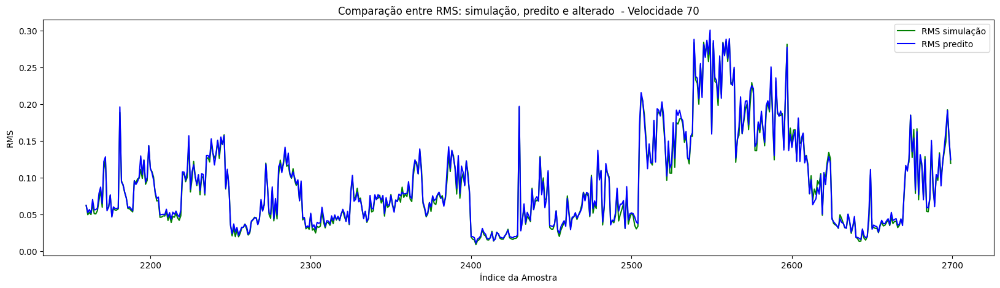

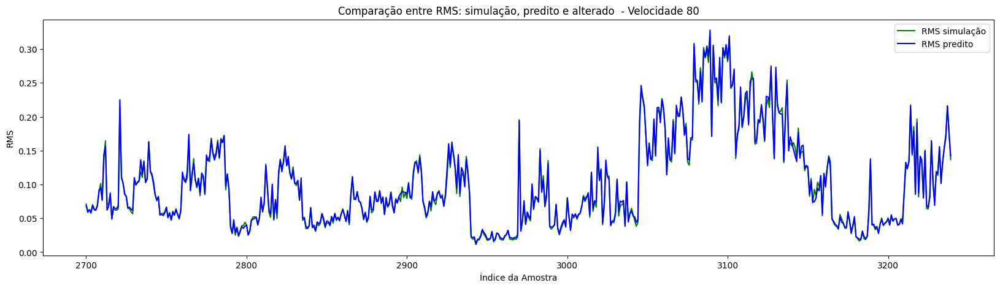

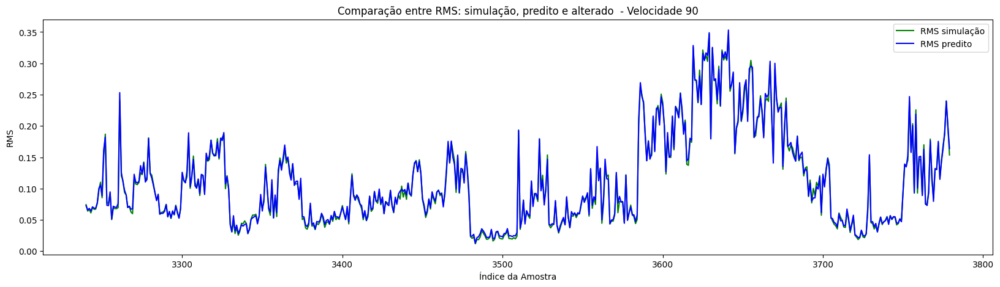

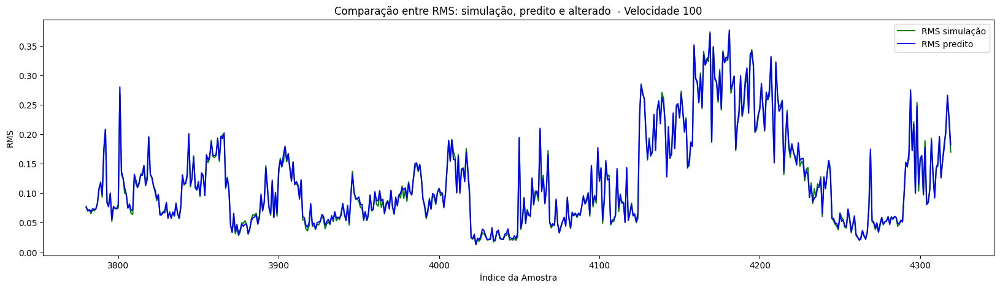

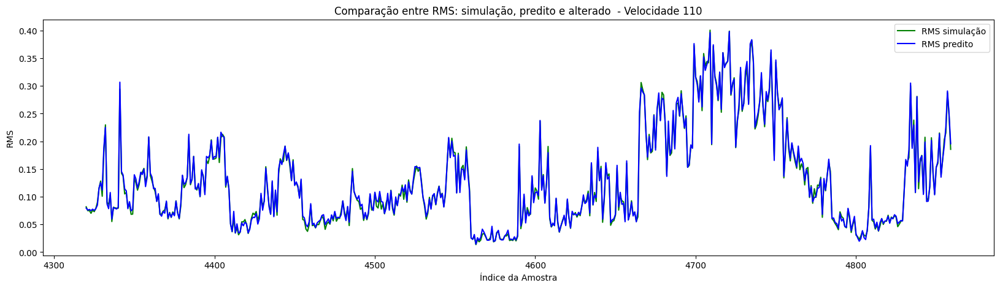

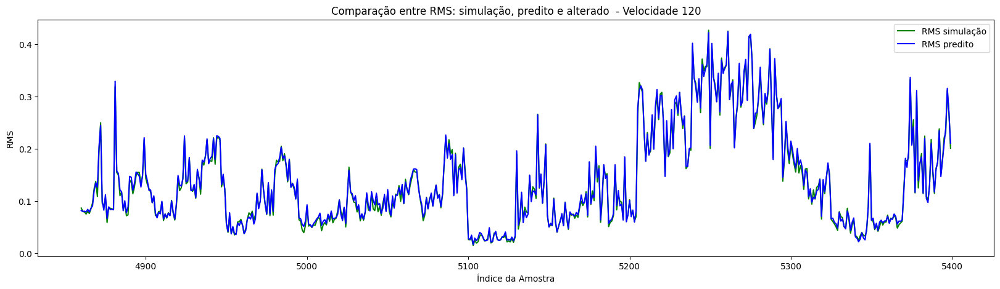

In [29]:
intervalo_total = 5400

num_subdivisoes = 10

tamanho_subdivisao = intervalo_total // num_subdivisoes

for i in range(num_subdivisoes):
    plt.figure(figsize=(20, 5))

    velocidade = 30 + i * 10

    inicio = i * tamanho_subdivisao
    fim = (i + 1) * tamanho_subdivisao

    plt.plot(range(inicio, fim), y_A_HB[inicio:fim], label='RMS simulação', color='green')
    plt.plot(range(inicio, fim), y_pred_A_HB[inicio:fim], label='RMS predito', color='blue')
    plt.legend()
    plt.xlabel('Índice da Amostra')
    plt.ylabel('RMS')
    plt.title(f'Comparação entre RMS: simulação, predito e alterado  - Velocidade {velocidade}')
    plt.show()
    print('\n')

### B-HB

In [ ]:
y_B_HB = df_B_HB.iloc[:, 0]

X_B_HB = df_B_HB.iloc[:, 1:8]

y_pred_B_HB = modelo.predict(X_B_HB)

169/169 [==============================] - 0s 3ms/step


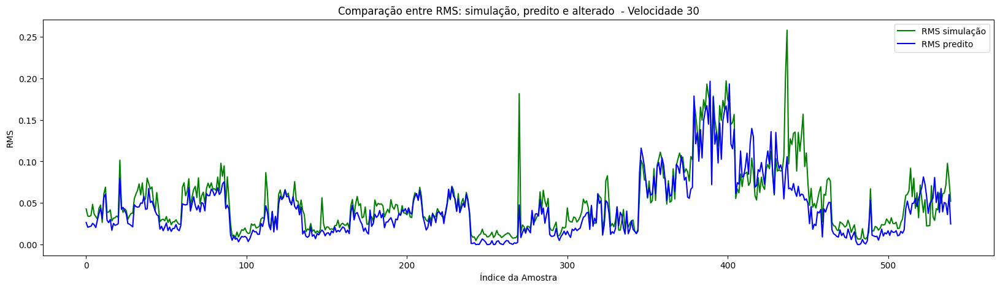

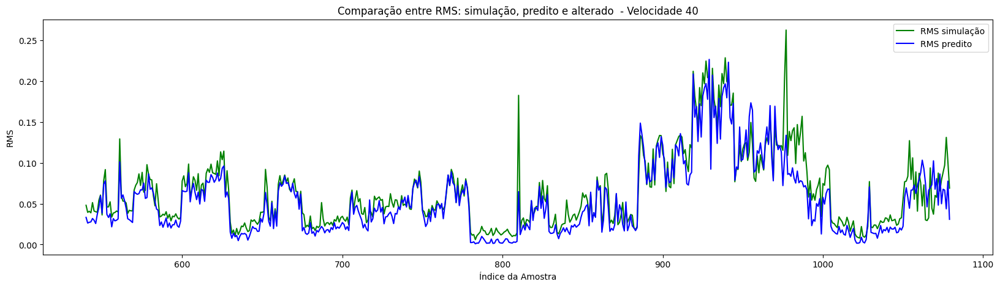

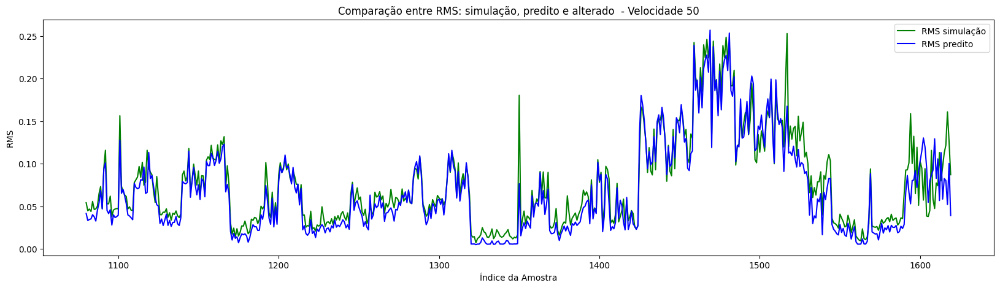

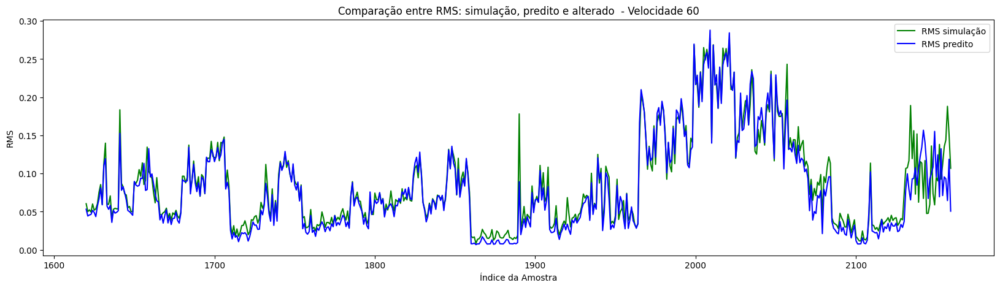

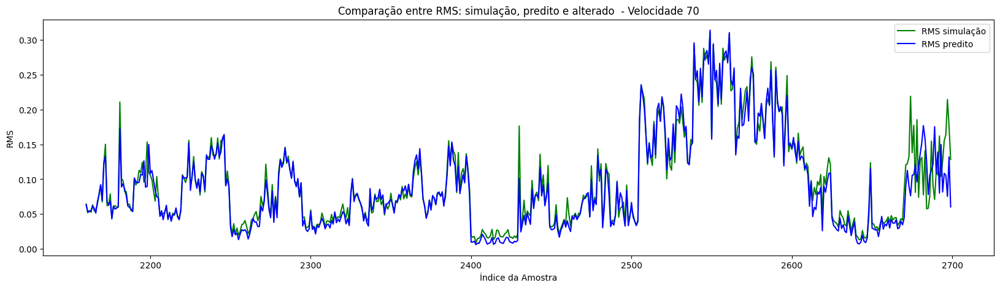

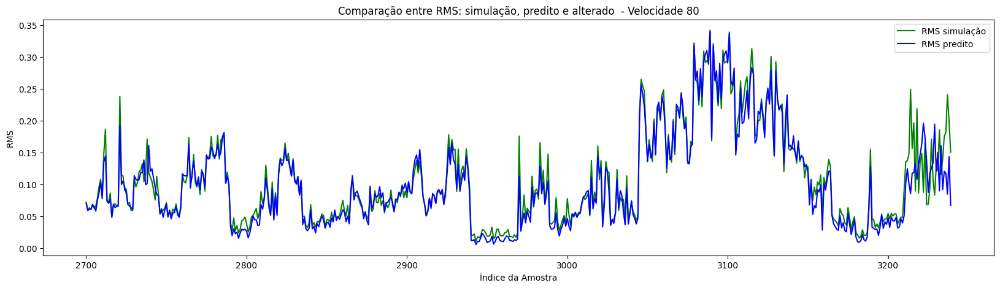

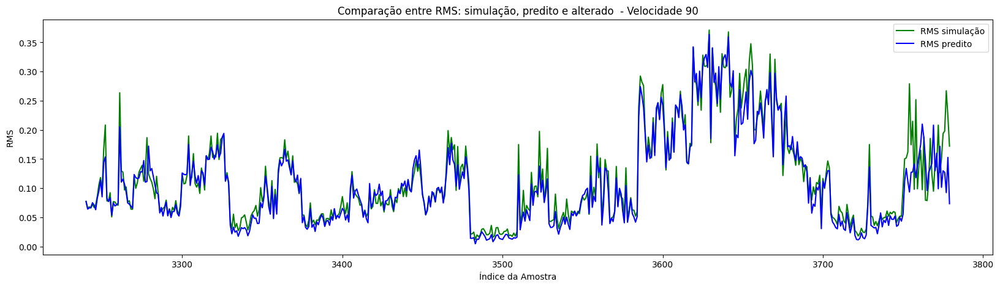

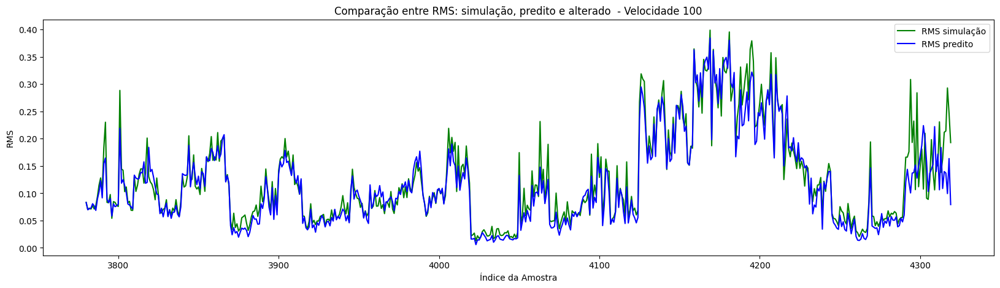

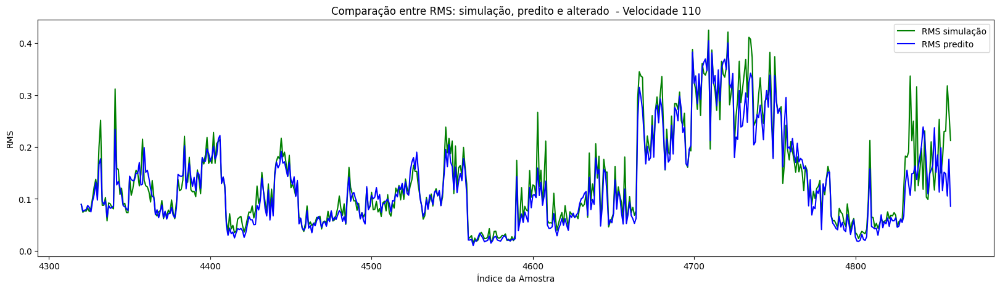

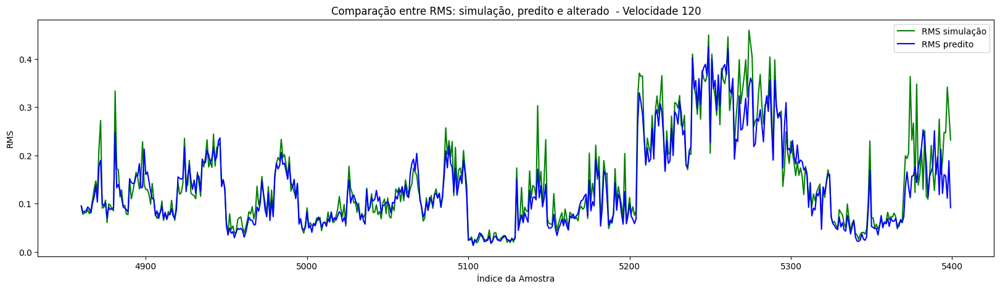

In [ ]:
intervalo_total = 5400

num_subdivisoes = 10

tamanho_subdivisao = intervalo_total // num_subdivisoes

for i in range(num_subdivisoes):
    plt.figure(figsize=(20, 5))

    velocidade = 30 + i * 10

    inicio = i * tamanho_subdivisao
    fim = (i + 1) * tamanho_subdivisao

    plt.plot(range(inicio, fim), y_B_HB[inicio:fim], label='RMS simulação', color='green')
    plt.plot(range(inicio, fim), y_pred_B_HB[inicio:fim], label='RMS predito', color='blue')
    plt.legend()
    plt.xlabel('Índice da Amostra')
    plt.ylabel('RMS')
    plt.title(f'Comparação entre RMS: simulação, predito e alterado  - Velocidade {velocidade}')
    plt.show()
    print('\n')

### C-HB

In [ ]:
y_C_HB = df_C_HB.iloc[:, 0]

X_C_HB = df_C_HB.iloc[:, 1:8]

y_pred_C_HB = modelo.predict(X_C_HB)

169/169 [==============================] - 0s 2ms/step


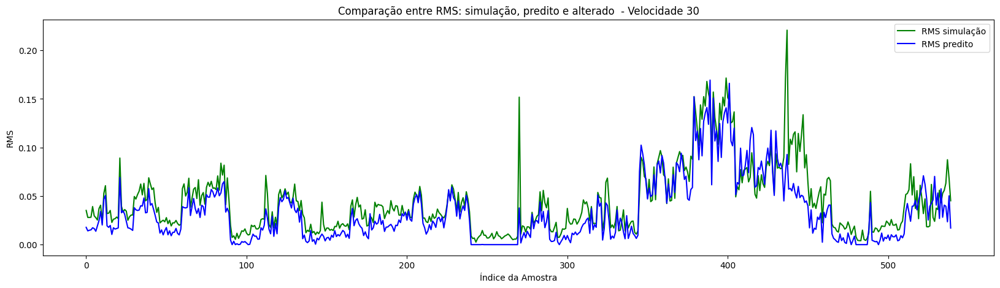

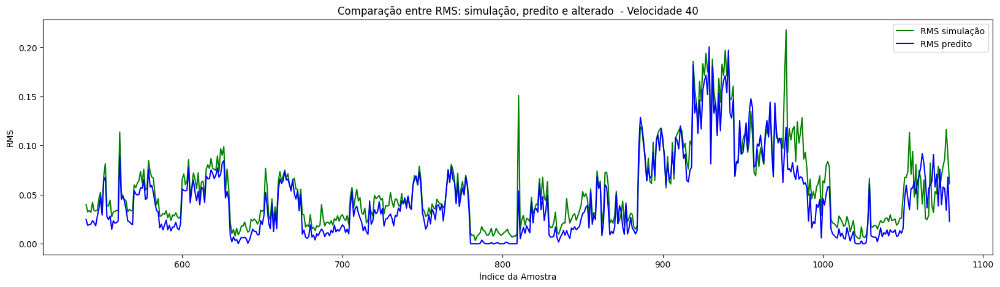

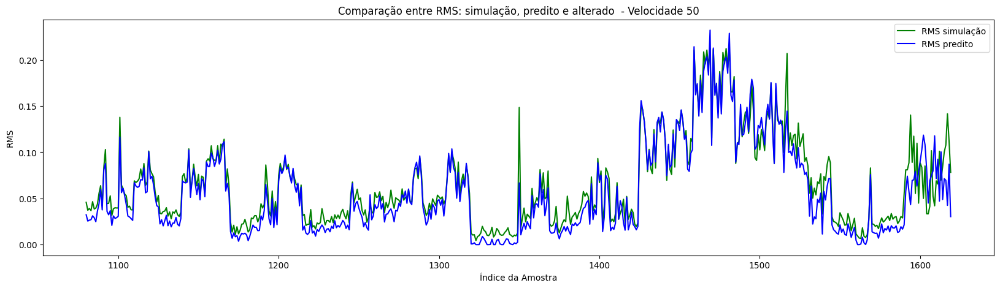

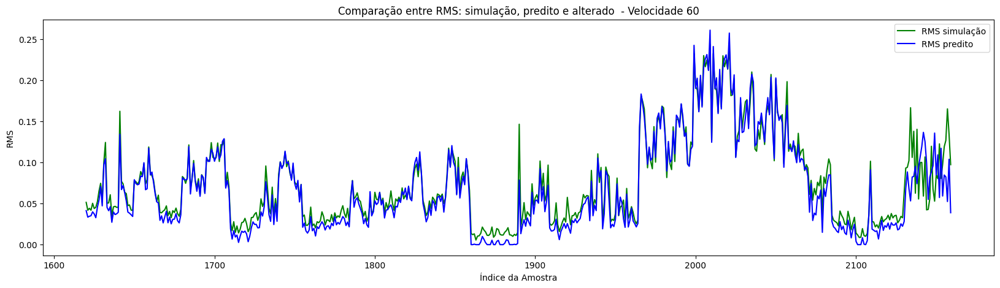

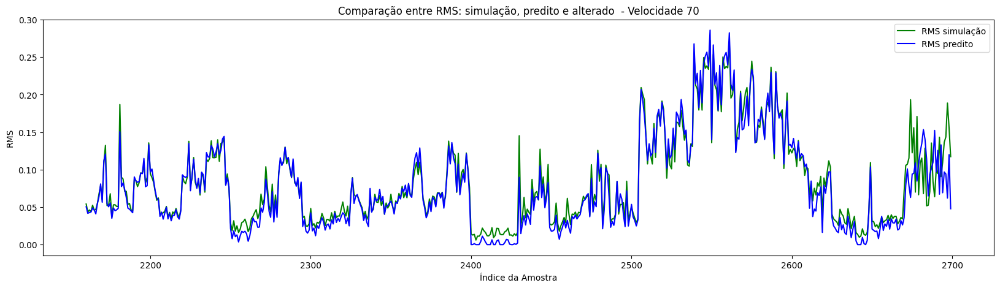

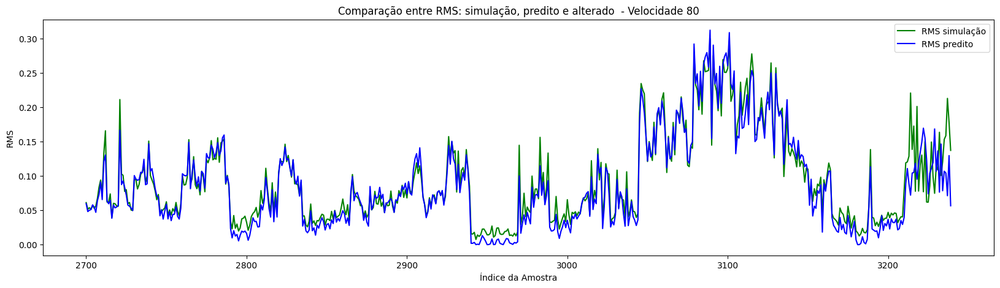

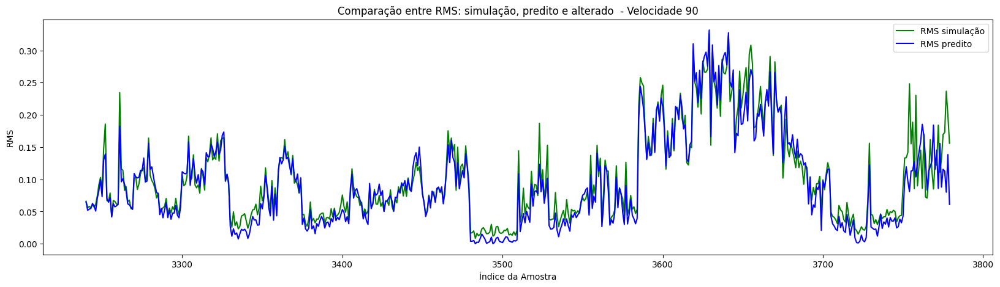

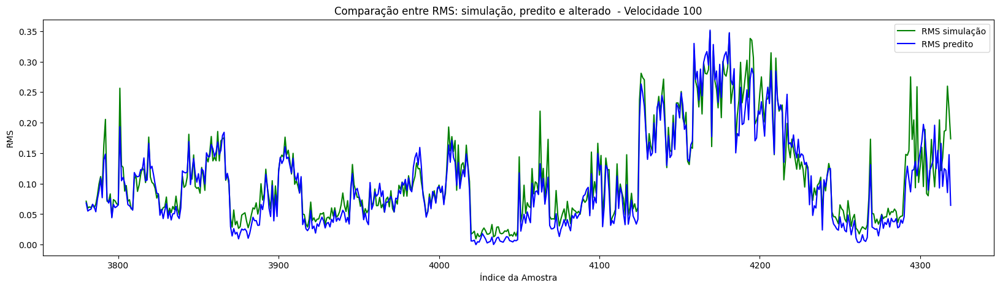

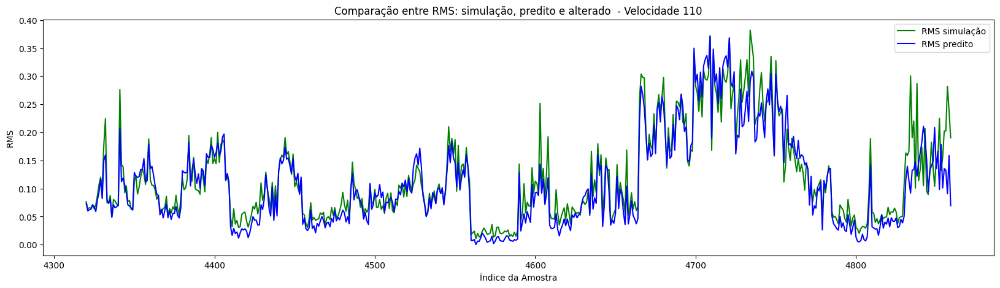

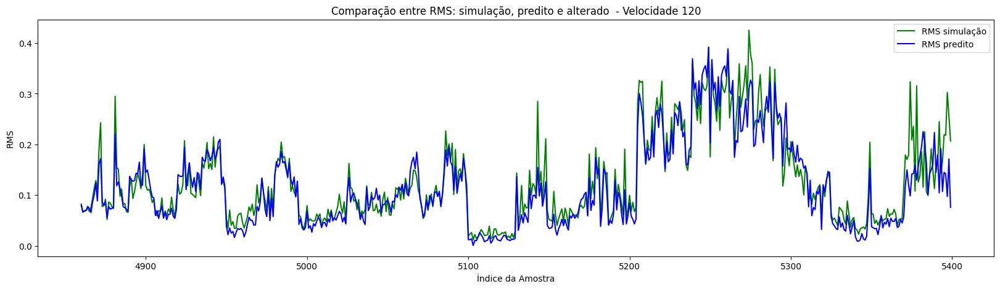

In [ ]:
intervalo_total = 5400

num_subdivisoes = 10

tamanho_subdivisao = intervalo_total // num_subdivisoes

for i in range(num_subdivisoes):
    plt.figure(figsize=(20, 5))

    velocidade = 30 + i * 10

    inicio = i * tamanho_subdivisao
    fim = (i + 1) * tamanho_subdivisao

    plt.plot(range(inicio, fim), y_C_HB[inicio:fim], label='RMS simulação', color='green')
    plt.plot(range(inicio, fim), y_pred_C_HB[inicio:fim], label='RMS predito', color='blue')
    plt.legend()
    plt.xlabel('Índice da Amostra')
    plt.ylabel('RMS')
    plt.title(f'Comparação entre RMS: simulação, predito e alterado  - Velocidade {velocidade}')
    plt.show()
    print('\n')

### D-SDN

In [21]:
y_D_SDN = df_D_SDN.iloc[:, 0]

X_D_SDN = df_D_SDN.iloc[:, 1:12]

y_pred_D_SDN = modelo.predict(X_D_SDN)

169/169 [==============================] - 0s 3ms/step


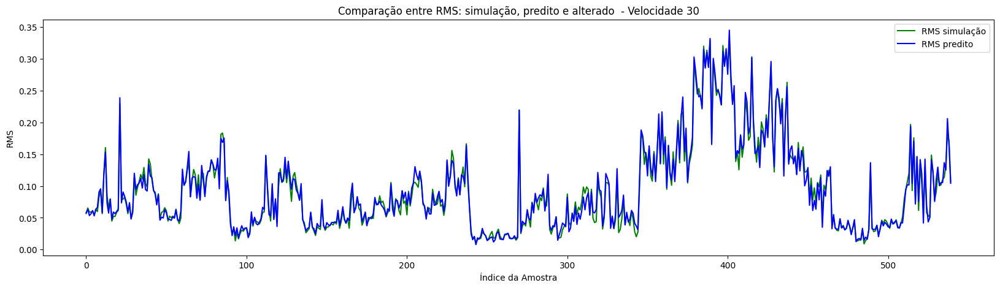

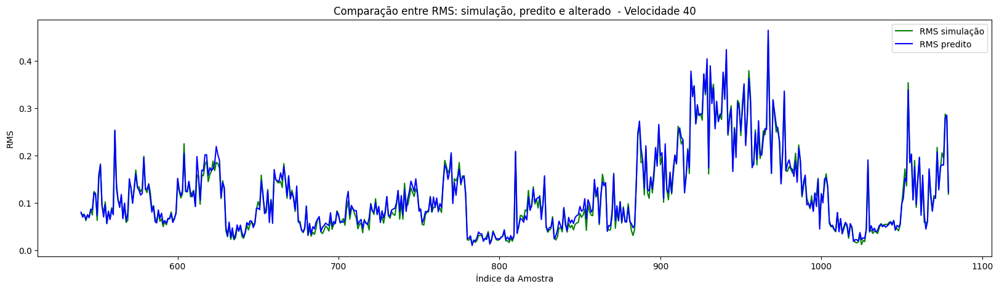

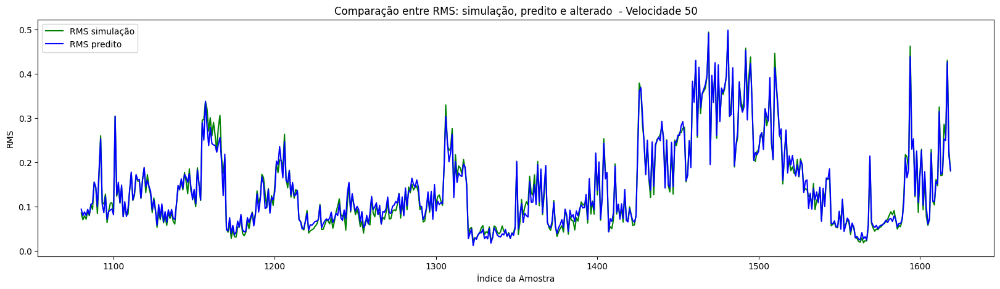

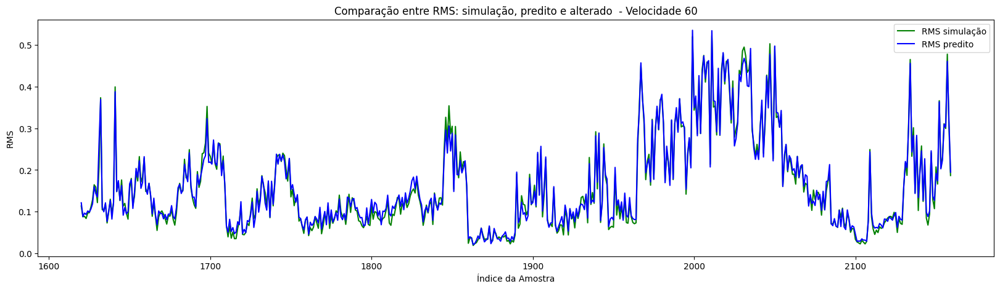

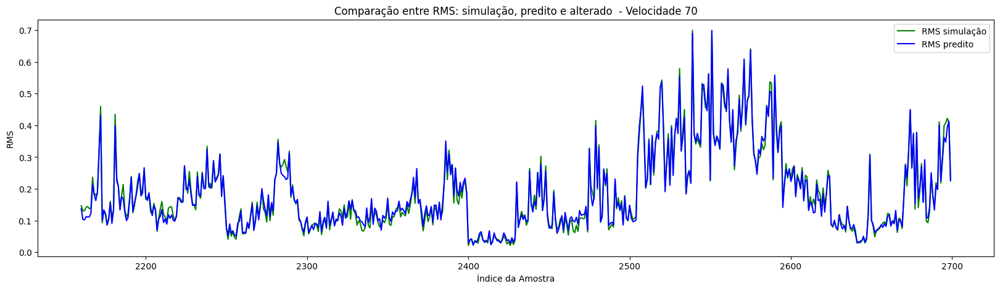

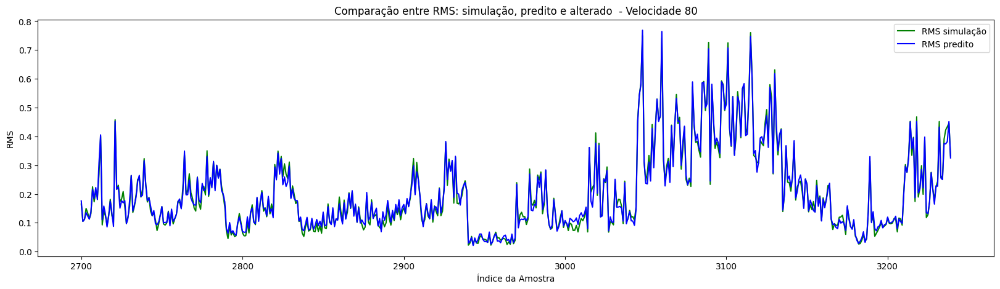

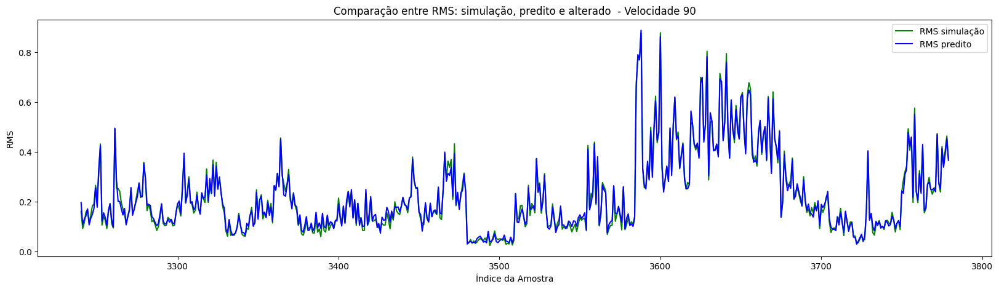

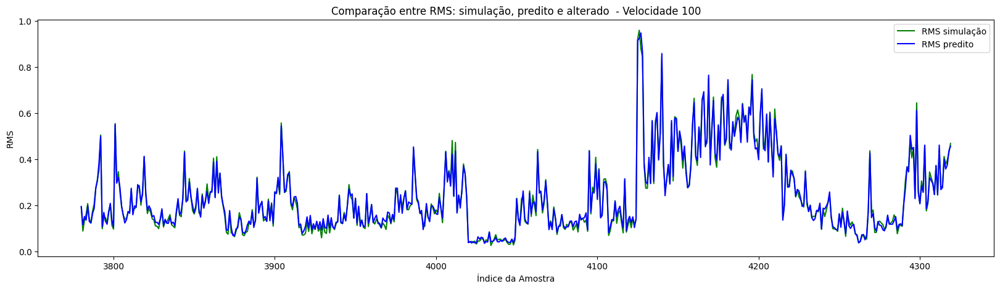

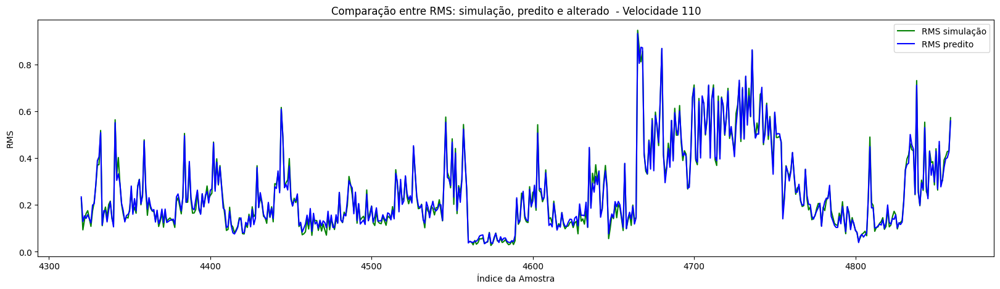

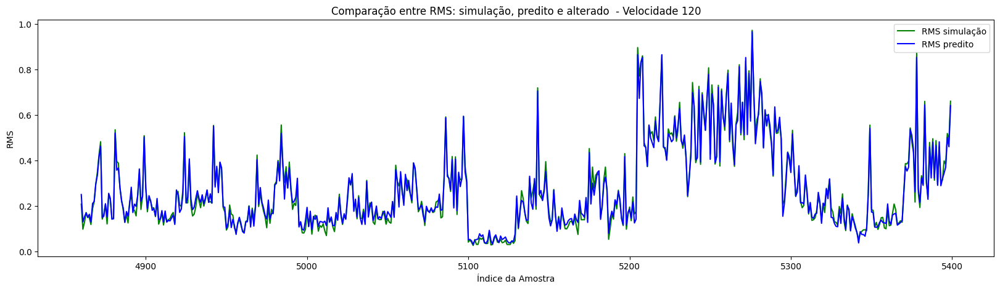

In [22]:
intervalo_total = 5400

num_subdivisoes = 10

tamanho_subdivisao = intervalo_total // num_subdivisoes

for i in range(num_subdivisoes):
    plt.figure(figsize=(20, 5))

    velocidade = 30 + i * 10

    inicio = i * tamanho_subdivisao
    fim = (i + 1) * tamanho_subdivisao

    plt.plot(range(inicio, fim), y_D_SDN[inicio:fim], label='RMS simulação', color='green')
    plt.plot(range(inicio, fim), y_pred_D_SDN[inicio:fim], label='RMS predito', color='blue')
    plt.legend()
    plt.xlabel('Índice da Amostra')
    plt.ylabel('RMS')
    plt.title(f'Comparação entre RMS: simulação, predito e alterado  - Velocidade {velocidade}')
    plt.show()
    print('\n')

### F-SDN

#SHAP

In [ ]:
# Crie um masker para a RNA
masker = shap.maskers.Independent(data=X)

# Crie um explainer para a RNA com o masker
explainer_rna = shap.ExactExplainer(modelo, masker=masker)

# Obtenha os valores SHAP para um conjunto de teste diretamente do explainer
shap_values_rna = explainer_rna(X)

AttributeError: Exception encountered when calling layer 'sequential_4' (type Sequential).

'tuple' object has no attribute 'rank'

Call arguments received by layer 'sequential_4' (type Sequential):
  • inputs=            IRI         V         k         c        ms       mus       kus
0      0.242190  1.000000  0.635643  0.713457  0.490579  0.504705  0.566038
1      0.204573  1.000000  0.638287  0.411950  0.269139  0.306587  0.566038
2      0.472282  1.000000  0.159704  0.713457  0.702274  0.405646  0.566038
3      0.551517  1.000000  0.096245  0.411950  0.318408  0.306587  0.566038
4      0.012447  0.777778  0.635643  0.713457  0.490579  0.504705  0.566038
...         ...       ...       ...       ...       ...       ...       ...
12795  0.175070  0.555556  0.090957  0.411950  0.406659  0.415552  0.553459
12796  0.175070  0.333333  0.638287  0.411950  0.269139  0.306587  0.566038
12797  0.175070  0.555556  0.387097  0.411950  0.703898  0.702823  0.566038
12798  0.175070  0.555556  0.096245  0.411950  0.318408  0.306587  0.566038
12799  0.175070  0.444444  0.096245  0.411950  0.318408  0.306587  0.566038

[11590 rows x 7 columns]
  • training=None
  • mask=None

['IRI', 'V', 'k', 'c', 'ms', 'mus', 'kus']


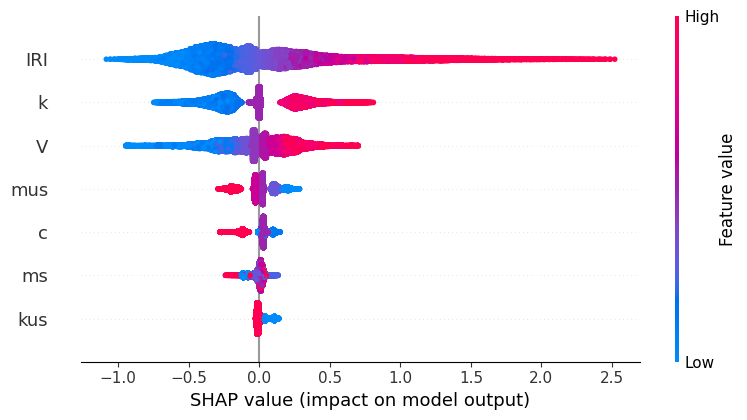

In [ ]:
nomes_primeiras_colunas = df.columns[1:8].tolist()
print(nomes_primeiras_colunas)

shap.summary_plot(shap_values_rna, X, feature_names=nomes_primeiras_colunas)